In [1]:
import sys
paths = "/home/ias627/tools/itk:/home/ias627/projects/massive_halos:/home/ias627/tools/cooling_flow:/home/ias627/tools/FIRE_studio:/home/ias627/tools/iht"
for p in paths.split(':'): sys.path.append(p)

# Imports

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from joblib import Parallel, delayed
from pyevtk.hl import pointsToVTK
import smplotlib
from scripts.halo_analysis_scripts import *
from firestudio.studios.gas_studio import GasStudio
from firestudio.studios.star_studio import StarStudio
import utilities.coordinate as utc
import iht
from glob import glob
import re
from natsort import natsorted

In [3]:
%matplotlib inline
from matplotlib.patches import Annulus
plt.rcParams['figure.dpi'] = 110
from astropy import units as un, constants as cons
plt.rcParams.update({'font.size': 15})
from scipy.stats import binned_statistic

In [4]:
from scripts.particle_tracking import load, selectparticles_zach, trackparticles, process_sim

In [5]:
from pyevtk.hl import pointsToVTK

# Load data

In [ ]:
p_142, rot_142 = load(142, rot=None)

In [ ]:
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_142) for s in range(95, 143+3))

In [39]:
#z~2.5 
p_142 = load('/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000', 142, rot=None)

In [6]:
#z~0 
p_587 = load('/projects/b1026/isultan/metal_diffusion/m12i_r7100/output', 587, rot=None)

In [ ]:
rot_587 = None
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_587) for s in range(550, 587+4))
# res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_587) for s in range(547, 601))

In [95]:
res2 = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s) for s in list(range(547, 550)) + list(range(587+4, 601)))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  13 | elapsed: 10.0min remaining: 54.9min
[Parallel(n_jobs=-1)]: Done   4 out of  13 | elapsed: 11.3min remaining: 25.4min
[Parallel(n_jobs=-1)]: Done   6 out of  13 | elapsed: 12.5min remaining: 14.6min
[Parallel(n_jobs=-1)]: Done   8 out of  13 | elapsed: 13.9min remaining:  8.7min
[Parallel(n_jobs=-1)]: Done  10 out of  13 | elapsed: 15.3min remaining:  4.6min
[Parallel(n_jobs=-1)]: Done  13 out of  13 | elapsed: 17.3min finished


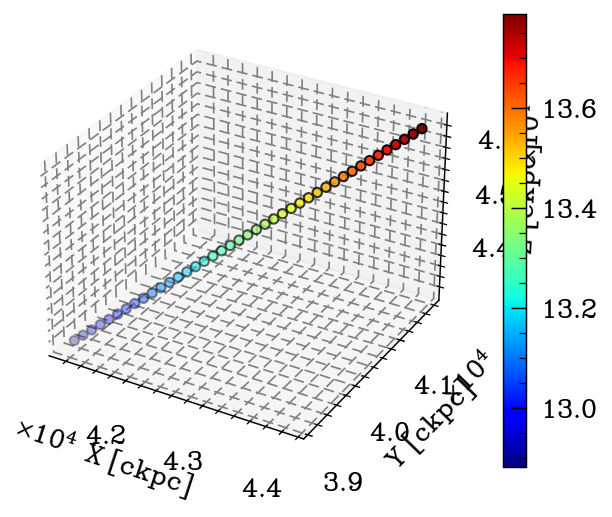

In [55]:
posCall = np.array([p[0]['posC'] for p in res])
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

im = ax.scatter(posCall[:,1], posCall[:,0], posCall[:,2], c=np.array([p[0]['TimeGyr'] for p in res]))

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.colorbar(im)
plt.show()

# Map of halo at $z=2.5$

In [ ]:
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)('/projects/b1026/snapshots/MassiveFIRE/h2_A8_res33000', s) for s in [150,277])
# res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_587) for s in range(547, 601))

In [173]:
def plotviz(ax, p, simname, snapnum, cbar=False, ascale=1, boxsize=None, font_color='w', plotType='T', rotate=False, use_metadata=True, Tmin=4.5, Tmax=7, Smin=-3.5, Smax=1, edgeOn=False):
    p0 = p[0]
    datadir='vizdata'
    outdir='vizimages'
    if boxsize is None: boxsize=p0['Rvir']*2.5
    frame_half_thickness=None
    print(boxsize)

    gaspart = {}
    gaspart['Coordinates'] = p0['Coordinates'] / ascale
    gaspart['Masses'] = p0['Masses'] * 1.e10
    gaspart['Metallicity'] = p0['Metallicity']
    gaspart['SmoothingLength'] = p0['SmoothingLength'] / ascale
    gaspart['BoxSize'] = boxsize
    gaspart['Temperature'] = p0['Temperature']
    gaspart['logT'] = np.log10(p0['Temperature'])
    
    if edgeOn: gaspart['Coordinates'] = gaspart['Coordinates'][:, [2, 1, 0]]
    
    gasStudio = GasStudio(
        datadir=datadir, 
        snapnum=snapnum,
        sim_name=simname,
        gas_snapdict = gaspart,
        frame_half_width = boxsize//2,
        scale_bar=True,
        scale_line_length=100,#max(5, 10*round(boxsize/4/10)),#200,
        figure_label=simname,
        figure_label_side='right',
        fontsize=16,
        font_color=font_color,
        use_colorbar=cbar,
        cbar_logspace=False,
        loud=True)
    
    if plotType=='Sigma': #Surface density map 
        gasStudio.set_ImageParams(cbar_label=r'$\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$')
        gasStudio.render(ax=ax, 
                         weight_name='Masses',
                         min_weight=Smin,
                         max_weight=Smax,
                         weight_adjustment_function= lambda x: np.log10(x/gasStudio.Acell)-6, # Msun/pc^2
                         cmap='magma_r',
                         use_metadata=use_metadata, 
                         load=True)
    elif plotType=='T': #Mass-weighted Temperature map
        if Tmin=='auto':
            idxT = (np.abs(gaspart['Coordinates'][:,0])<(boxsize/2))&(np.abs(gaspart['Coordinates'][:,1])<(boxsize/2))&(np.abs(gaspart['Coordinates'][:,2])<15)
            Tmin, Tmax = np.percentile(gaspart['logT'][idxT], [2,98])
        gasStudio.set_ImageParams(cbar_label=r'$\log (T/\mathrm{K})$')
        gasStudio.render(ax=ax, 
                         weight_name='Masses',
                         quantity_name='logT',
                         min_quantity=Tmin,
                         max_quantity=Tmax,
                         cmap='afmhot_r',
                         use_metadata=use_metadata,
                         loud=True)
    
    print(p0['Rvir'], p0['Redshift'])
    # plt.title(f"z={str(np.around(p0['Redshift'],2)).zfill(2)}, {simname}")

40
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 587
setting sim_name to user value of: m12i_7100
setting scale_bar to user value of: True
setting scale_line_length to user value of: 10
setting figure_label to user value of: m12i_7100
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
projecting 2442134 particles
------------------------------------------
---------------------------------

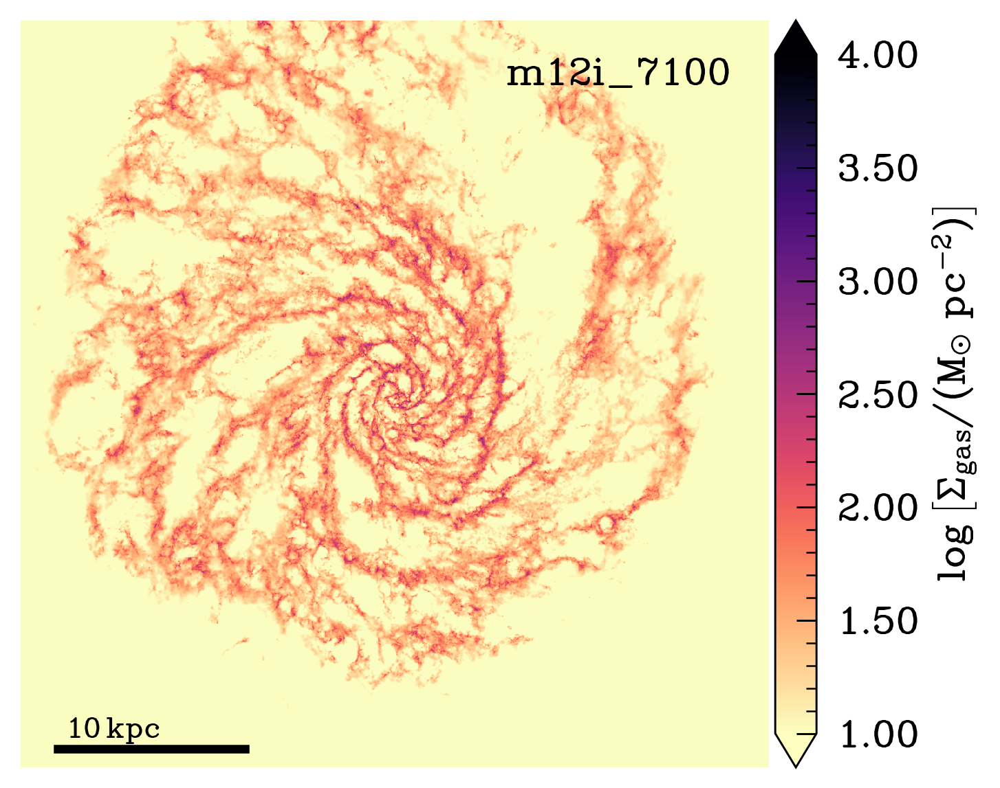

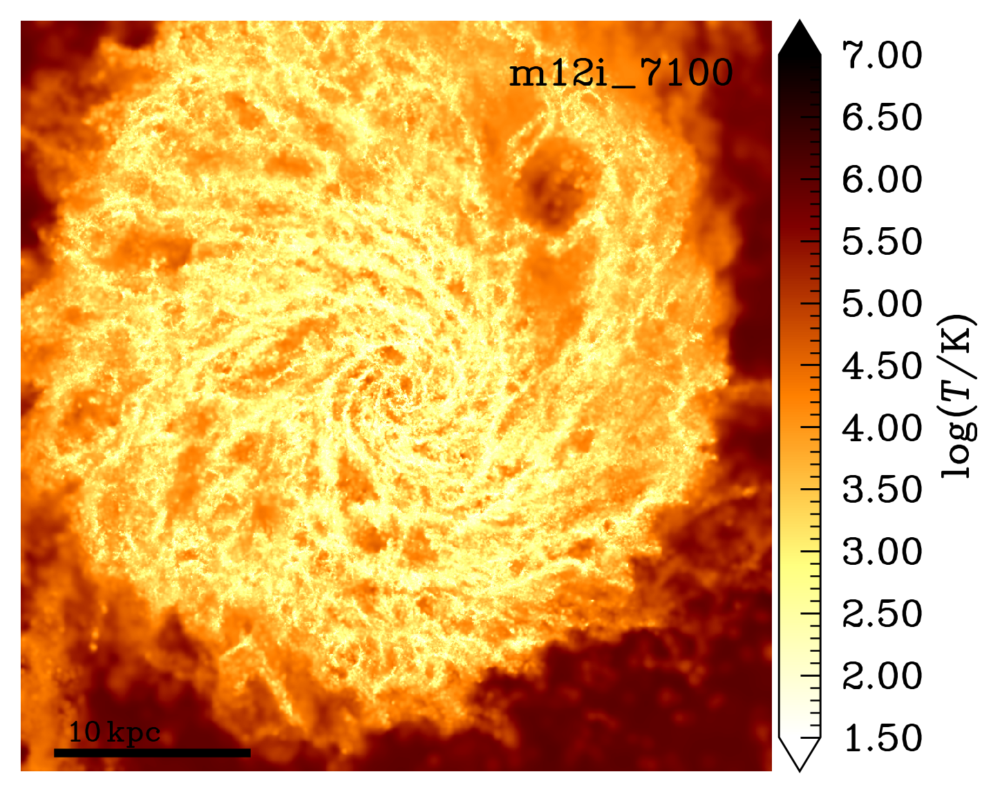

In [93]:
part = p_587
simname = 'm12i_7100'
snapnum = 587

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=40,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
            Tmin=1.5, Tmax=7, Smin=1, Smax=4)
#             Tmin=4.5, Tmax=7, Smin=-1.75, Smax=2.5)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)

20
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 142
setting sim_name to user value of: h206_A1_res33000
setting scale_bar to user value of: True
setting scale_line_length to user value of: 10
setting figure_label to user value of: h206_A1_res33000
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
projecting 540048 particles
------------------------------------------
--------------------

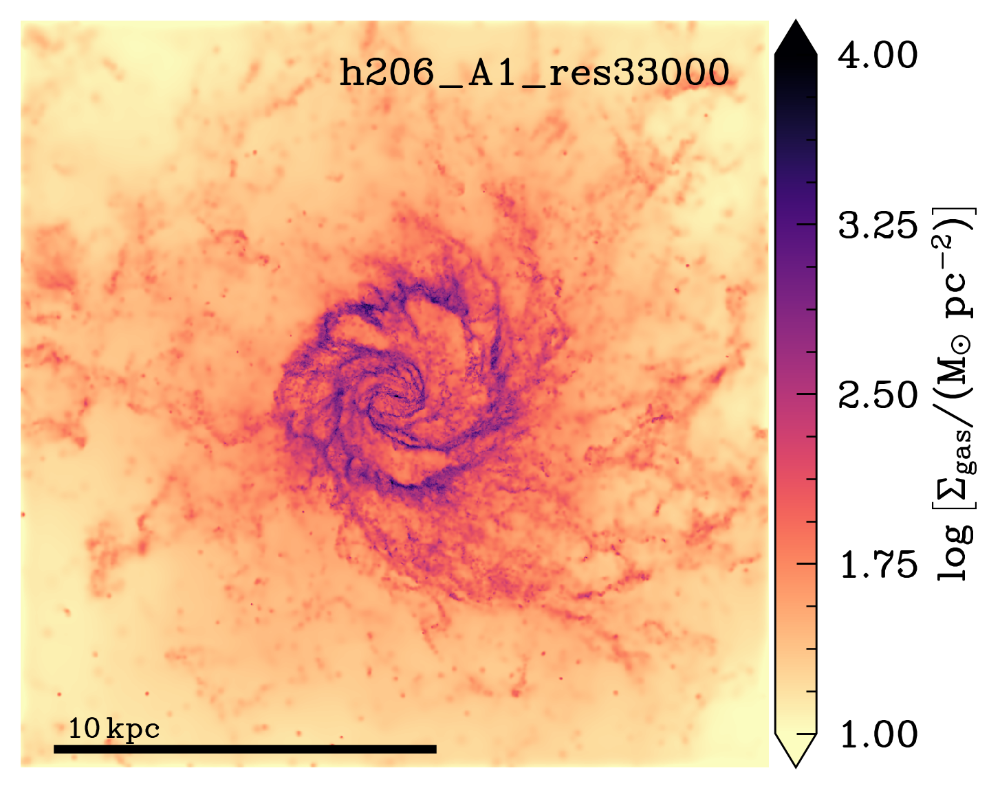

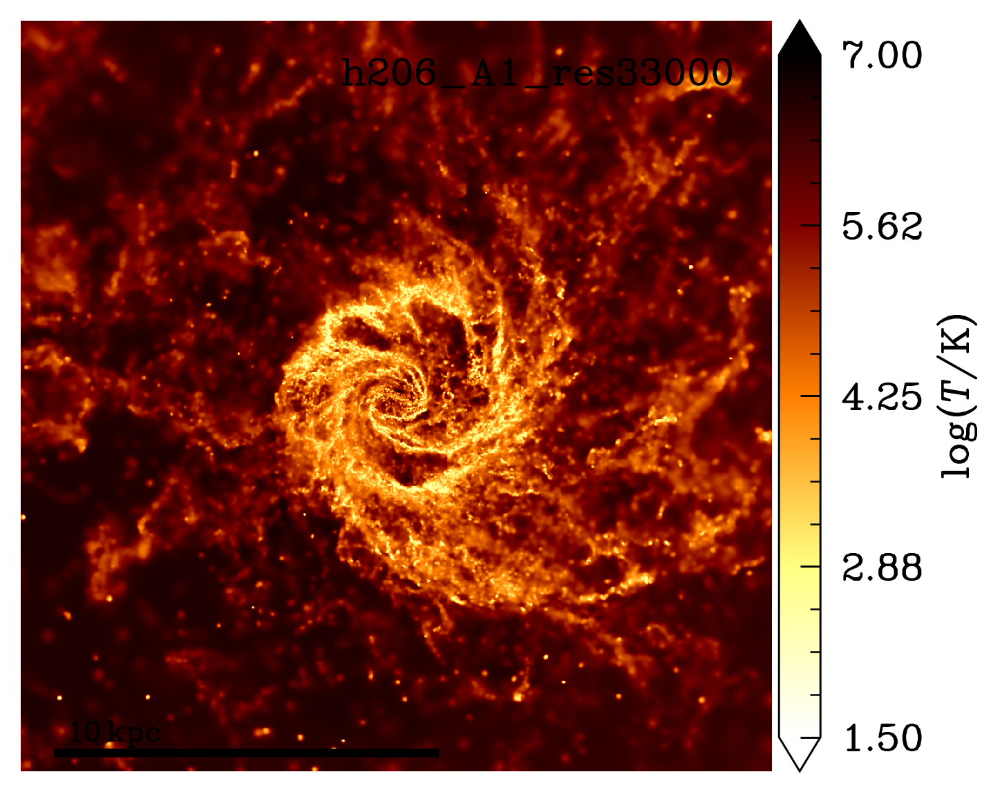

In [29]:
part = res[-1]
simname = 'h206_A1_res33000'
snapnum = 142

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=20,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
            Tmin=1.5, Tmax=7, Smin=1, Smax=4)
#             Tmin=4.5, Tmax=7, Smin=-1.75, Smax=2.5)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)

20
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 142
setting sim_name to user value of: h206_A1_res33000
setting scale_bar to user value of: True
setting scale_line_length to user value of: 10
setting figure_label to user value of: h206_A1_res33000
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
cache npix1200_half_width10.00kpc_zmin0.00kpc_zmax30.00kpc_camera_0.00_0.00_15.00_0.00_0.00

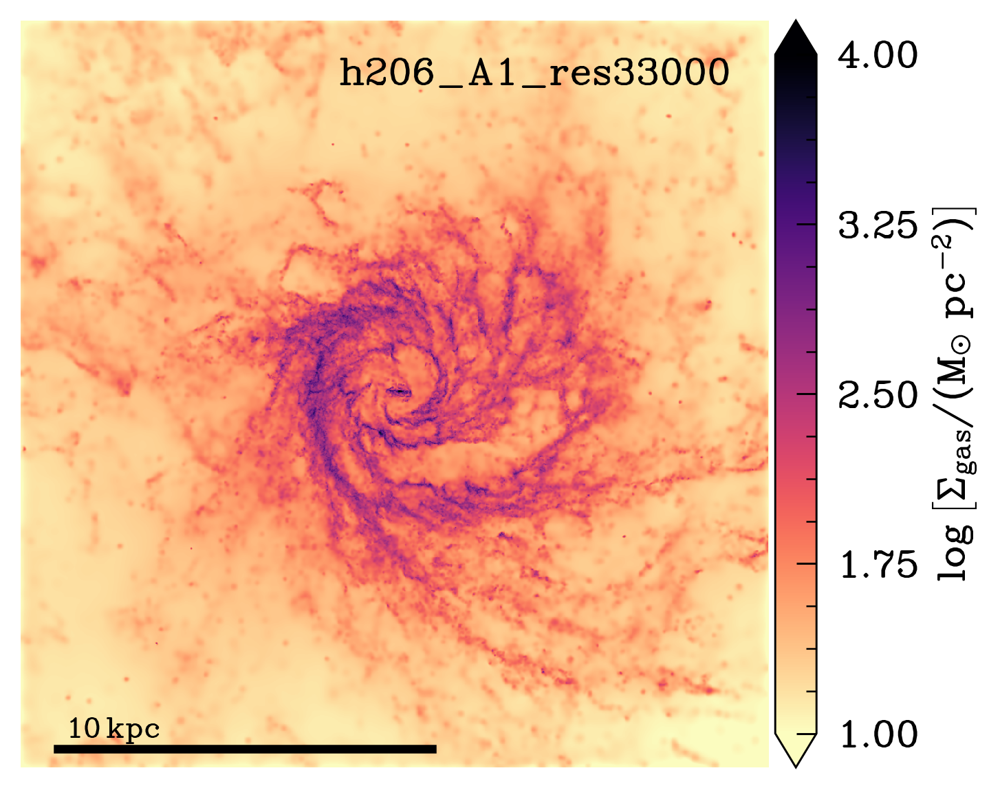

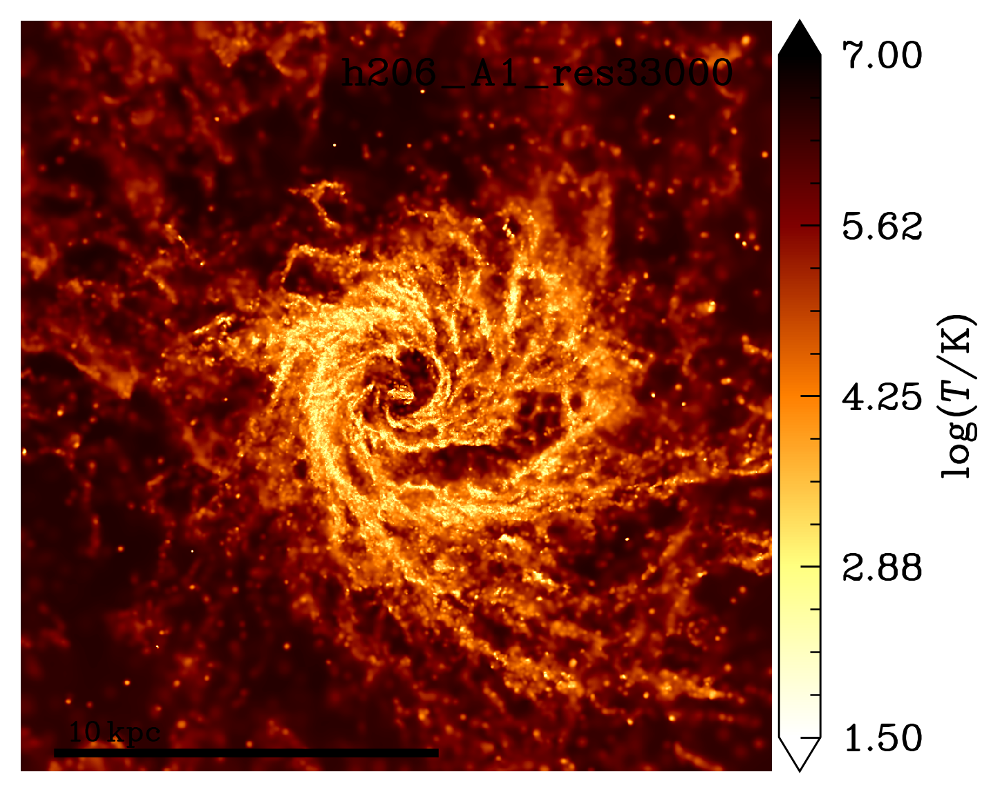

In [61]:
part = res[-1]
simname = 'h206_A1_res33000'
snapnum = 142

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=20,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
            Tmin=1.5, Tmax=7, Smin=1, Smax=4)
#             Tmin=4.5, Tmax=7, Smin=-1.75, Smax=2.5)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)

584.4372058391546
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 212
setting sim_name to user value of: h2_A8_res33000
setting scale_bar to user value of: True
setting scale_line_length to user value of: 100
setting figure_label to user value of: h2_A8_res33000
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
projecting 2773554 particles
------------------------------------------
-------

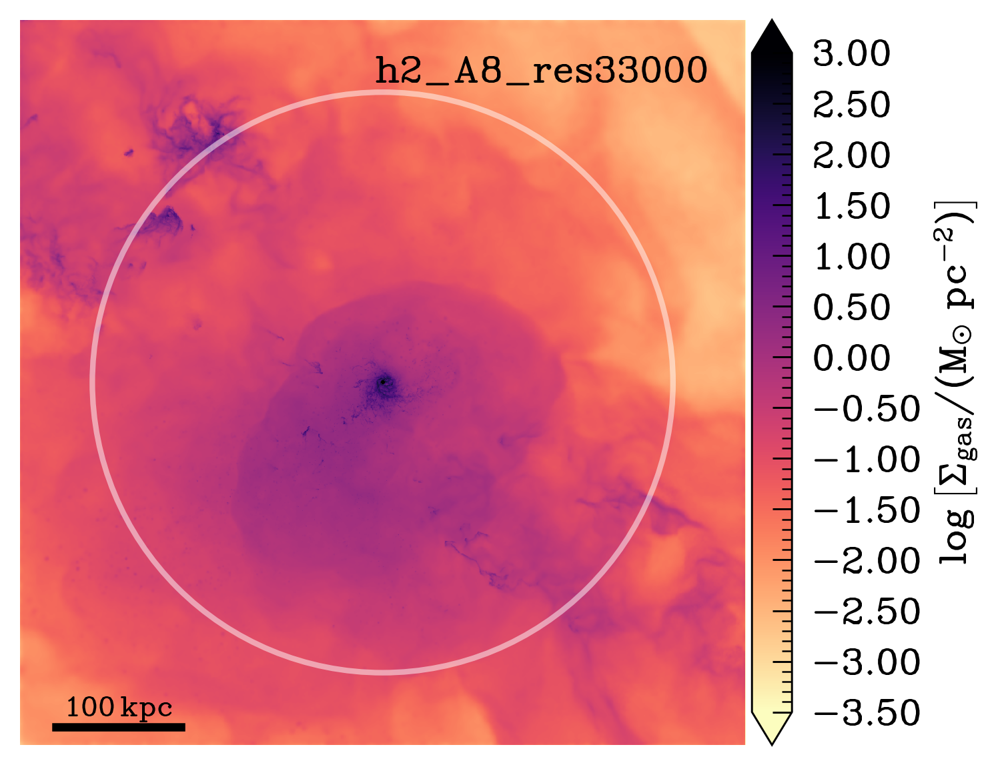

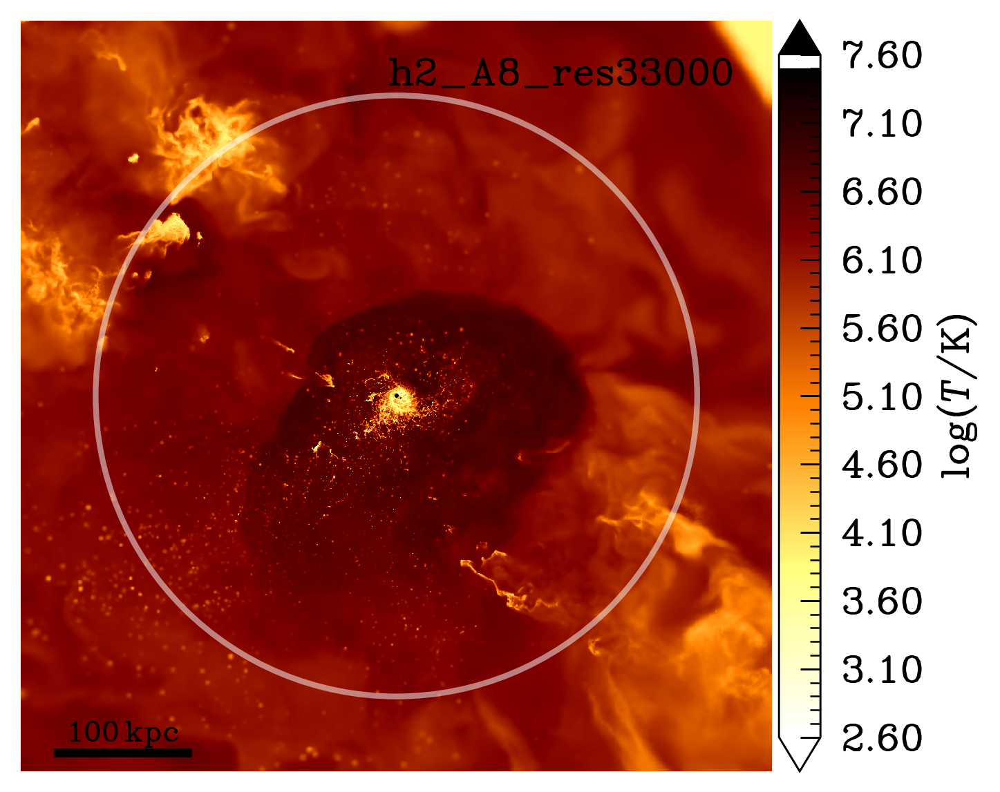

In [175]:
part = res[0]
simname = 'h2_A8_res33000'
snapnum = 212

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=part[0]['Rvir']*2.5,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
#             Tmin=1.5, Tmax=7, Smin=1, Smax=4)
            Tmin=2.6, Tmax=7.5, Smin=-3.5, Smax=3)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)
    ax.plot([0], [0], 'x', ms=1)

# Particle tracking

In [6]:
def percentile2d(X, Y, bins=np.linspace(-0.5, 0.5, 25)):
    X = X.flatten()
    Y = Y.flatten()
    return (bins[:-1]+bins[1:])/2, np.array([np.nanpercentile(Y[inrange(X, (x0, x1))], (16,50,84)) for x0, x1 in zip(bins[:-1], bins[1:])])

In [125]:
def percentile2d(X, Y, bins=np.linspace(-0.5, 0.5, 25)):
    X = X.flatten()
    Y = Y.flatten()
    
    bin_centers = (bins[:-1] + bins[1:]) / 2
    percentiles = []
    
    for x0, x1 in zip(bins[:-1], bins[1:]):
        mask = inrange(X, (x0, x1))  # Select elements within bin range
        values = Y[mask]  # Extract corresponding Y values
        
        if np.isnan(values).all():  
            percentiles.append(np.array([np.nan, np.nan, np.nan]))  # Avoid computing percentiles on all NaN
        else:
            percentiles.append(np.nanpercentile(values, (16, 50, 84)))  # Compute percentiles only on valid data

    return bin_centers, np.array(percentiles)


In [126]:
def sum2d(X, Y, bins=np.linspace(-0.5, 0.5, 25)):
    X = X.flatten()
    Y = Y.flatten()
    return (bins[:-1]+bins[1:])/2, np.array([np.sum(Y[inrange(X, (x0, x1))]) for x0, x1 in zip(bins[:-1], bins[1:])])

In [127]:
def plottracks(res, times0, Rs, Ts, nHs, jaligns, vphis, vcs, tplot):
    times = times0[:, None] - tplot
    
    fig, axes = plt.subplots(3, 2, sharex=True, gridspec_kw={'wspace': .2, 'hspace':.07}, figsize=[4.8*2.5,4.8*1.5], dpi=150, facecolor='w', squeeze=False)

#     axes[0,0].plot(times, Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis], alpha=0.01);
    axes[0,0].set_ylabel('R [pkpc]')
    axes[0,0].axhline(res[-1]['Rvir'], ls='--')
    axes[0,0].axhline(res[-1]['Rvir']*0.1, ls='--')
#     axes[0,0].text(2.4, res[-1-3][0]['Rvir']+5, '$R_{\mathrm{vir}}(t_f)$')
    axes[0,0].set_ylim(0,100)

#     axes[0,1].plot(times, Ts, alpha=0.01);
    axes[0,1].set_ylabel('log T [K]')
#     axes[0,1].set_yscale('log')

#     axes[1,0].plot(times, nHs, alpha=0.01);
    axes[1,0].set_ylabel('$\log\ n_{\mathrm{H}}$ [$\mathrm{cm}^{-3}$]')
#     axes[1,0].set_yscale('log')

#     axes[1,1].plot(times, jaligns, alpha=0.01);
    axes[1,1].set_ylabel(r'$j_z/|\vec{j}|$')
    axes[1,1].set_ylim(-1, 1)
    
    axes[2,0].set_ylabel(r'$v_{\phi}$ [km/s]')
    axes[2,1].set_ylabel(r'$v_{c}$ [km/s]')
    
    for ax, qty in zip(axes.flatten(), [Rs*sfs[:, np.newaxis],
                                        np.log10(Ts),
                                        np.log10(nHs),
                                        jaligns,
                                        vphis,
                                        vcs
                                       ]):
        ax.plot(np.take_along_axis(times, np.argsort(times, axis=0), axis=0), np.take_along_axis(qty, np.argsort(times, axis=0), axis=0), alpha=0.5)
    axes[-1,0].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[-1,1].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[0,0].set_xlim(-0.5, 0.5)
    axes[0,1].set_yticks(np.arange(2, 7, 1))
    axes[1,0].set_yticks(np.arange(-4, 2, 1))

In [128]:
def plottracks2(res, times0, Rs, Ts, nHs, jaligns, js, vphis, vcs, tplot, sfs):
    times = times0[:, None] - tplot
    
    fig, axes = plt.subplots(3, 2, sharex=True, gridspec_kw={'wspace': .2, 'hspace':.09}, figsize=[4.8*2.5,4.8*1.5], dpi=150, facecolor='w', squeeze=False)

#     axes[0,0].plot(times, Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis], alpha=0.01);
    axes[0,0].set_ylabel('R [pkpc]')
    axes[0,0].axhline(res[-1]['Rvir'], ls='--')
    axes[0,0].axhline(res[-1]['Rvir']*0.1, ls='--')
#     axes[0,0].text(2.4, res[-1-3][0]['Rvir']+5, '$R_{\mathrm{vir}}(t_f)$')
    axes[0,0].set_ylim(0,100)

    axes[0,1].set_ylabel('log T [K]')
    axes[0,1].set_ylim(2,7)

#     axes[1,0].plot(times, nHs, alpha=0.01);
    axes[1,0].set_ylabel('$\log\ n_{\mathrm{H}}$ [$\mathrm{cm}^{-3}$]')
    axes[1,0].set_ylim(-4,2)
#     axes[1,0].set_yscale('log')

    axes[1,1].set_ylabel(r'$j_z/|\vec{j}|$')
    axes[1, 1].set_ylim(-1, 1)
    axes[1, 1].axvline(0)
    axes[1, 1].axhline(0, color='grey', lw=1)
    jtot = np.array([sum2d(times, js[:,:,i])[1] for i in range(3)])
    axes[1,1].plot(sum2d(times, js[:,:,0])[0], jtot[2] / np.linalg.norm(jtot, axis=0), '--')
    
    axes[2,0].set_ylabel(r'$v_{\phi}$ [km/s]')
    axes[2,1].set_ylabel(r'$v_{c}$ [km/s]')
    
    for ax, qty in zip(axes.flatten(), [Rs*sfs[:, np.newaxis],
                                        np.log10(Ts),
                                        np.log10(nHs),
                                        jaligns,
                                        vphis,
                                        vcs
                                       ]):
        bins, pt2d = percentile2d(times, qty)
#         valid = [~np.any(np.isnan(i)) for i in pt2d]
#         bins = bins[valid]
#         pt2d = np.array(pt2d[valid])
#         pt2d = np.reshape(np.concatenate(pt2d), (-1,3))
        
        ax.fill_between(bins, pt2d[:,0], pt2d[:,2], alpha=0.1)
        if ax!=axes[1,1]: ax.plot(bins, pt2d[:,1])

    axes[-1,0].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[-1,1].set_xlabel(r'time - $t_{acc}$ [Gyr]')
#     axes[1,0].set_xlabel(r'time - $t_{10^5\ \mathrm{K}}$ [Gyr]')
#     axes[1,1].set_xlabel(r'time - $t_{10^5\ \mathrm{K}}$ [Gyr]')
    
#     axes[0,0].set_xlim(-0.5, 0.5)
    axes[0,1].set_yticks(np.arange(2, 7, 1))
    axes[1,0].set_yticks(np.arange(-4, 2, 1))
    
#     axes[2,1].set_ylim(axes[2,0].get_ylim())
    axes[2,0].set_ylim(-100,600)
    axes[2,1].set_ylim(-100,600)
    axes[2,0].plot(bins, pt2d[:,1], 'k-.')
    
    
    

In [18]:
def plottracks2_vphi(res, times0, vphis, vcs, tplot, ax):
    times = times0[:, None] - tplot
    
    bins, pt2d = percentile2d(times, vphis)
    ax.fill_between(bins, pt2d[:,0], pt2d[:,2], alpha=0.1)
    ax.plot(bins, pt2d[:,1])
    
    bins, pt2d = percentile2d(times, vcs)
    ax.plot(bins, pt2d[:,1], 'k-.', label=r'$v_{c}$')
    
    ax.set_ylim(-100,600)

In [11]:
def plotparticleaccretion(times, tplot, coords, sfs, rgals, zslice_ckpc = 5, fname=None):
    indices = np.where(np.isin(tplot, times), np.searchsorted(times, tplot), -1)
    coords_t5p = (coords[indices, np.arange(coords.shape[1]), :]/sfs[indices][:, np.newaxis])[indices != -1]
    
    plt.figure(dpi=150)
    pmask = np.abs(coords_t5p[:,2]) < zslice_ckpc
    plt.scatter(coords_t5p[pmask,0], coords_t5p[pmask,1], s=1, alpha=0.01)

    circle1 = Annulus((0, 0), rgals_ckpc.max(), rgals_ckpc.max() - rgals_ckpc.min(), color='r', alpha=0.3, ec=None)
    plt.gca().add_patch(circle1)

    plt.gca().set_aspect('equal') 
    
    plt.xlabel('x [ckpc]')
    plt.ylabel('y [ckpc]')
    if fname is not None: plt.savefig(fname)

In [8]:
def plotRdefs(times, res, fname=None):
    plt.figure(dpi=150)
    for rk in ['Rcirc', 'Rcircavg', 'RgalZach']:
        plt.plot(times, np.array([ p[rk] for p in res ]), label=rk)
    plt.legend()
    plt.xlabel('time [Gyr]')
    plt.ylabel('R/Rvir')
    if fname is not None: plt.savefig(fname)

In [ ]:
smask = (p_587[4]['r_scaled'] < 0.1)&pmaskall

from matplotlib.colors import LogNorm
h_mt,xedges,yedges = np.histogram2d(
    coords_all[smask,0],
    coords_all[smask,1],
    bins=120,
    weights=p_587[4]['Masses'][smask])

h_m,xedges,yedges = np.histogram2d(
    coords_all[smask,0],
    coords_all[smask,1],
    bins=120,
    weights=p_587[4]['Masses'][smask])

plt.imshow((h_m).T,norm=LogNorm(vmin=1e-5,vmax=1e2), origin='lower')
plt.gca().set_aspect(1)
plt.colorbar(label='T (K)')

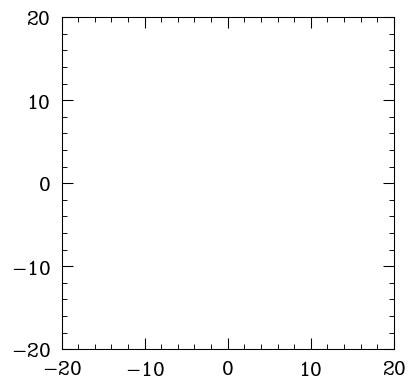

In [90]:
coords_all = p_587[4]['Coordinates'] / p_587[4]['ScaleFactor']
pmaskall = np.abs(coords_all[:,2]) < 1
plt.scatter(coords_all[pmaskall,0], coords_all[pmaskall,1], s=.001, alpha=0.01)
plt.xlim(-20, 20)
plt.ylim(-20, 20)
plt.gca().set_aspect('equal') 

array([27.637455 , 15.166225 , 53.3298   , ...,  5.942499 ,  5.9430466,
        5.943347 ], dtype=float32)

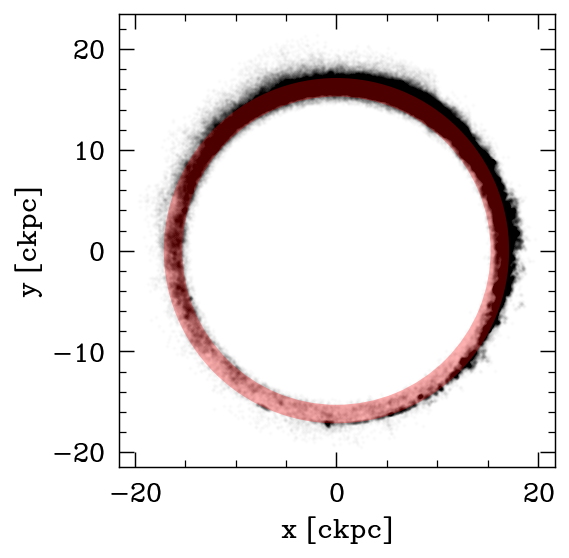

In [11]:
indices = np.where(np.isin(tacc, times), np.searchsorted(times, tacc), -1)
coords_t5p = (coords[indices, np.arange(coords.shape[1]), :]/sfs[indices][:, np.newaxis])[indices != -1]

plt.figure(dpi=150)
pmask = np.abs(coords_t5p[:,2]) < 5
plt.scatter(coords_t5p[pmask,0], coords_t5p[pmask,1], s=1, alpha=0.01)

circle1 = Annulus((0, 0), rgals_ckpc.max(), rgals_ckpc.max() - rgals_ckpc.min(), color='r', alpha=0.3, ec=None)
plt.gca().add_patch(circle1)

plt.gca().set_aspect('equal') 

plt.xlabel('x [ckpc]')
plt.ylabel('y [ckpc]')

coords_all = p_587[4]['Coordinates'] / p_587[4]['ScaleFactor']
pmaskall = np.abs(coords_all[:,2]) < 5
plt.scatter(coords_all[:,0], coords_all[:,1], s=1, alpha=0.01)

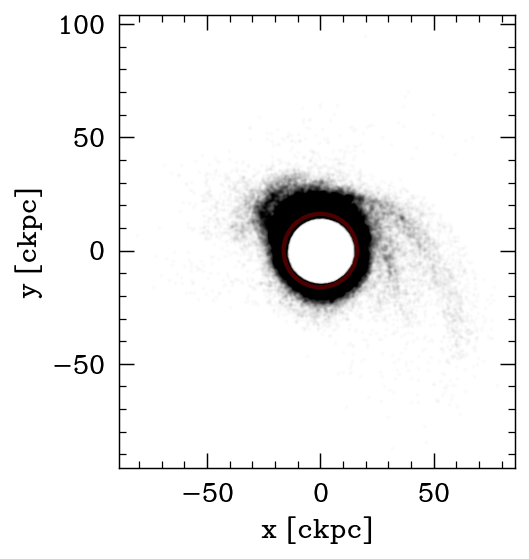

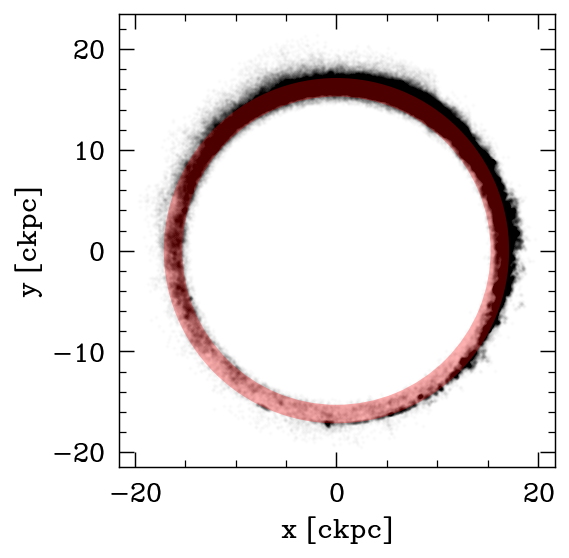

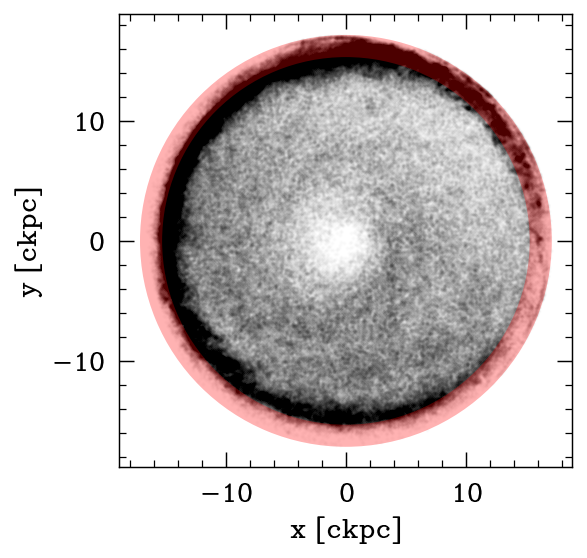

In [37]:
for tplot in [t5, tacc, t5p]:
    plotparticleaccretion(times, tplot, coords, sfs, rgals, 5)

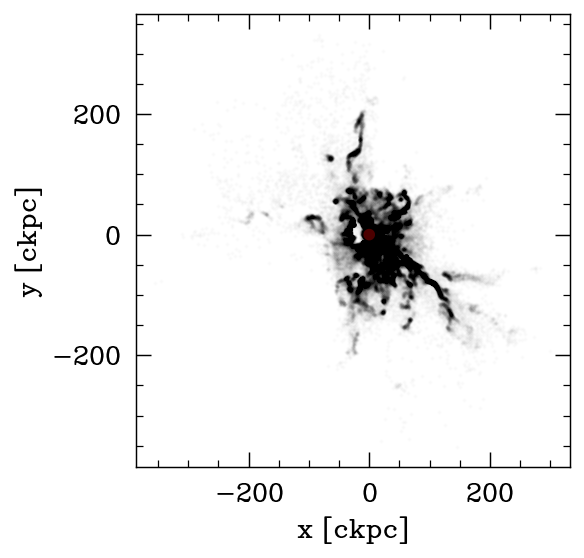

In [15]:
plotparticleaccretion(times, tacc, coords, sfs, rgals)

In [ ]:
cl = 'b' if tratio < 1 else 'r' if tratio > 2 else 'grey'

In [9]:
def plothotphase():
    mask_hotphase = np.array([False if np.isnan(t5p[i]) else np.median( np.log10(Ts[inrange(times - t5p[i], (-0.5, -0.1)), i]) ) > 5 for i in range(Ts.shape[1])])
    # idxearly = np.nanmedian(Ts, axis=0) > 10**5 #inrange(t5, (1.7, 1.71))
    idxearly = mask_hotphase
    plottracks2(res, times, Rs[:,idxearly], Ts[:,idxearly], nHs[:,idxearly], jaligns[:,idxearly], js[:,idxearly,:], t5p[idxearly])
    plt.gcf().suptitle(simname + ' (Temp in halo)')
    plt.gca().text(.05, -.5, f'{Rs[:,idxearly].shape[1]} particles')
    plt.savefig(f'../ptrackfigs/Tempinhalo_{simname}.png')

    H0 = 0.697*100*un.km/un.s/un.Mpc
    H = H0 * iht.Ez(0.2821, 0.7179, 2.50562)

    tff = (0.1/H).to(un.Gyr)

    thalo = t5p - times[0]

    tratio = thalo/tff.value

    mask_hotphase = tratio > 1.2

    idxearly = mask_hotphase
    plottracks2(res, times, Rs[:,idxearly], Ts[:,idxearly], nHs[:,idxearly], jaligns[:,idxearly], js[:,idxearly,:], t5p[idxearly])
    plt.gcf().suptitle(simname+ ' (time in halo)')
    plt.gca().text(.05, -.5, f'{Rs[:,idxearly].shape[1]} particles')
    plt.savefig(f'../ptrackfigs/timeinhalo_{simname}.png')

In [10]:
def idxhotphase():
    H0 = 0.697*100*un.km/un.s/un.Mpc
    H = H0 * iht.Ez(0.2821, 0.7179, 2.50562)

    tff = (0.1/H).to(un.Gyr)

    thalo = t5p - times[0]

    tratio = thalo/tff.value

    mask_hotphase = tratio > 1.2
    
    phase = np.zeros(len(t5p), dtype=np.int)
    
    phase[tratio > 1.2] = 1
    phase[tratio < 1] = -1
    
    return phase

In [14]:
def ptrackseries(xs, ys, zs, sfs, PIDs, phases):
#     maskj = np.full(xs.shape[1], True)
    maskj = np.random.randint(0, xs.shape[1], 1000)

    for t in range(xs.shape[0]):
        pointsToVTK(f'../ptrackseries/{simname}/particles_snapnum{t:02}', xs[t, maskj]/sfs[t], ys[t, maskj]/sfs[t], zs[t, maskj]/sfs[t], 
                    data={
                        'ParticleIDs':PIDs[t, maskj],
                        'phase':phases[maskj]
                    })

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
m12i_r7100
h2_A8_res33000


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

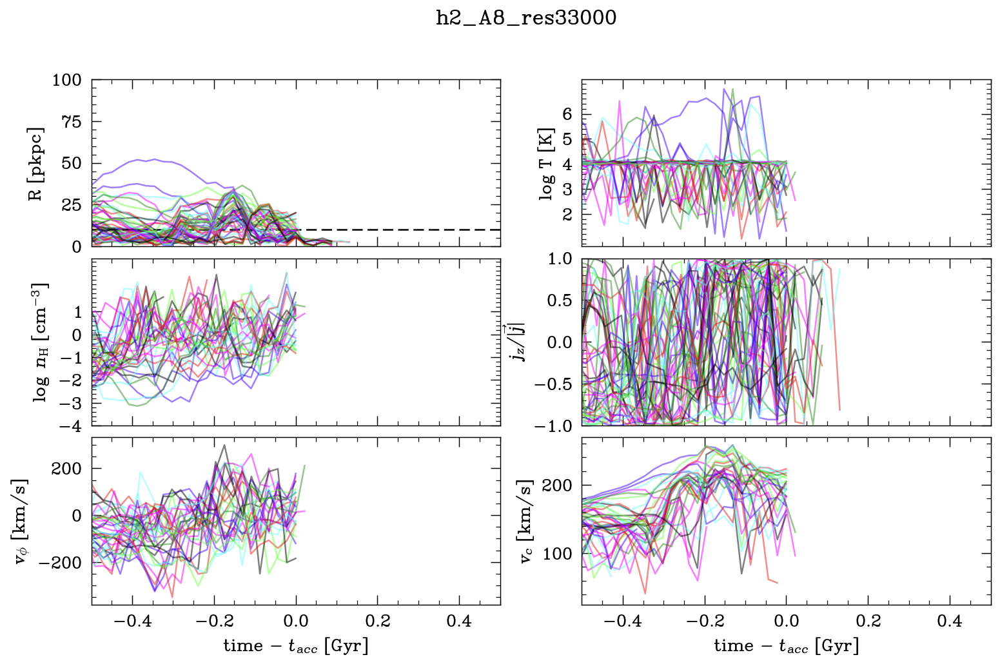

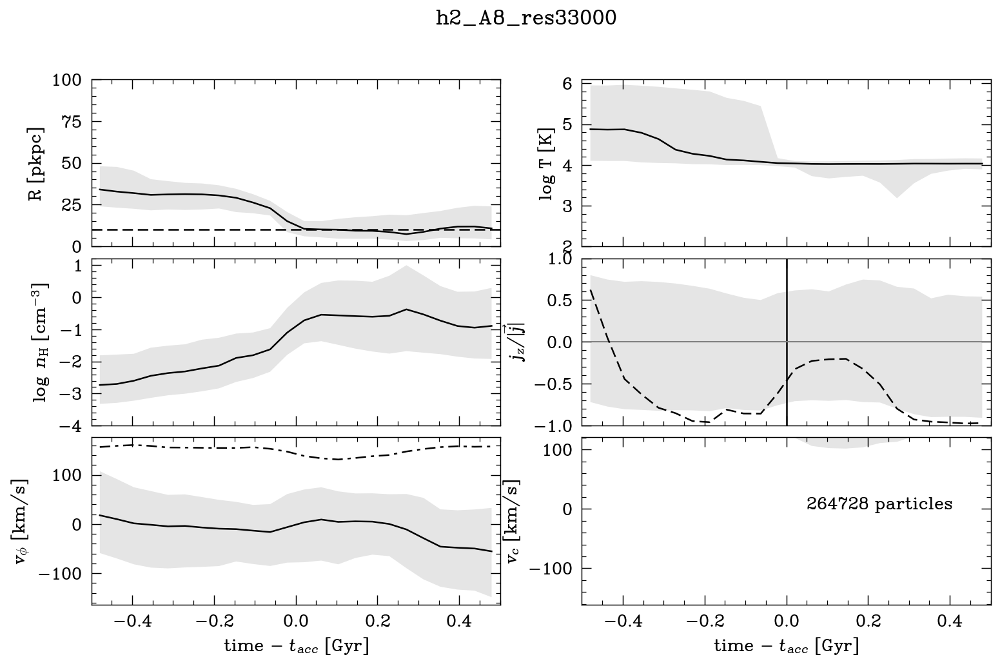

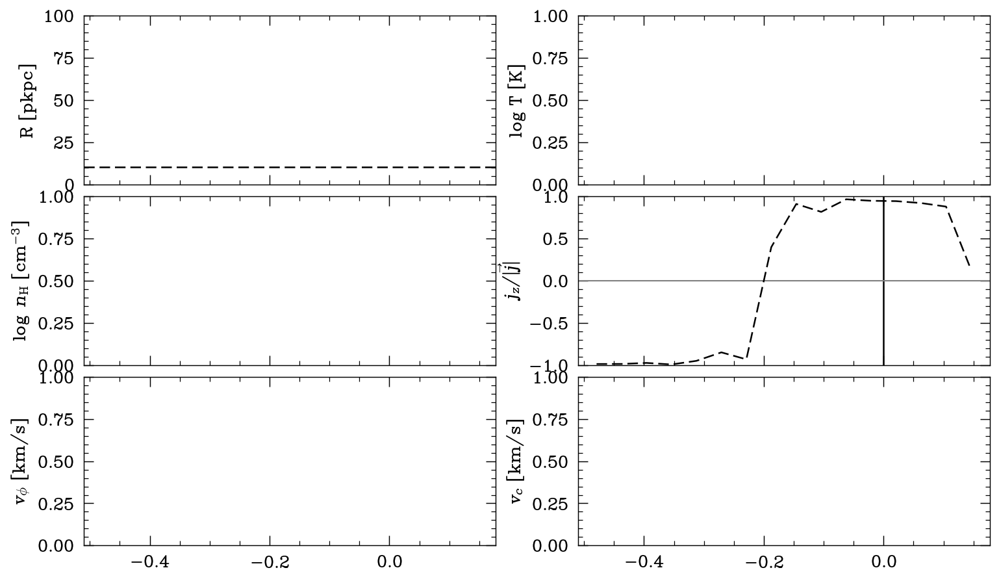

In [86]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'm12i_r7100', 'h2_A8_res33000']
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/rotateLastSnap'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))
for simname in m13s:
    print(simname)
    filestoread = natsorted([f for f in glob(os.path.join(datadir, f'particles_{simname}_*.h5')) if re.match(rf'{datadir}/particles_{simname}_(\d+)\.h5', f)])
    filestoread = filestoread[95-36:] if 'res33000' in simname else filestoread[547-504:] #remove initial 1Gyr, to avoid centering issues
    res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)

    times = np.array([ p['TimeGyr'] for p in res ])
    Rs =    np.array([ p['r_scaled']*p['Rvir']/p['ScaleFactor'] for p in res ])
    Ts =    np.array([ p['Temperature'] for p in res ])
    nHs =   np.array([ p['nH'] for p in res ])
    jaligns=np.array([ p['jalign'] for p in res ])
    
    vphis=np.array([ p['vphi'] for p in res ])
    vcs=np.array([ p['vc'] for p in res ])

    coords= np.array([ p['Coordinates'] for p in res ])#np.array([ p['Coordinates0'] - p['posC'] for p in res ])
    xs =    coords[:,:,0]
    ys =    coords[:,:,1]
    zs =    coords[:,:,2]
    rscaled=np.array([ p['r_scaled'] for p in res ])
    js =    np.array([ p['j'] for p in res ])
    rgals = np.array([ p['Rgal'] for p in res ])
    sfs =   np.array([ p['ScaleFactor'] for p in res ])
    rvirs = np.array([ p['Rvir'] for p in res ])
    rgals_ckpc = rgals * rvirs / sfs
#     if 'ParticleIDs' in res[-1]: PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)
    PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)

    tacc = np.array([ (list(times[rscaled[:,i] > rgals]) or [np.nan])[-1] for i in range(Rs.shape[1]) ])
    t5 = np.array([ (list(times[(Ts[:,i] > 1e5)&(rscaled[:,i] > rgals)]) or [np.nan])[-1] for i in range(Rs.shape[1]) ])
    t5p= np.array([ (list(times[(Ts[:,i] < 1e5)&(rscaled[:,i] < rgals)]) or [np.nan])[0] for i in range(Rs.shape[1]) ])
    tacc_js = np.array([ (list(times[rscaled[:,i] > 0.05]) or [np.nan])[-1] for i in range(Rs.shape[1]) ])
    
    '''
    phases = idxhotphase()
    ptrackseries(xs, ys, zs, sfs, PIDs, phases)

    plotRdefs(times, res, fname=f'../ptrackfigs/Rdefs_{simname}.png')

    ridx = np.random.randint(0, Rs.shape[1], 50)
    plottracks(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], t5p[ridx])
    plt.gcf().suptitle(simname)
    plt.savefig(f'../ptrackfigs/sample_{simname}.png')

    plottracks2(res, times, Rs, Ts, nHs, jaligns, js, t5p)
    plt.gcf().suptitle(simname)
    plt.gca().text(.05, -.5, f'{Rs.shape[1]} particles')
    plt.savefig(f'../ptrackfigs/all_{simname}.png')

    idxearly = inrange(times[-1] - tacc, (0.5, 1))
    plottracks2(res, times, Rs[:,idxearly], Ts[:,idxearly], nHs[:,idxearly], jaligns[:,idxearly], js[:,idxearly,:], t5p[idxearly])
    plt.gcf().suptitle(simname)
    plt.gca().text(.05, -.5, f'{Rs[:,idxearly].shape[1]} particles')
    plt.savefig(f'../ptrackfigs/allearly_{simname}.png')
    
    # Particle hot/cold mode selection
    plothotphase()
    
    for i,tplot in enumerate([t5, tacc, t5p]): plotparticleaccretion(times, tplot, coords, sfs, rgals, fname=f'../ptrackfigs/paccretion_{i}_{simname}.png')
    '''
    
    # New tests for Jonathan
    ridx = np.random.randint(0, Rs.shape[1], 50)
    plottracks(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], vphis[:,ridx], vcs[:,ridx], tacc_js[ridx])
    plt.gcf().suptitle(simname)
    plt.savefig(f'../ptrackfigs/rotateLastSnap/sampletaccjs_{simname}.png')

    plottracks2(res, times, Rs, Ts, nHs, jaligns, js, vphis, vcs, t5p)
    plt.gcf().suptitle(simname)
    plt.gca().text(.05, -.5, f'{Rs.shape[1]} particles')
    plt.savefig(f'../ptrackfigs/rotateLastSnap/allt5p_{simname}.png')
    
    plottracks2(res, times, Rs, Ts, nHs, jaligns, js, vphis, vcs, tacc_js)
    plt.gcf().suptitle(simname)
    plt.gca().text(.05, -.5, f'{Rs.shape[1]} particles')
    plt.savefig(f'../ptrackfigs/rotateLastSnap/alltaccjs_{simname}.png')
    
    plt.close('all')

In [42]:
tacc = np.array([ times[rscaled[:,i] > rgals][-1] for i in range(Rs.shape[1]) ])
t5 = np.array([ (list(times[(Ts[:,i] > 1e5)&(rscaled[:,i] > rgals)]) or [np.nan])[-1] for i in range(Rs.shape[1]) ])
t5p= np.array([ (list(times[(Ts[:,i] < 1e5)&(rscaled[:,i] < rgals)]) or [np.nan])[0] for i in range(Rs.shape[1]) ])

In [257]:
mask_hotphase = np.flatnonzero([np.min( np.log10(Ts[inrange(times - t5p[i], (-.5, 0)), i]) ) > 4.9 for i in range(Ts.shape[1]) if ~np.isnan(t5p[i])])

In [38]:
unique_ids_tf, counts_tf = np.unique(res[-1][0]['ParticleIDs'], return_counts=True)
unique_ids_tf = unique_ids_tf[counts_tf == 1]

In [39]:
maskj = (modes==1)&np.isin(PIDs, unique_ids_tf)&(np.std(jaligns, axis=0) > 0.8)#np.full(xs.shape[1], True)#

for t in range(xs.shape[0]):
    pointsToVTK(f'../ptrackseriesm12bjextremehotmode/particles_snapnum{t:02}', xs[t, maskj], ys[t, maskj], zs[t, maskj], data={'ParticleIDs':PIDs[maskj]})

In [91]:
231159/7000

33.02271428571429

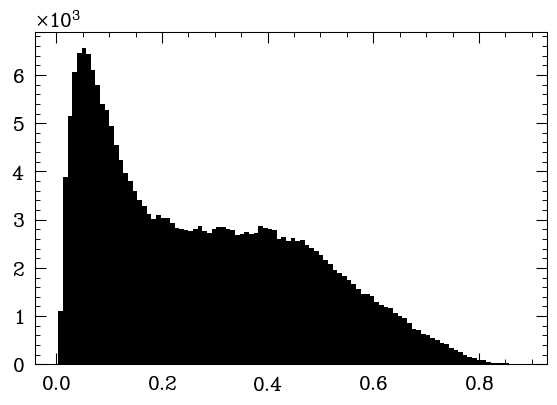

In [70]:
plt.hist(np.std(jaligns, axis=0), bins=100);

In [17]:
def half_mass_radius(radii, masses):
    total_mass = np.sum(masses)
    sorted_indices = np.argsort(radii)
    sorted_radii = radii[sorted_indices]
    cumulative_mass = np.cumsum(masses[sorted_indices])
    
    index = np.searchsorted(cumulative_mass, total_mass / 2.0)
    r1, r2 = sorted_radii[index - 1], sorted_radii[index]
    m1, m2 = cumulative_mass[index - 1], cumulative_mass[index]

    return r1 + (total_mass / 2.0 - m1) * (r2 - r1) / (m2 - m1)

In [18]:
rgals = [4 * half_mass_radius((p[4]['r_scaled'] * p[4]['Rvir'])[p[4]['r_scaled'] <= 0.15], p[4]['Masses'][p[4]['r_scaled'] <= 0.15]) / p[4]['Rvir'] for p in res]

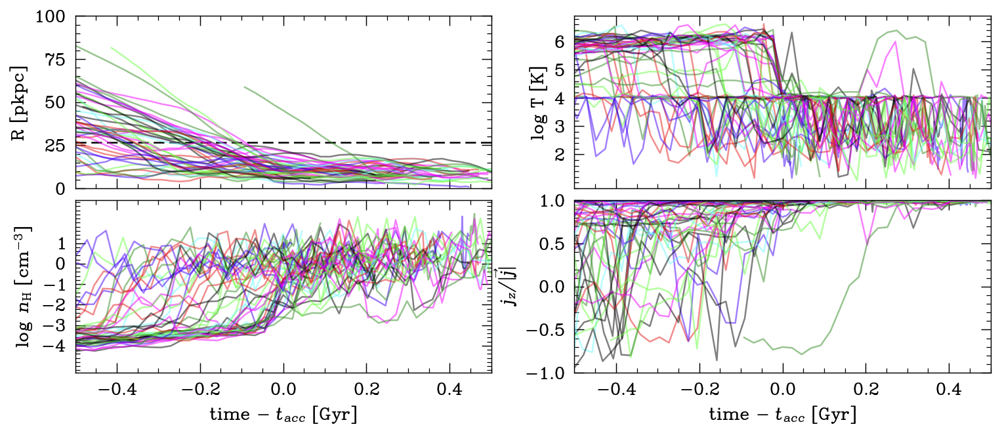

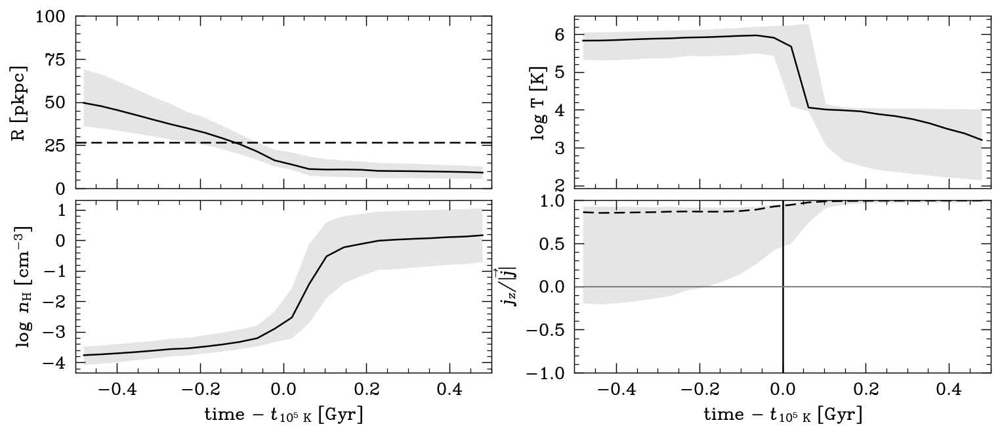

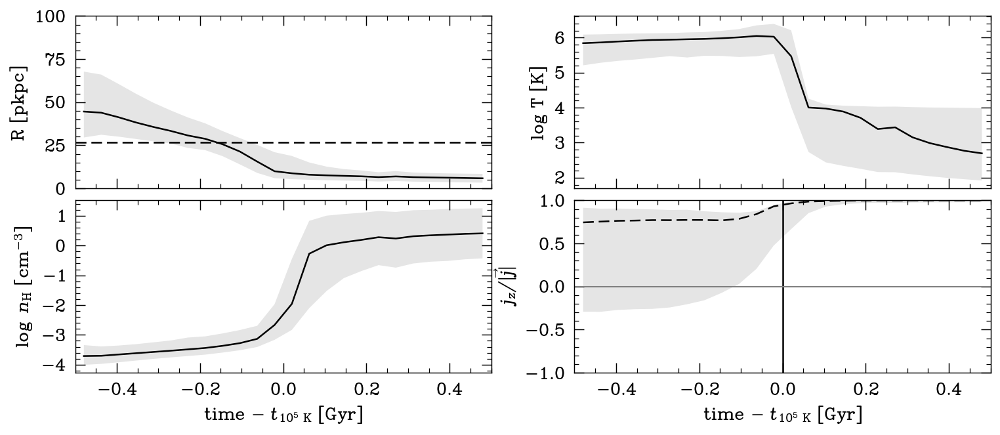

In [45]:
ridx = np.random.randint(0, Rs.shape[1], 50)
# ridx = np.random.choice(mask_hotphase, 50)
# ridx = np.flatnonzero((np.max(np.abs(xs[1:] - xs[:-1]), axis=0) < 1e1)&(np.max(np.abs(ys[1:] - ys[:-1]), axis=0) < 1e1)&(np.max(np.abs(zs[1:] - zs[:-1]), axis=0) < 1e1))
# ridx = np.random.choice(ridx, 30)

# ridx = np.flatnonzero(np.std(jaligns, axis=0) > 0.8)
# ridx = np.random.choice(ridx, 30)

plottracks(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx])

ridx = inrange(times[-1] - tacc, (0.5, 1))
plottracks2(res, times, Rs, Ts, nHs, jaligns, js)
plottracks2(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], js[:,ridx,:])
# plt.savefig('m12i_particletracks3.png')

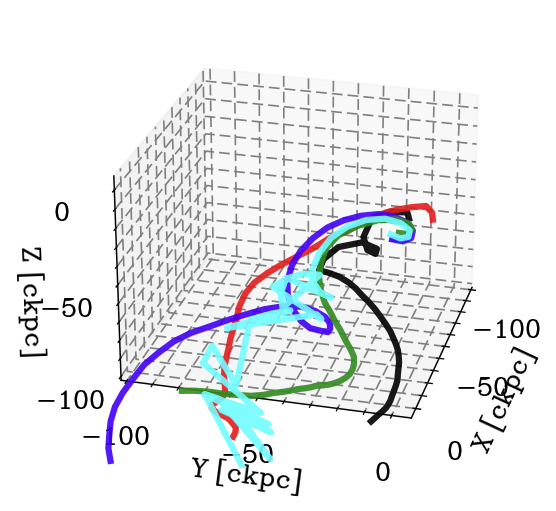

In [64]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in ridx[::6]:
    ax.plot(xs[:,i]-res[-1][0]['posC'][0]/ res[-1][0]['ScaleFactor'], ys[:,i]-res[-1][0]['posC'][1]/ res[-1][0]['ScaleFactor'], zs[:,i]-res[-1][0]['posC'][2]/ res[-1][0]['ScaleFactor'], alpha=0.9, lw=3)


ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

ax.set_xlim(-100, 5)
ax.set_ylim(-100, 5)
ax.set_zlim(-100, 5)

ax.view_init(azim=15, elev=25)
plt.show()

## Hot and cold mode selection

[]

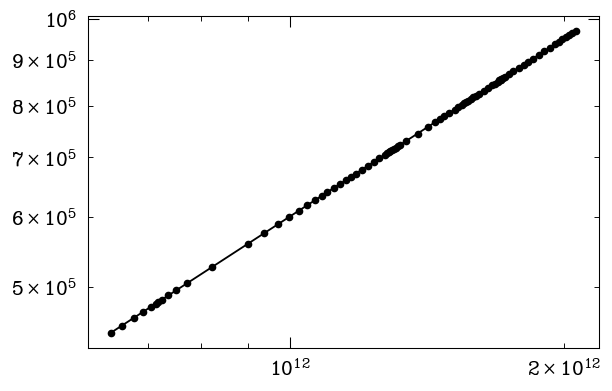

In [33]:
plt.plot([p[0]['Mvir'] for p in res],
         [6e5 * (p[0]['Mvir']/1e12)**(2/3) for p in res], '.-')
plt.loglog()

### Temperature-in-halo selection

In [61]:
ridxchoice = np.random.choice(np.flatnonzero((modes==1)&np.isin(PIDs, unique_ids_tf)&(np.std(jaligns, axis=0) > 0.8)), 50)

In [70]:
def accretionmodes(res, Rs, Ts, Rin=0.1, Rout=1, modefrac=0.8, hotmode=5.5, coldmode=4.5, plot=False):

    if plot: fig, axes = plt.subplots(10, 5, sharex=True, sharey=True, gridspec_kw={'wspace': .05, 'hspace':.07}, figsize=[4.8*5,4.8*10], dpi=150, facecolor='w', squeeze=False)

    a = res[-1-3][0]['ScaleFactor']
    rin, rout = res[-1-3][0]['Rvir']*Rin/a, res[-1-3][0]['Rvir']*Rout/a
    Tvir = 6e5 * (res[-1-3][0]['Mvir']/1e12)**(2/3)

    Tvir0 = 6e5 * (res[0][0]['Mvir']/1e12)**(2/3)
    
    modes = []

    for ip,i in enumerate(ridxchoice):#range(Rs.shape[1]):
    #     mask = iht.inrange(Rs[:,i], (rin,rout))

    #     fcold = np.sum(Ts[mask,i] <= 10**4.5) / np.sum(mask)
    #     fhot = np.sum(Ts[mask,i] >= 10**5.5) / np.sum(mask)

        yb, xb, _ = binned_statistic(Rs[:,i], np.log10(Ts[:,i]), range=(rin, rout), bins=10, statistic='mean')
#         assert(np.isfinite(yb).all())
        xb = (xb[:-1]+xb[1:])/2
        xb = xb[np.isfinite(yb)]
        yb = yb[np.isfinite(yb)]

        fcold = np.sum(yb <= coldmode) / len(yb)
        fhot = np.sum(yb >= hotmode) / len(yb)

        c = 'b' if fcold >= modefrac else 'r' if fhot >= modefrac else 'k'
        
        modes.append(-1 if fcold >= modefrac else 1 if fhot >= modefrac else 0)
        
        if plot:
            ax = axes.flatten()[ip]
            ax.plot(Rs[:,i], Ts[:,i], 'D-', c=c, lw=3);

            ax.axvline(rin, ls='--', lw=2)
            ax.axvline(rout, ls='--', lw=2)

            ax.axhline(Tvir, ls='--', c='g', lw=2)
            ax.axhline(Tvir0, ls='--', c='grey', lw=2)
            ax.axhspan(10**hotmode, 1e7, alpha=0.15, color='r')
            ax.axhspan(1e2, 10**coldmode, alpha=0.15, color='b')

        #     ax.plot(xb, 10**yb, 'o', c='g', lw=3);
    if plot:
        ax.set_yscale('log')
        ax.set_xlim(-10,90)
        ax.set_ylim(1e2,1e7)
        for ax in axes[-1]: ax.set_xlabel('R [com. kpc]')
        for ax in axes[:,0]: ax.set_ylabel('T [K]')
    
    return np.array(modes)

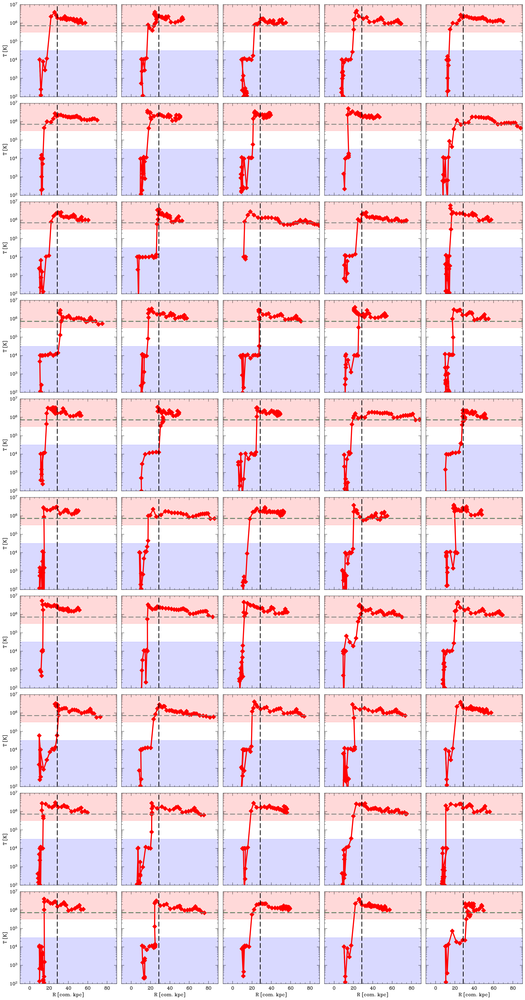

In [74]:
modes1 = accretionmodes(res, Rs, Ts, plot=True, modefrac=0.8)

In [27]:
np.sum(modes==1) / len(modes)

0.6348579879548127

### Time-in-halo selection

In [172]:
H0 = res[-1-3][0]['HubbleParam']*100*un.km/un.s/un.Mpc
H = H0 * iht.Ez(res[-1-3][0]['Omega0'], res[-1-3][0]['OmegaLambda'], res[-1-3][0]['Redshift'])

tff = (0.1/H).to(un.Gyr)

In [173]:
from itertools import groupby
from operator import itemgetter

# https://stackoverflow.com/a/2154437
def consecutiverangesmax(arr):
    ranges =[]

    for k,g in groupby(enumerate(arr),lambda x:x[0]-x[1]):
        group = (map(itemgetter(1),g))
        group = list(map(int,group))
        ranges.append((group[0],group[-1]))
    return ranges[np.argmax([y-x for x,y in ranges])]

In [174]:
def accretionmodes2(res, Rs, times, Rin=0.1, Rout=1, plot=False):

    if plot: fig, axes = plt.subplots(10, 5, sharex=True, sharey=True, gridspec_kw={'wspace': .05, 'hspace':.07}, figsize=[4.8*5,4.8*10], dpi=150, facecolor='w', squeeze=False)

    a = res[-1-3][0]['ScaleFactor']
    rin, rout = res[-1-3][0]['Rvir']*Rin/a, res[-1-3][0]['Rvir']*Rout/a
    
    modes = []

    for i in range(Rs.shape[1]):
        
        mask = inrange(Rs[:,i]/rout, (0.1, 1))
        t0, t1 = consecutiverangesmax(np.flatnonzero(mask))
        
        thalo = times[t1] - times[t0]
        tratio = thalo/tff.value

        cl = 'b' if tratio < 1 else 'r' if tratio > 2 else 'grey'
        
        modes.append(-1 if tratio < 1 else 1 if tratio > 2 else 0)
        
        if plot:
            ax = axes.flatten()[i]
            ax.scatter(times, Rs[:,i], c=np.where(mask, 'g', 'k'));

            ax.axhline(rin, ls='--', lw=2)
            ax.axhline(rout, ls='--', lw=2)
            
            ax.axvspan(times[t0], times[t1], color=cl, alpha=0.25)
            
            ax.text(times[t0], 0.8e3, f'$t_{{halo}}/t_{{ff}}=$\n{tratio:.2f}', size=25)

    if plot:
        for ax in axes[-1]: ax.set_xlabel('time [Gyr]')
        for ax in axes[:,0]: ax.set_ylabel('R [com. kpc]')
    
    return np.array(modes)

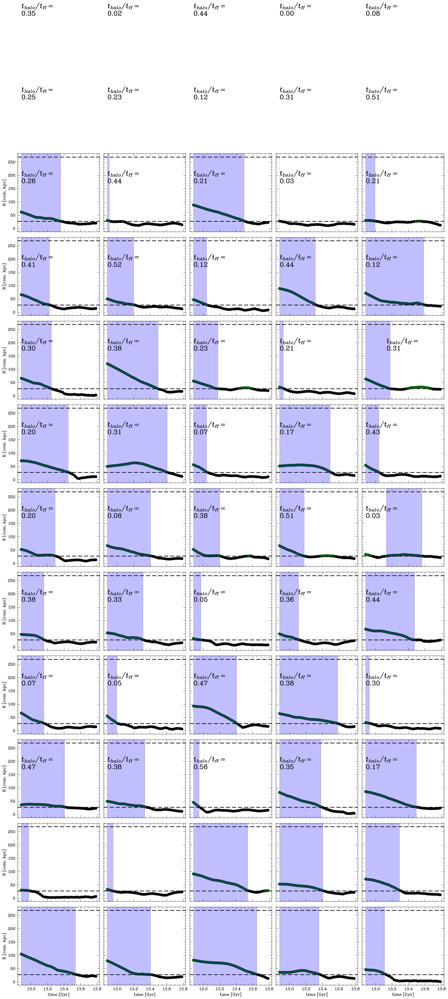

In [175]:
modes = accretionmodes2(res, Rs, times, plot=True)

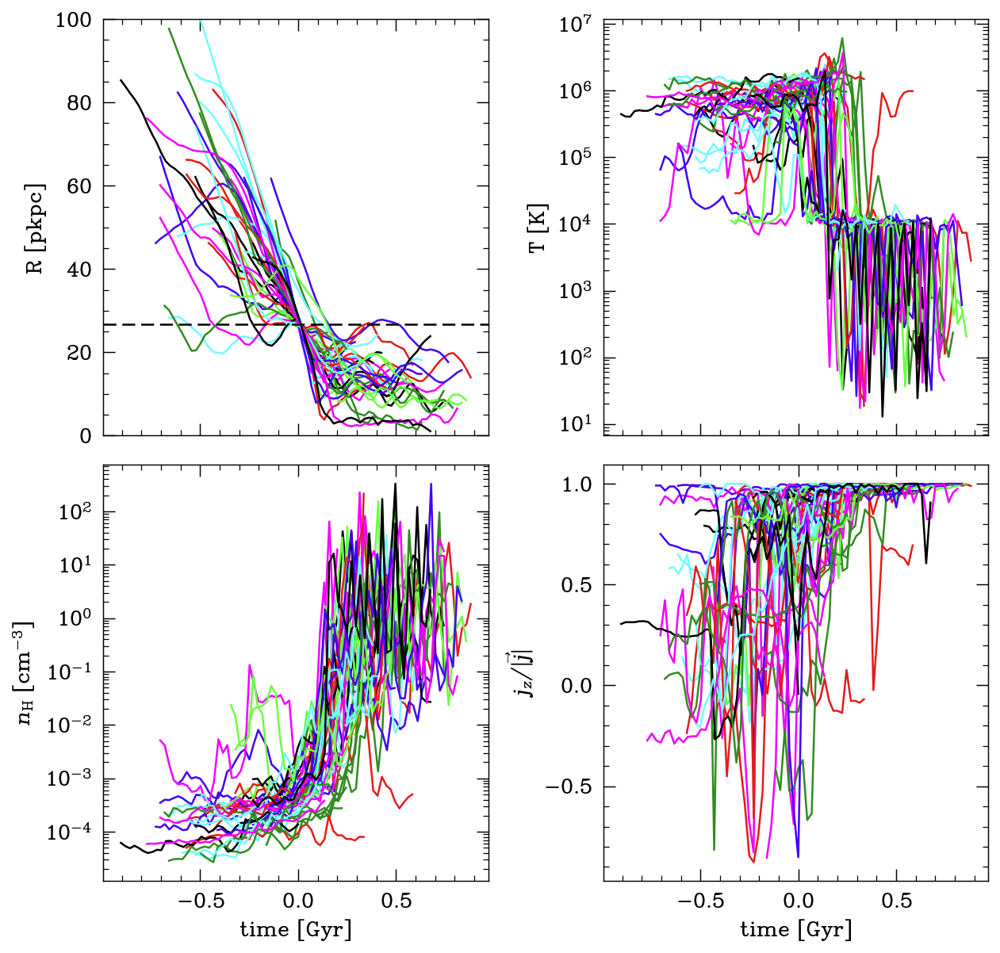

In [178]:
plottracks(res, times, Rs[:,modes==-1], Ts[:,modes==-1], nHs[:,modes==-1], jaligns[:,modes==-1])

In [25]:
print(mpl.rcParams['axes.prop_cycle'])

cycler('color', ['k', '#e31c1c', '#4200f7', '#328b22', '#71fcff', '#f100ff', '#6bff42'])


ValueError: x and y must have same first dimension, but have shapes (0,) and (41, 0)

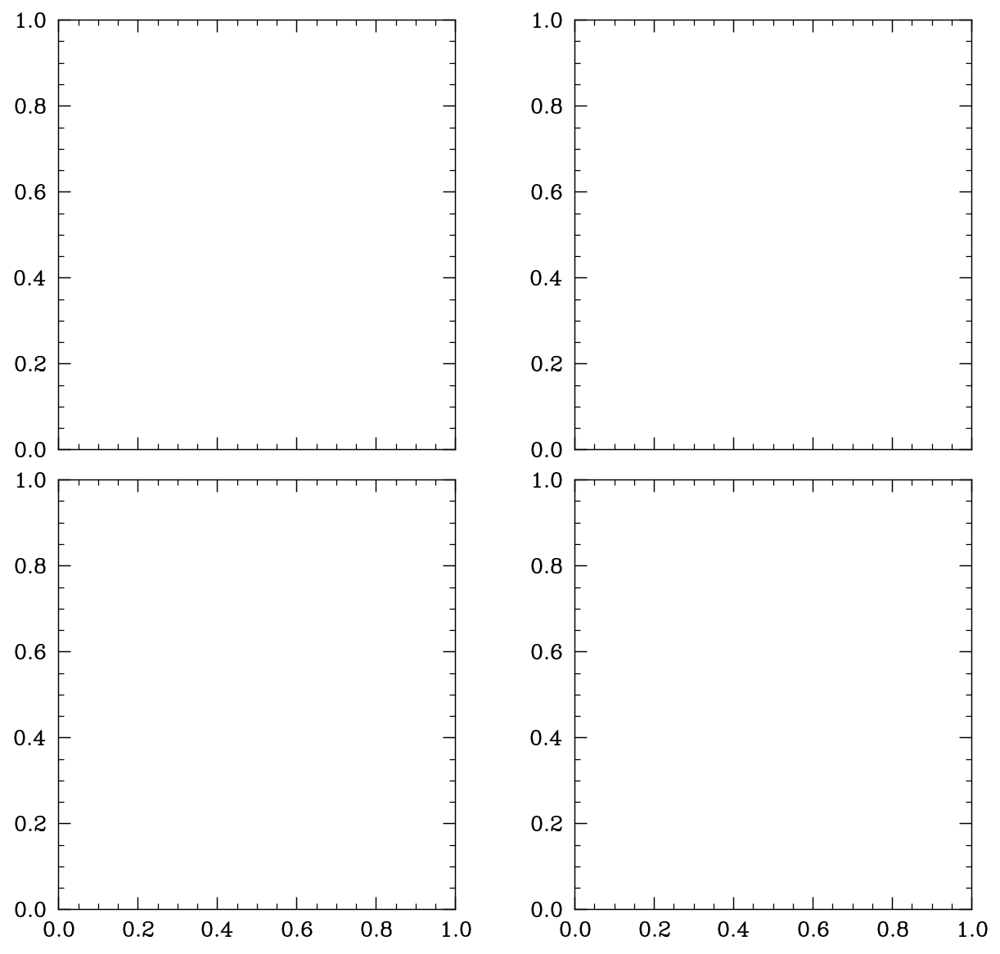

In [177]:
plottracks(res, times, Rs[:,modes==1], Ts[:,modes==1], nHs[:,modes==1], jaligns[:,modes==1])

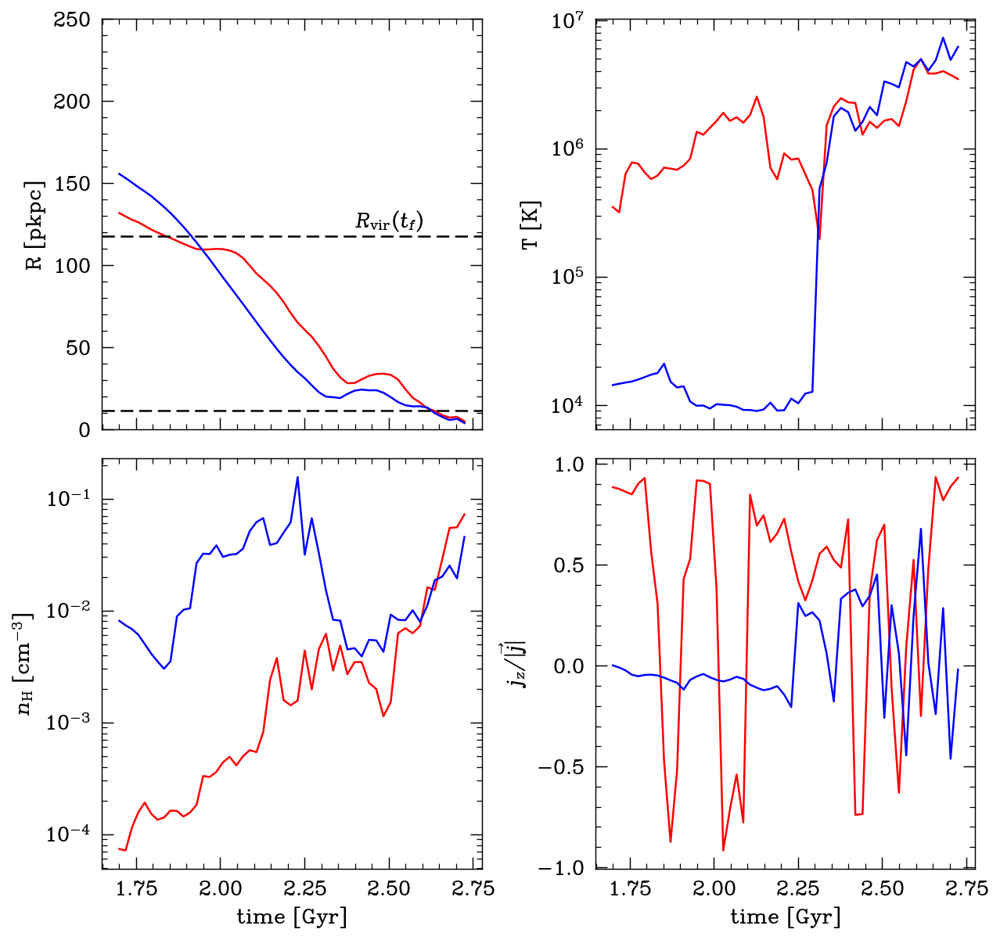

In [42]:
mpl.rcParams['axes.prop_cycle'] = mpl.cycler(color=["r", "b", "k", 'g']) 
plottracks(res, times, Rs[:,[45,47]], Ts[:,[45,47]], nHs[:,[45,47]], jaligns[:,[45,47]])
plt.savefig('exampletracks.png')

# Particle trajectories

Text(0, 0.5, 'y [com. kpc]')

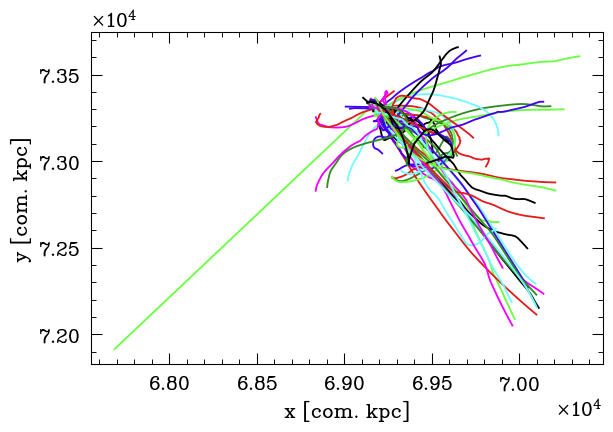

In [91]:
plt.plot(xs, ys);
plt.xlabel('x [com. kpc]')
plt.ylabel('y [com. kpc]')

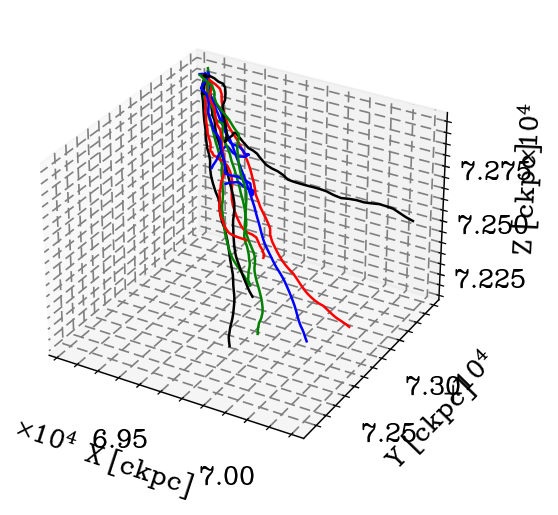

In [43]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in range(50): 
    if modes[i]==1:
        ax.plot(xs[:,i], ys[:,i], zs[:,i])

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

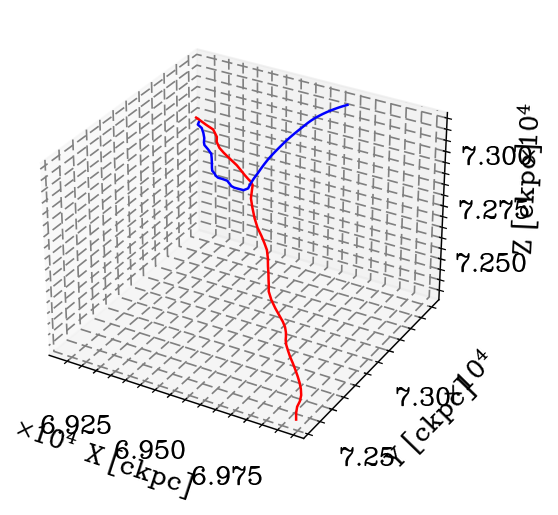

In [45]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in [45,47]: 
    ax.plot(xs[:,i], ys[:,i], zs[:,i])

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

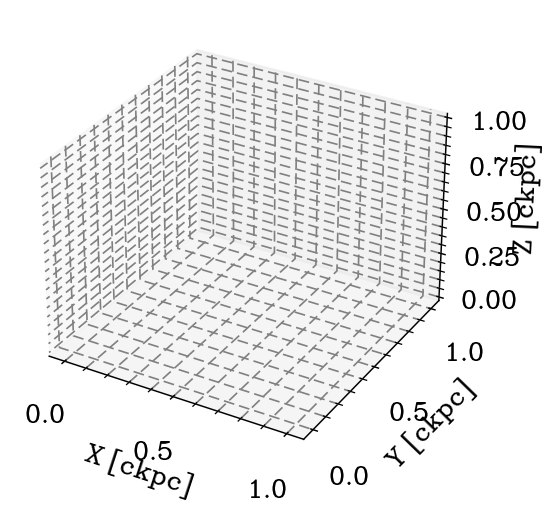

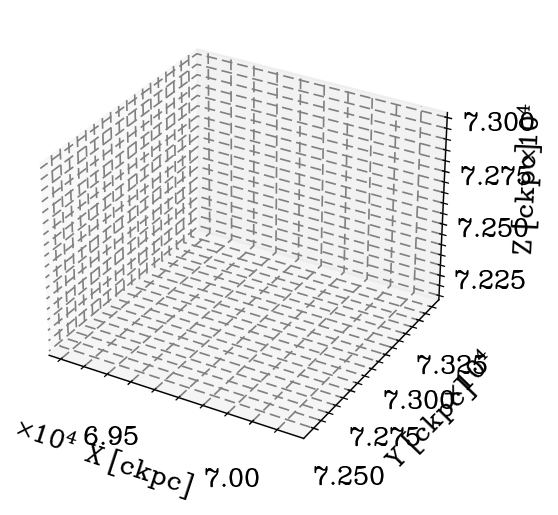

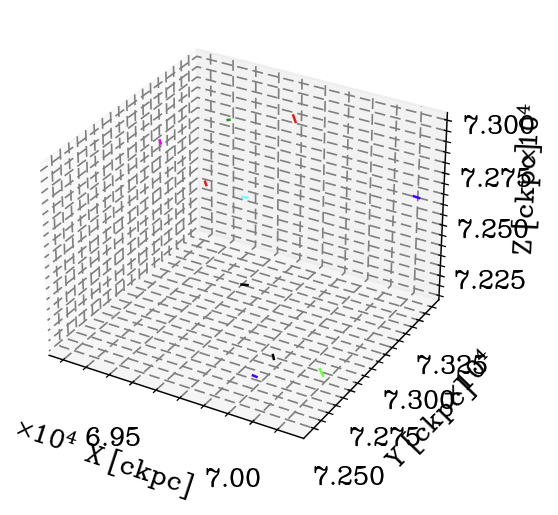

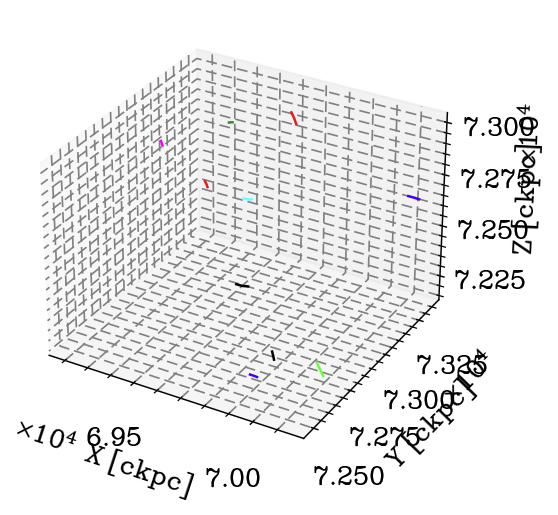

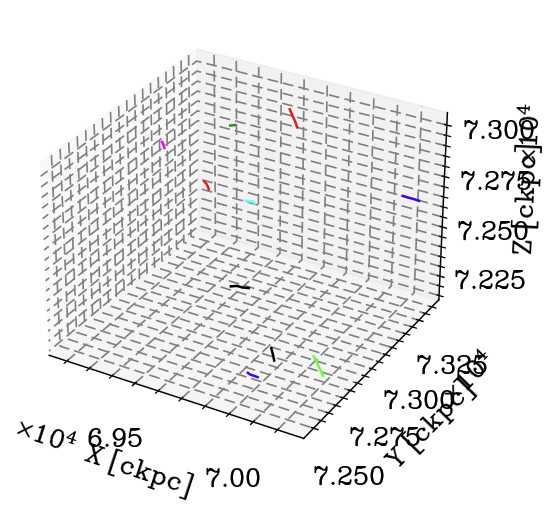

...

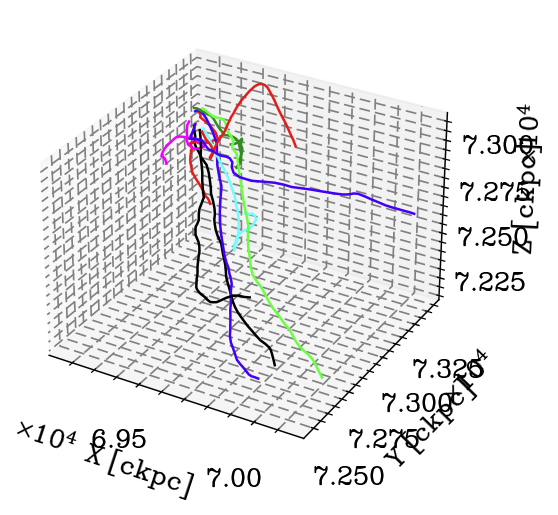

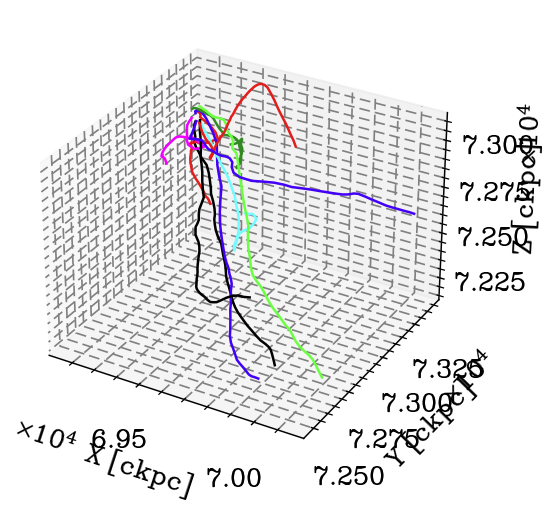

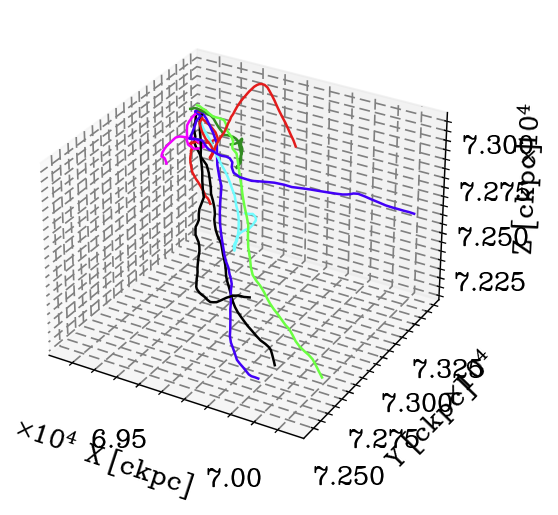

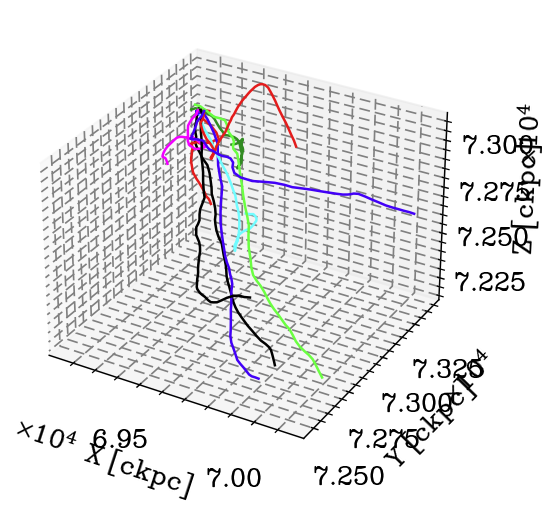

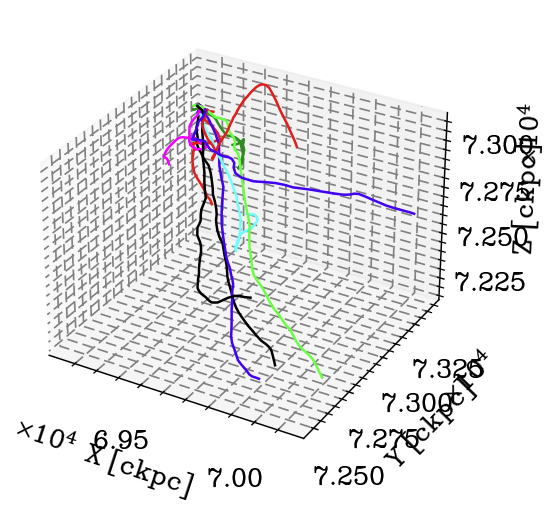

In [77]:
for ti in range(xs.shape[0]):
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    for i in range(50): 
        if modes[i]==1:
            ax.plot(xs[:ti,i], ys[:ti,i], zs[:ti,i])

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')

    plt.savefig(f'tih206/{ti:03d}.png')

In [78]:
from PIL import Image

image_array = [Image.open(f'tih206/{ti:03d}.png') for ti in range(xs.shape[0])]

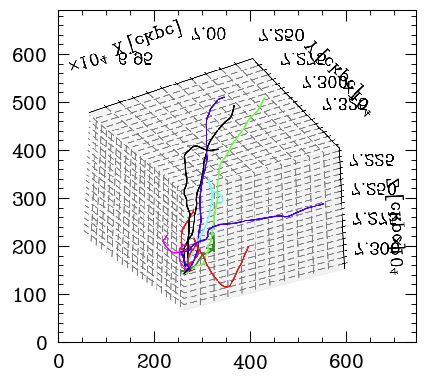

In [79]:
import matplotlib.animation as animation

# Create the figure and axes objects
fig, ax = plt.subplots()

# Set the initial image
im = ax.imshow(image_array[0], animated=True)

def update(i):
    im.set_array(image_array[i])
    return im, 

# Create the animation object
animation_fig = animation.FuncAnimation(fig, update, frames=len(image_array), interval=200, blit=True,repeat_delay=10,)

# Show the animation
# plt.show()

animation_fig.save("tih206/animated_GMM.gif")

# R_gal definition

In [3]:
from scripts.particle_tracking import *

In [4]:
from scripts.analytic_modeling import calculateMr, Potential_FIRE

In [5]:
p_tf, p_ti = Parallel(n_jobs=2, verbose=10)(delayed(load)('/projects/b1026/isultan/metal_diffusion/m12i_r7100/output', s) for s in (600, 547))

[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:  8.3min remaining:    0.0s
[Parallel(n_jobs=2)]: Done   2 out of   2 | elapsed:  8.3min finished


In [6]:
p = p_tf

In [8]:
# Calculate potential
Mr = calculateMr(p)
potential = Potential_FIRE(Mr)

(0.5, 3.0)

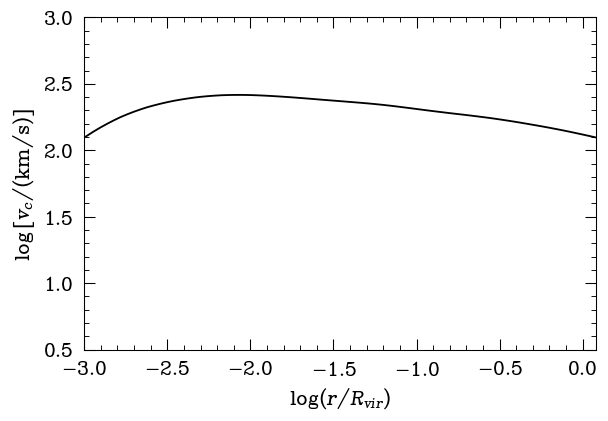

In [10]:
R_min = 10**-1*un.kpc
R_max = 10**3*un.kpc
xarr = np.logspace(np.log10(R_min.to(un.kpc).value), np.log10(R_max.to(un.kpc).value), 100) * un.kpc
plt.plot(np.log10(xarr.value/p[0]['Rvir']), np.log10(potential.vc(xarr).value))
            
plt.xlabel(r'$\log (r/R_{vir})$')
plt.ylabel(r'$\log \left[ v_c/(\mathrm{km/s}) \right]$')
plt.xlim(np.log10(0.001), np.log10(1.2))
plt.ylim(0.5, 3)

In [11]:
idxj = inrange(p[0]['r_scaled'], (0.1, 1/3))
jzavg = np.sum(p[0]['j'][idxj,2]) / np.sum(p[0]['Masses'][idxj])
javg = np.sum(np.linalg.norm(p[0]['j'][idxj], axis=1)) / np.sum(p[0]['Masses'][idxj])
vc = potential.vc(potential.Rvir*p[0]['r_scaled'][idxj])

In [12]:
Rcircavg = np.sum(p[0]['j'][idxj,2] / vc.value) / np.sum(p[0]['Masses'][idxj])

In [13]:
Rcirc = 50
for i in range(10):
    Rcirc = jzavg / potential.vc(un.kpc * Rcirc).value
    print(Rcirc)

20.187471099648945
17.545650226541493
17.19082186883463
17.14333823273146
17.136832134728106
17.135932176139494
17.135807696452357
17.13579047892193
17.135788097464992
17.13578776807186


In [14]:
Rcirc / potential.Rvir.value * 100

6.39349709237276

In [16]:
Rcircavg / potential.Rvir.value * 100

7.781234630642291

In [123]:
p[0]['vrad'], p[0]['vtheta'], p[0]['vphi'] = iht.spherical_velocities(v=p[0]['Velocities'], r=p[0]['Coordinates'])

In [124]:
vphi_avg = [ np.sum((p[0]['vphi']*p[0]['Masses'])[inrange(p[0]['r_scaled'], (r0,r1))]) / np.sum((p[0]['Masses'])[inrange(p[0]['r_scaled'], (r0,r1))]) for r0,r1 in zip(rbins[:-1],rbins[1:]) ]

In [125]:
rbins=np.power(10, np.arange(np.log10(0.005258639741921723), np.log10(3), 0.05))
rmid = (rbins[:-1]+rbins[1:])/2 #in units of Rvir

(-2.0, 0.07918124604762482)

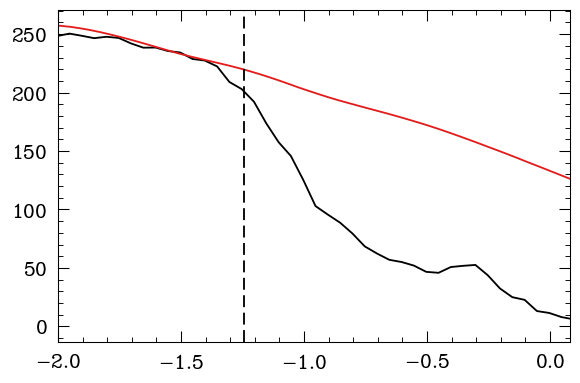

In [128]:
plt.plot(np.log10(rmid), vphi_avg)
plt.plot(np.log10(xarr.value/p[0]['Rvir']), potential.vc(xarr).value)
plt.axvline(np.log10(Rcirc / potential.Rvir.value), ls='--')
plt.xlim(np.log10(0.01), np.log10(1.2))

In [ ]:
find_Rcirc(p_ti)

(0.057154458157027355, 0.06915791637060936)

# Mass inflow rates (m13)

In [7]:
def add_identity(axes, *line_args, **line_kwargs):
    identity, = axes.plot([], [], *line_args, **line_kwargs)
    def callback(axes):
        low_x, high_x = axes.get_xlim()
        low_y, high_y = axes.get_ylim()
        low = max(low_x, low_y)
        high = min(high_x, high_y)
        identity.set_data([low, high], [low, high])
    callback(axes)
    axes.callbacks.connect('xlim_changed', callback)
    axes.callbacks.connect('ylim_changed', callback)
    return axes

In [8]:
labels = {
    1:'$\dot{{M}}_{in, tot}^{v_r<0}\ [M_\odot/\mathrm{{yr}}]$',
    2:'$\dot{{M}}_{in, hot}^{v_r<0}\ [M_\odot/\mathrm{{yr}}]$',
    3:'$\dot{{M}}_{cool, tot}\ [M_\odot/\mathrm{{yr}}]$',
    4:'$\dot{{M}}_{cool, hot}\ [M_\odot/\mathrm{{yr}}]$',
    5:'$\dot{{M}}_{fit}\ [M_\odot/\mathrm{{yr}}]$',
    6:'$\dot{{M}}_{in, cool}^{v_r<0}\ [M_\odot/\mathrm{{yr}}]$',
    7:'$\dot{{M}}_{out, cool}\ [M_\odot/\mathrm{{yr}}]$'
}

In [9]:
def outliers(val, lims):
    marker = 's'
    valnew = val
    if val < 0:
        pass
    elif val > lims[1]:
        valnew = lims[1] - 2.5
        marker = '^'
    elif val < lims[0]:
        valnew = lims[0] + 0.015
        marker = 'v'
    return valnew, marker

In [10]:
import matplotlib.colors as mcolors

def make_simcolors(simname, snapnum, snapnums=[172, 142, 120, 102, 88, 0]):
    # Define base colors for each simulation
    if snapnums[-1] != 0: snapnums.append(0)
    base_colors = {
        'h206_A1_res33000': 'blue',
        'h113_A4_res33000': 'green',
        'h29_A2_res33000': 'red',
        'h2_A8_res33000': 'purple'
    }
    
    # Ensure the simname is valid
    if simname not in base_colors:
        raise ValueError(f"Unknown simulation name: {simname}")
    
    # Ensure the snapnum is valid
    if snapnum not in snapnums:
        raise ValueError(f"Unknown snapshot number: {snapnum}")
    
    # Get the base color for the simulation
    base_color = base_colors[simname]
    
    # Calculate the shade based on the snapshot number
    shade_factor = (snapnums.index(snapnum) + 1) / len(snapnums)
    
    # Convert the base color to RGB
    rgb = mcolors.to_rgb(base_color)
    
    # Create the shade by blending with white
    shaded_rgb = [(1 - shade_factor) * c + shade_factor for c in rgb]
    
    # Convert the shaded RGB back to a hex color
    shaded_color = mcolors.to_hex(shaded_rgb)
    
    return shaded_color

In [11]:
plt.rcParams['lines.markersize'] = 10
marker = mr0 = mr1 = 's'

Text(0.15, 0.85, '$2 \\lesssim z \\lesssim 4$')

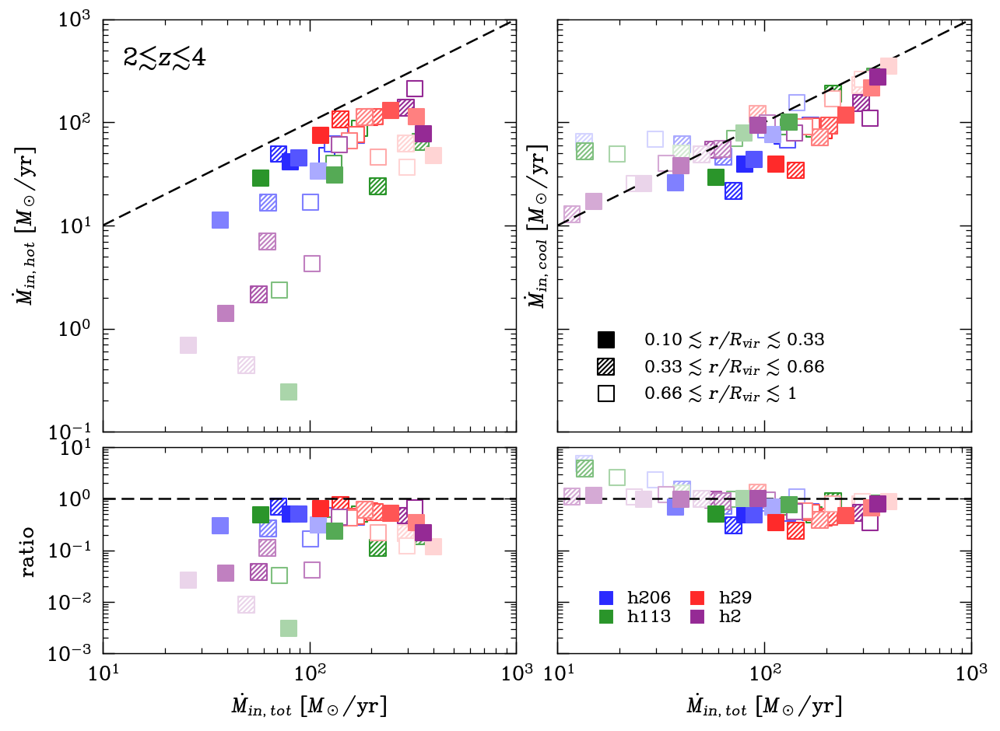

In [98]:
simdir  = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
snapnums = [np.argmin(np.abs(redshifts_snapshots(os.path.join(simdir, 'output')) - zi)) for zi in np.arange(2, 4.1, 0.5)]

rbins = np.array([0.1, 1/3, 2/3, 1])

styles = {
    rbins[0]: dict(marker='s', c='k', zorder=10, label='$0.10\ \lesssim\ r/R_{vir}\ \lesssim\ 0.33$'),
    rbins[1]: dict(marker='s', hatch='/'*8, c='w', label='$0.33\ \lesssim\ r/R_{vir}\ \lesssim\ 0.66$'),
    rbins[2]: dict(marker='s', c='w', label='$0.66\ \lesssim\ r/R_{vir}\ \lesssim\ 1$')
}


fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', gridspec_kw={'wspace': 0.1, 'hspace': 0.05, 'height_ratios': [2, 1]}, figsize=[4.8*2,4.8*1.5], dpi=150, facecolor='w')
lim = (0.07, 1000)
lim2 = (10**-1.1, 10**1.1)

for r0, s in styles.items(): axes[0,1].scatter([], [], **s, ec='k')
axes[0,1].legend(fontsize=13)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    axes[1,1].scatter([], [], marker='s', c=make_simcolors(simname, 172), ec='w', label=simname.split('_')[0])
axes[1,1].legend(fontsize=13, ncol=2, labelspacing=0, columnspacing=0.2, handletextpad=0)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    for snapnum in snapnums:
        if snapnum != [172, 142, 120, 102, 88, 0][4]: pass
        c = make_simcolors(simname, snapnum)
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache/Mdot_{simname}_{snapnum:03}.h5')
        for label in ['inner', 'middle', 'outer']:
            Mdottot = resMdot[label][0]
            Mdothot = resMdot[label][1]
            Mdotcool = resMdot[label][2]
            
            if label=='outer': 
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c='w', ec=c)

            if label=='inner':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c=c, ec=c, zorder=10)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c=c, ec=c, zorder=10)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c=c, ec=c, zorder=10)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c=c, ec=c, zorder=10)
            if label=='middle':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, hatch='/'*8, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, hatch='/'*8, c='w', ec=c)

for ax in axes[0,:]:
    ax.set_xscale('log')
    ax.set_yscale('log')
    add_identity(ax, ls='--', color='k', zorder=1)
    ax.set_xlim((10**1, 10**3))
    ax.set_ylim(10**-1, 10**3)

axes[1,0].set_yscale('log')
axes[1,0].set_ylim((10**-3, 10**1))
axes[1,0].axhline(1, ls='--')
axes[1,1].axhline(1, ls='--')

axes[1,0].set_xlabel(labels[1])
axes[1,1].set_xlabel(labels[1])

axes[0,0].set_ylabel(labels[2])
axes[0,1].set_ylabel(labels[6])

axes[1,0].set_ylabel('ratio')
# axes[1,1].set_ylabel('$\dot{{M}}_{virial}/\dot{{M}}_{tot}$')

for ax in axes.flatten():
    ax.xaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.xaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))
    ax.yaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.yaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))

axes[0,0].set_title(r'$2 \lesssim z \lesssim 4$', y=0.85, x=0.15)
# axes[0,0].set_title(r'$z \approx 4$', y=0.85, x=0.15)
# plt.savefig('../Paper1Figs/Mdotratios.pdf')

Text(0.15, 0.85, '$1 \\lesssim z \\lesssim 5$')

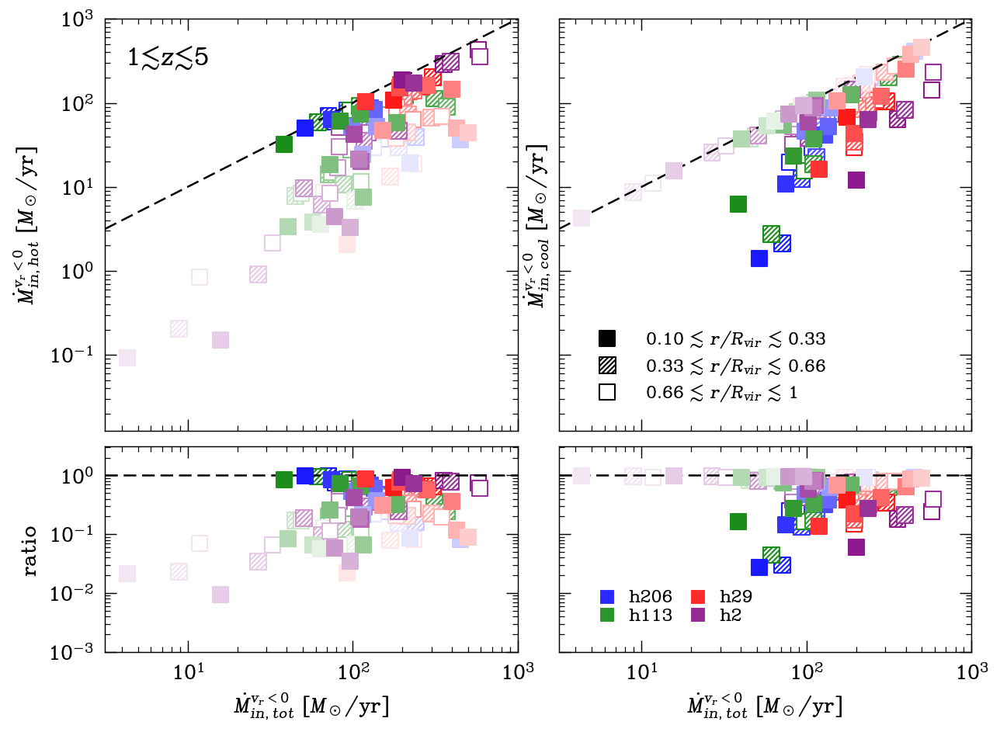

In [13]:
# Updated version for AHF centering
simdir  = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
snapnums = [np.argmin(np.abs(redshifts_snapshots(os.path.join(simdir, 'output')) - zi)) for zi in np.arange(1., 5.1, 0.5)]

rbins = np.array([0.1, 1/3, 2/3, 1])

styles = {
    rbins[0]: dict(marker='s', c='k', zorder=10, label='$0.10\ \lesssim\ r/R_{vir}\ \lesssim\ 0.33$'),
    rbins[1]: dict(marker='s', hatch='/'*8, c='w', label='$0.33\ \lesssim\ r/R_{vir}\ \lesssim\ 0.66$'),
    rbins[2]: dict(marker='s', c='w', label='$0.66\ \lesssim\ r/R_{vir}\ \lesssim\ 1$')
}


fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', gridspec_kw={'wspace': 0.1, 'hspace': 0.05, 'height_ratios': [2, 1]}, figsize=[4.8*2,4.8*1.5], dpi=150, facecolor='w')
lim = (0.07, 1000)
lim2 = (10**-1.1, 10**1.1)

for r0, s in styles.items(): axes[0,1].scatter([], [], **s, ec='k')
axes[0,1].legend(fontsize=13)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    axes[1,1].scatter([], [], marker='s', c=make_simcolors(simname, 172), ec='w', label=simname.split('_')[0])
axes[1,1].legend(fontsize=13, ncol=2, labelspacing=0, columnspacing=0.2, handletextpad=0)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    for snapnum in snapnums:
        c = make_simcolors(simname, snapnum, snapnums[:])
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
        for label in ['inner', 'middle', 'outer']:
#             Mdottot = resMdot[label][0]
#             Mdothot = resMdot[label][1]
#             Mdotcool = resMdot[label][2]
            Mdottot = resMdot[label][6]
            Mdothot = resMdot[label][7]
            Mdotcool = resMdot[label][8]
            
            if label=='outer': 
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c='w', ec=c)

            if label=='inner':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c=c, ec=c, zorder=10)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c=c, ec=c, zorder=10)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c=c, ec=c, zorder=10)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c=c, ec=c, zorder=10)
            if label=='middle':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, hatch='/'*8, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, hatch='/'*8, c='w', ec=c)
for ax in axes[0,:]:
    ax.set_xscale('log')
    ax.set_yscale('log')
    add_identity(ax, ls='--', color='k', zorder=1)
    ax.set_xlim((10**0.5, 10**3))
    ax.set_ylim(10**-1.9, 10**3)

axes[1,0].set_yscale('log')
axes[1,0].set_ylim((10**-3, 10**0.5))
axes[1,0].axhline(1, ls='--')
axes[1,1].axhline(1, ls='--')

axes[1,0].set_xlabel(labels[1])
axes[1,1].set_xlabel(labels[1])

axes[0,0].set_ylabel(labels[2])
axes[0,1].set_ylabel(labels[6])

axes[1,0].set_ylabel('ratio')
# axes[1,1].set_ylabel('$\dot{{M}}_{virial}/\dot{{M}}_{tot}$')

# for ax in axes.flatten():
#     ax.xaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
#     ax.xaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))
#     ax.yaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
#     ax.yaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))

axes[0,0].set_title(r'$1 \lesssim z \lesssim 5$', y=0.85, x=0.15)
# axes[0,0].set_title(r'$z \approx 4$', y=0.85, x=0.15)
# plt.savefig('../Paper1Figs/Mdotratios.pdf')

In [ ]:
# rbins = np.array([0.1, 1/3, 2/3, 1])

styles = {
    rbins[0]: dict(marker='s', c='k', zorder=10, label='$0.10\ \lesssim\ r/R_{vir}\ \lesssim\ 0.33$'),
    rbins[1]: dict(marker='s', hatch='/'*8, c='w', label='$0.33\ \lesssim\ r/R_{vir}\ \lesssim\ 0.66$'),
    rbins[2]: dict(marker='s', c='w', label='$0.66\ \lesssim\ r/R_{vir}\ \lesssim\ 1$')
}


fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', gridspec_kw={'wspace': 0.1, 'hspace': 0.05, 'height_ratios': [2, 1]}, figsize=[4.8*2,4.8*1.5], dpi=150, facecolor='w')
lim = (0.07, 1000)
lim2 = (10**-1.1, 10**1.1)

for r0, s in styles.items(): axes[0,0].scatter([], [], **s, ec='k')
axes[0,0].legend(fontsize=13)

for k,Sim in res_cf.items():
    if 'lowres' in k: continue
#     if 'm12' in k: continue
    c = make_simcolors(k)
    
    for r0,r1 in zip(rbins[:-1],rbins[1:]): #inner, middle, and outer halo
        idx = Sim.fittingidx&inrange(Sim.pro['rmid'], (r0,r1), right_bound_inclusive=False)
        
        Mdottot = np.sum(Sim.pro['js'][idx,2] * Sim.pro['js'][idx,5]) / np.sum(Sim.pro['js'][idx,5]) #Mass-weighted average
        Mdotvirial = np.sum(Sim.pro['js'][idx,3] * Sim.pro['js'][idx,5]) / np.sum(Sim.pro['js'][idx,5]) #Mass-weighted average
        Mdotcoolvirial = np.sum(Sim.pro['js'][idx,8] * Sim.pro['js'][idx,5]) / np.sum(Sim.pro['js'][idx,5]) #Mass-weighted average
        
#         Mdottot = np.sum( Sim.pro['js'][idx,2]*dL[idx] ) / (r1-r0)#np.sum(dL[idx])
#         Mdotvirial = np.sum( Sim.pro['js'][idx,3]*dL[idx] ) / (r1-r0)#np.sum(dL[idx])
#         Mdotcoolvirial = np.sum( Sim.pro['js'][idx,8]*dL[idx] ) / (r1-r0)#np.sum(dL[idx])

        Mdotvirial_outlier, marker = outliers(Mdotvirial, lim)
        rat0, mr0 = outliers(Mdotvirial/Mdottot, lim2)
        rat1, mr1 = outliers(Mdotvirial/Mdotcoolvirial, lim2)
        
        if Mdottot < 0: print('Mdottot < 0', k, r0, Mdottot)
        if Mdotvirial < 0: print('Mdotvirial < 0', k, r0, Mdotvirial)
        if Mdotcoolvirial < 0: print('Mdotcoolvirial < 0', k, r0, Mdotcoolvirial)

        if r0==rbins[2]: 
            axes[0,0].scatter([Mdottot], [Mdotvirial_outlier], marker=marker, c='w', ec=c)
            axes[1,0].scatter([Mdottot], [rat0], marker=mr0, c='w', ec=c)
            
            axes[0,1].scatter([Mdotcoolvirial], [Mdotvirial_outlier], marker=marker, c='w', ec=c)
            axes[1,1].scatter([Mdotcoolvirial], [rat1], marker=mr1, c='w', ec=c)
            
        if r0==rbins[0]: 
            axes[0,0].scatter([Mdottot], [Mdotvirial_outlier], marker=marker, c=c, ec=c, zorder=10)
            axes[1,0].scatter([Mdottot], [rat0], marker=mr0, c=c, ec=c, zorder=10)
            
            axes[0,1].scatter([Mdotcoolvirial], [Mdotvirial_outlier], marker=marker, c=c, ec=c, zorder=10)
            axes[1,1].scatter([Mdotcoolvirial], [rat1], marker=mr1, c=c, ec=c, zorder=10)
        if r0==rbins[1]: 
            axes[0,0].scatter([Mdottot], [Mdotvirial_outlier], marker=marker, hatch='/'*8, c='w', ec=c)
            axes[1,0].scatter([Mdottot], [rat0], marker=mr0, hatch='/'*8, c='w', ec=c)
            
            axes[0,1].scatter([Mdotcoolvirial], [Mdotvirial_outlier], marker=marker, hatch='/'*8, c='w', ec=c)
            axes[1,1].scatter([Mdotcoolvirial], [rat1], marker=mr1, hatch='/'*8, c='w', ec=c)

for ax in axes[0,:]:
    ax.set_xscale('log')
    ax.set_yscale('log')
    add_identity(ax, ls='--', color='k', zorder=1)
    ax.set_xlim(lim)
    ax.set_ylim(lim)

axes[1,0].set_yscale('log')
axes[1,0].set_ylim(lim2)
axes[1,0].axhline(1, ls='--')
axes[1,1].axhline(1, ls='--')

axes[1,0].set_xlabel(labels[1])
axes[1,1].set_xlabel(labels[4])

axes[0,0].set_ylabel(labels[2])
# axes[0,1].set_ylabel(labels[2])

axes[1,0].set_ylabel('ratio')
# axes[1,1].set_ylabel('$\dot{{M}}_{virial}/\dot{{M}}_{tot}$')

for ax in axes.flatten():
    ax.xaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.xaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))
    ax.yaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.yaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))

plt.savefig('../Paper1Figs/Mdotratios.pdf')

## vphi/sigmar

In [12]:
def smooth(y, box_pts=5):
    box = np.ones(box_pts)/box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

In [13]:
def plotmedian(allpts, bins=np.linspace(0,1), lw=2, c=None, plotpts=True, label=None, alpha=None):
    allpts = np.array(allpts)
    if plotpts: plt.plot(allpts[:,0], allpts[:,1], '.', alpha=0.1, markeredgewidth=0.0)

    bins, pt2d = percentile2d(allpts[:,0], allpts[:,1], bins=bins)
    valid = [~np.any(np.isnan(i)) for i in pt2d]
    bins = bins[valid]
    pt2d = np.array(pt2d[valid])
    pt2d = np.reshape(np.concatenate(pt2d), (-1,3))
#     plt.fill_between(bins, pt2d[:,0], pt2d[:,2], alpha=0.25)
    plt.plot(bins, pt2d[:,1], lw=lw, c=c, label=label, alpha=alpha)

In [14]:
def smooth_timewindowMyr(pts, snapnums, dt=200):
    ''' 
    Smooths points in a time window of dt Myr.
    
    Parameters:
    pts : Nx2 array 
        Points (x, y) at snapshot snapnums[i].
    snapnums : array-like
        Snapshot numbers corresponding to pts.
    dt : float, optional
        Time window in Myr for smoothing (default is 10 Myr).
        
    Returns:
    pts_smooth : Nx2 array
        Smoothed points.
    '''
    pts = np.array(pts)
    # Define simulation directory
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
    
    # Load snapshot times (Gyr) and convert to Myr
    stimes = np.loadtxt(os.path.join(simdir, 'output/snapshot_times.txt'))[:, 3] * 1000  # Convert Gyr to Myr
    
    # Map snapnums to actual times
    times = np.array([stimes[snap] for snap in snapnums])
    
    # Initialize smoothed points array
    pts_smooth = np.zeros_like(pts)
    
    # Perform smoothing
    for i in range(len(pts)):
        # Find indices of points within dt Myr of the current time
        mask = np.abs(times - times[i]) <= dt
        pts_smooth[i] = np.median(pts[mask,:], axis=0) # Average over selected points
    
    return pts_smooth

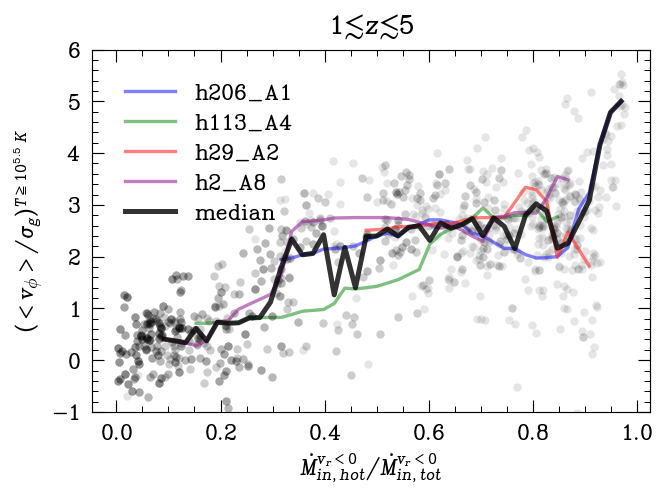

In [15]:
# Updated version for AHF centering
# vphi/sigma
simdir  = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
snapnums = [np.argmin(np.abs(redshifts_snapshots(os.path.join(simdir, 'output')) - zi)) for zi in np.arange(1., 5.1, 0.01)]
zs = [redshifts_snapshots(os.path.join(simdir, 'output'))[s] for s in snapnums]

allpts = []
plt.figure(dpi=120)
for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    b = np.load(f'/home/ias627/projects/massive_halos/t_cool_to_t_ff_all/t_cool_to_t_ff_{simname.split("_")[0]}_Daniel_HR.npz')
    
    pts = []
    for z,snapnum in zip(zs,snapnums):
        c = make_simcolors('h206_A1_res33000', snapnum, snapnums[:])
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
#         yr = resMdot['galaxy'][12]/resMdot['galaxy'][15] #all gas
#         yr = resMdot['galaxy'][13]/resMdot['galaxy'][16] #hot gas
        yr = resMdot['galaxy'][14]/resMdot['galaxy'][17] #cold gas
        
        xr = resMdot['inner'][7]/resMdot['inner'][6]
        logt = b['log_t_cool_to_t_ff_smooth'][np.argmin(np.abs(b['zs']-z))] #log tcool/tff at this redshift
        
        pts.append((xr, yr))
    
    # plot all points for this simulation
    pts = np.array(pts)
    plt.plot(pts[:,0], pts[:,1], '.', alpha=0.1, markeredgewidth=0.0, c='k')
    
    # plot smoothed median curve for simulation
    pts = smooth_timewindowMyr(pts, snapnums, dt=500)
    plotmedian(pts, plotpts=False, label=simname.split('_res')[0], c=make_simcolors(simname, 172), alpha=0.6)
    
    allpts.append(pts)

plotmedian(np.concatenate(allpts), label='median', c='k', lw=3, plotpts=False, alpha=0.8)
    
plt.ylim(-1,6)
plt.ylabel(r'$(<v_\phi>/\sigma_g)^{T \geq 10^{5.5}\ K}$')
# plt.ylabel(r'$<v_\phi>/\sigma_g$')
plt.xlabel('$\dot{{M}}_{in, hot}^{v_r<0}/\dot{{M}}_{in, tot}^{v_r<0}$')
plt.title('$1\lesssim z \lesssim 5$')
plt.legend()

Text(0.5, 1.0, '$1\\lesssim z \\lesssim 5$')

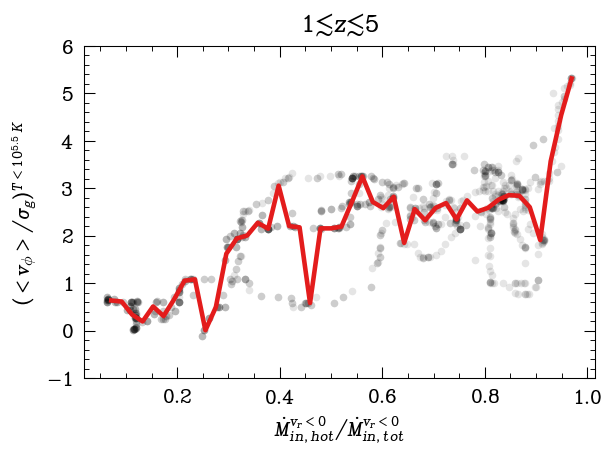

In [200]:
plotmedian(np.concatenate(allpts))

plt.ylim(-1,6)

plt.ylabel(r'$(<v_\phi>/\sigma_g)^{T < 10^{5.5}\ K}$')
# plt.ylabel(r'$<v_\phi>/\sigma_g$')
plt.xlabel('$\dot{{M}}_{in, hot}^{v_r<0}/\dot{{M}}_{in, tot}^{v_r<0}$')
plt.title('$1\lesssim z \lesssim 5$')

Text(0.5, 1.0, '$1\\lesssim z \\lesssim 5$')

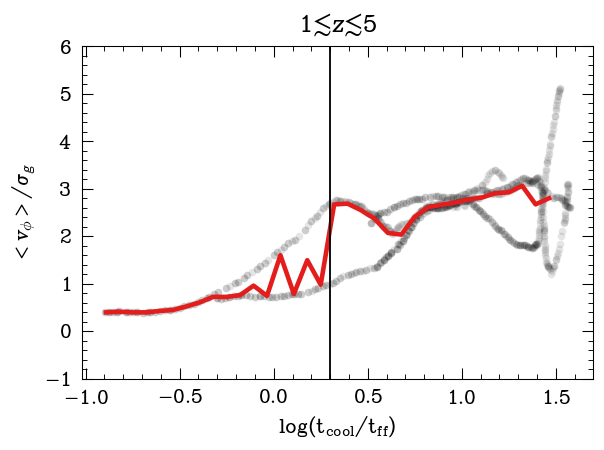

In [182]:
plotmedian(np.concatenate(allpts), bins=np.linspace(-2,1.5))

plt.ylim(-1,6)
# plt.yscale('log')
plt.axvline(np.log10(2))

# plt.ylabel('$\dot{{M}}_{in, hot}^{v_r<0}/\dot{{M}}_{in, tot}^{v_r<0}$')
# plt.ylabel(r'$(<v_\phi>/\sigma_g)^{T \geq 10^{5.5}\ K}$')
plt.ylabel(r'$<v_\phi>/\sigma_g$')
plt.xlabel('$\log(\mathrm{t_{cool}/t_{ff}})$')
plt.title('$1\lesssim z \lesssim 5$')

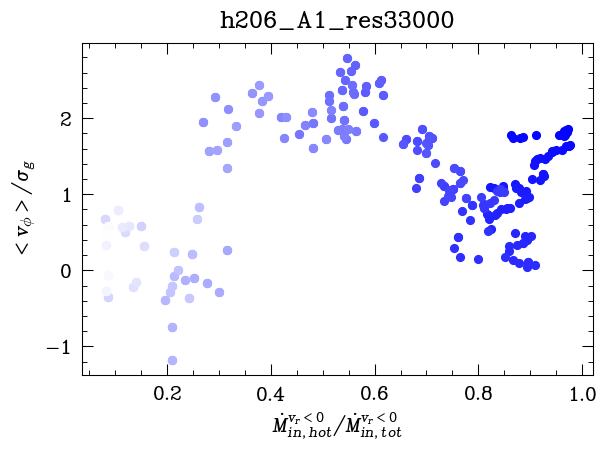

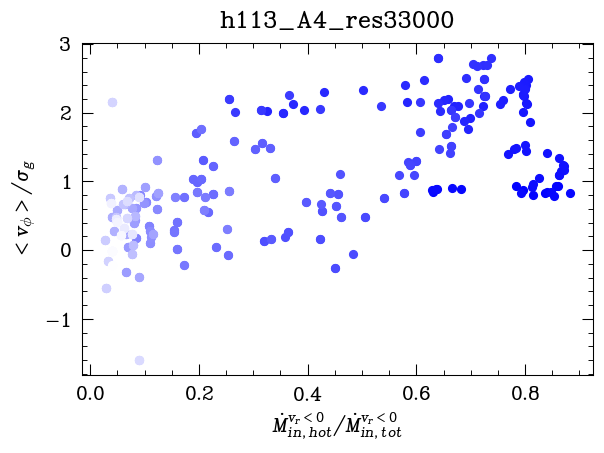

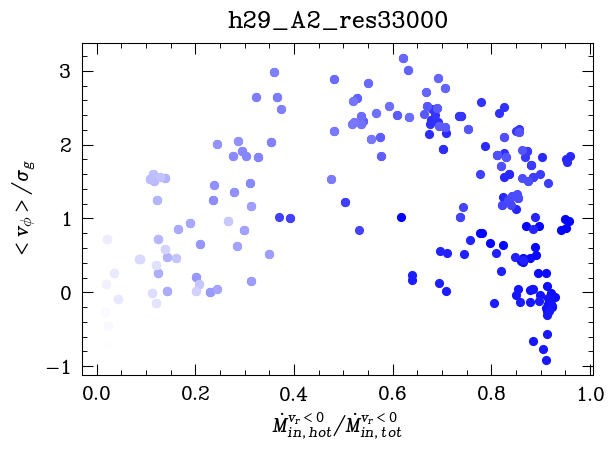

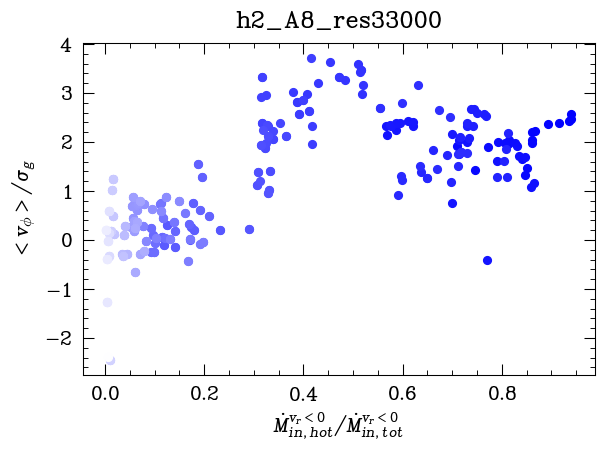

In [14]:
# Updated version for AHF centering
# vphi/sigma
simdir  = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
snapnums = [np.argmin(np.abs(redshifts_snapshots(os.path.join(simdir, 'output')) - zi)) for zi in np.arange(1., 5.1, 0.01)]

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    plt.figure()
    for snapnum in snapnums:
        c = make_simcolors('h206_A1_res33000', snapnum, snapnums[:])
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
        yr = resMdot['galaxy'][12]/resMdot['galaxy'][15] #15 18
        xr = resMdot['inner'][7]/resMdot['inner'][6]
            
        plt.plot(xr, yr, 'k.', c=c)
    plt.xlabel('$\dot{{M}}_{in, hot}^{v_r<0}/\dot{{M}}_{in, tot}^{v_r<0}$')
    plt.ylabel(r'$<v_\phi>/\sigma_g$')
    plt.title(simname)

## ICV tests

In [58]:
def getsnapICV(simname='h206_A1_res33000', dts=[-0.2, -0.4, -0.6]):
#     dts=np.arange(-0.2, -3, -0.1)
    dts=np.arange(3, 0.2, -0.1)
    zICVs = {
        'h206_A1_res33000': 3.6,
        'h113_A4_res33000': 2.2,
        'h29_A2_res33000': 2.7,
        'h2_A8_res33000': 1.7
        
    }
    simdir  = f'/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
    stimes = np.loadtxt(os.path.join(simdir, 'output/snapshot_times.txt'))
    
    sICV = np.argmin(np.abs(stimes[:,2] - zICVs[simname]))
    resarr = [np.argmin(np.abs(stimes[sICV, 3] + dt - stimes[:,3])) for dt in dts]
    resarr = [x for x in resarr if 58 <= x <= 240]
    return resarr

h206_A1_res33000 [230, 226, 222, 218, 214, 210, 206, 202, 198, 194, 190, 186, 181, 177, 173, 169, 164, 160, 156, 151, 147, 142, 138, 133, 129, 124, 119, 114]
h113_A4_res33000 [237, 233, 229, 225, 221, 217, 213, 209, 205, 201, 197, 193, 189, 185, 180, 176, 172]
h29_A2_res33000 [238, 234, 230, 226, 222, 218, 214, 210, 206, 202, 198, 194, 190, 185, 181, 177, 173, 168, 164, 160, 155, 151, 147]
h2_A8_res33000 [239, 235, 231, 227, 223, 219, 215, 211, 207]


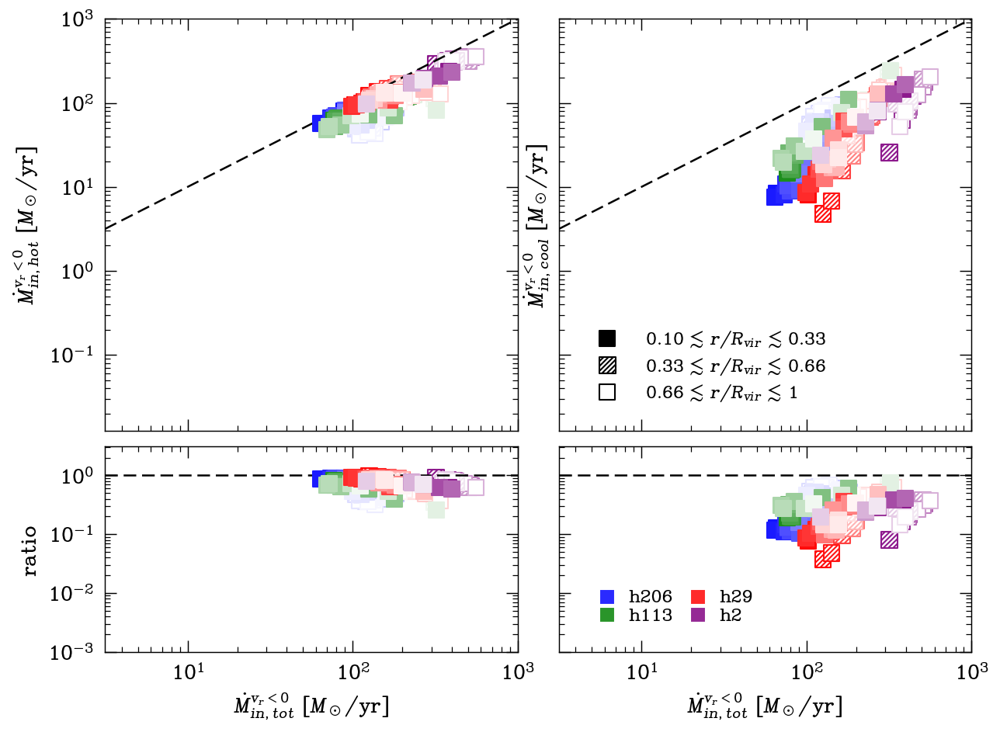

In [59]:
#pre and post ICV tests
simdir  = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
snapnums = [np.argmin(np.abs(redshifts_snapshots(os.path.join(simdir, 'output')) - zi)) for zi in np.arange(2, 4.1, 0.5)]

rbins = np.array([0.1, 1/3, 2/3, 1])

styles = {
    rbins[0]: dict(marker='s', c='k', zorder=10, label='$0.10\ \lesssim\ r/R_{vir}\ \lesssim\ 0.33$'),
    rbins[1]: dict(marker='s', hatch='/'*8, c='w', label='$0.33\ \lesssim\ r/R_{vir}\ \lesssim\ 0.66$'),
    rbins[2]: dict(marker='s', c='w', label='$0.66\ \lesssim\ r/R_{vir}\ \lesssim\ 1$')
}


fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', gridspec_kw={'wspace': 0.1, 'hspace': 0.05, 'height_ratios': [2, 1]}, figsize=[4.8*2,4.8*1.5], dpi=150, facecolor='w')
lim = (0.07, 1000)
lim2 = (10**-1.1, 10**1.1)

for r0, s in styles.items(): axes[0,1].scatter([], [], **s, ec='k')
axes[0,1].legend(fontsize=13)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    axes[1,1].scatter([], [], marker='s', c=make_simcolors(simname, 172), ec='w', label=simname.split('_')[0])
axes[1,1].legend(fontsize=13, ncol=2, labelspacing=0, columnspacing=0.2, handletextpad=0)

for simname in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(simname, getsnapICV(simname))
    for snapnum in getsnapICV(simname):
        c = make_simcolors(simname, snapnum, getsnapICV(simname))
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
        for label in ['inner', 'middle', 'outer']:
            Mdottot = resMdot[label][6]
            Mdothot = resMdot[label][7]
            Mdotcool = resMdot[label][8]
            
            if label=='outer': 
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c='w', ec=c)

            if label=='inner':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, c=c, ec=c, zorder=10)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, c=c, ec=c, zorder=10)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, c=c, ec=c, zorder=10)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, c=c, ec=c, zorder=10)
            if label=='middle':
                axes[0,0].scatter([Mdottot], [Mdothot], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,0].scatter([Mdottot], [Mdothot/Mdottot], marker=mr0, hatch='/'*8, c='w', ec=c)

                axes[0,1].scatter([Mdottot], [Mdotcool], marker=marker, hatch='/'*8, c='w', ec=c)
                axes[1,1].scatter([Mdottot], [Mdotcool/Mdottot], marker=mr1, hatch='/'*8, c='w', ec=c)

for ax in axes[0,:]:
    ax.set_xscale('log')
    ax.set_yscale('log')
    add_identity(ax, ls='--', color='k', zorder=1)
    ax.set_xlim((10**0.5, 10**3))
    ax.set_ylim(10**-1.9, 10**3)

axes[1,0].set_yscale('log')
axes[1,0].set_ylim((10**-3, 10**0.5))
axes[1,0].axhline(1, ls='--')
axes[1,1].axhline(1, ls='--')

axes[1,0].set_xlabel(labels[1])
axes[1,1].set_xlabel(labels[1])

axes[0,0].set_ylabel(labels[2])
axes[0,1].set_ylabel(labels[6])

axes[1,0].set_ylabel('ratio')
# axes[1,1].set_ylabel('$\dot{{M}}_{virial}/\dot{{M}}_{tot}$')

for ax in axes.flatten():
    ax.xaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.xaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))
    ax.yaxis.set_major_locator(plt.LogLocator(base=10.0, numticks=10))
    ax.yaxis.set_minor_locator(plt.LogLocator(base=10.0, subs='auto', numticks=10))

# axes[0,0].set_title(r'$2 \lesssim z \lesssim 4$', y=0.85, x=0.15)
# axes[0,0].set_title(r'$z \approx 4$', y=0.85, x=0.15)
# plt.savefig('../Paper1Figs/Mdotratios.pdf')

# Mass inflow rates vs t

In [150]:
b = np.load('/home/ias627/projects/massive_halos/t_cool_to_t_ff_all/t_cool_to_t_ff_h29_Daniel_HR.npz')

Text(0, 0.5, '$\\log(\\mathrm{t_{cool}/t_{ff}})$')

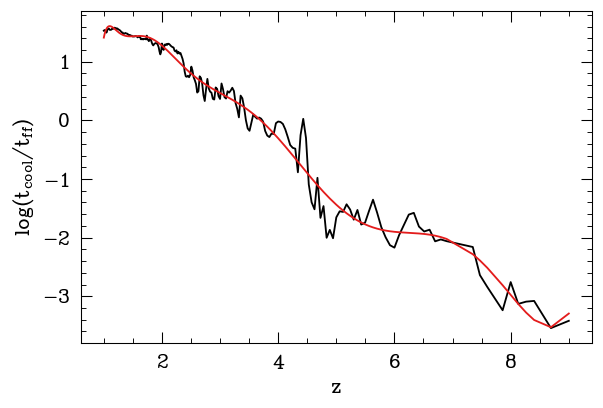

In [151]:
plt.plot(b['zs'], b['log_t_cool_to_t_ff'])
plt.plot(b['zs'], b['log_t_cool_to_t_ff_smooth'])
plt.xlabel('z')
plt.ylabel('$\log(\mathrm{t_{cool}/t_{ff}})$')

In [157]:
simname = 'h206_A1_res33000'
zs = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')
logtratio = [b['log_t_cool_to_t_ff_smooth'][ np.argmin(np.abs(z - b['zs'])) ] for z in zs[58:143]]

Mdottots = []
Mdothots = []
Mdotcools = []
for snapnum in range(58, 143):
    resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
    for label in ['inner']:#['inner', 'middle', 'outer']:
        Mdottot = resMdot[label][0]
        Mdothot = resMdot[label][1]
        Mdotcool = resMdot[label][2]
        
        Mdottots.append(Mdottot)
        Mdothots.append(Mdothot)
        Mdotcools.append(Mdotcool)

Mdottots = np.array(Mdottots)
Mdothots = np.array(Mdothots)
Mdotcools = np.array(Mdotcools)

Text(0, 0.5, '$\\dot{M}$ $\\mathrm{[M_{\\odot}/yr]}$')

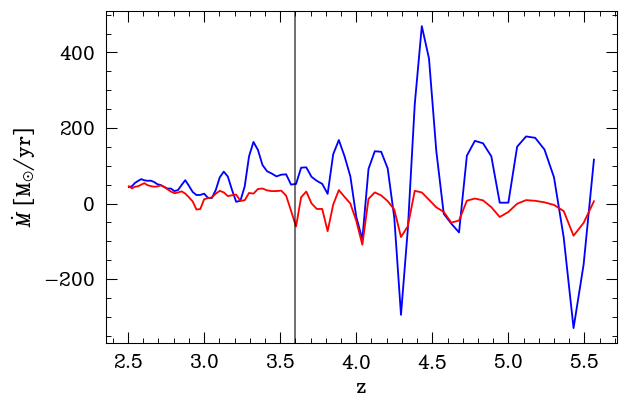

In [159]:
plt.plot(zs[58:143], Mdotcools, c='b')
plt.plot(zs[58:143], Mdothots, c='r')
plt.axvline(3.6, c='k', alpha=0.6)

plt.xlabel('z')
plt.ylabel('$\dot{M}$ $\mathrm{[M_{\odot}/yr]}$')

Text(0, 0.5, '$\\dot{M}$ $\\mathrm{[M_{\\odot}/yr]}$')

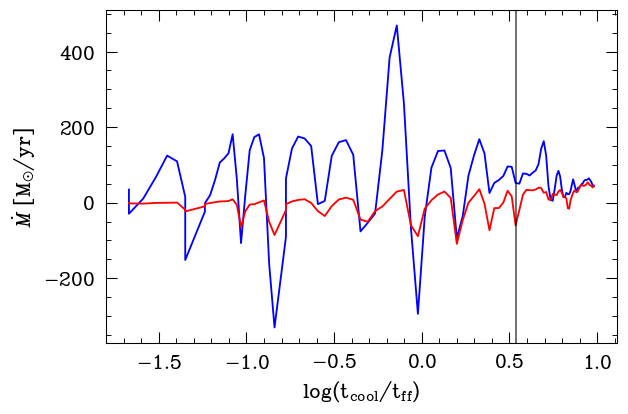

In [87]:
plt.plot(logtratio, Mdotcools, c='b')
plt.plot(logtratio, Mdothots, c='r')
plt.axvline(b['log_t_cool_to_t_ff_smooth'][ np.argmin(np.abs(3.6 - b['zs'])) ], c='k', alpha=0.6)

plt.xlabel('$\log(\mathrm{t_{cool}/t_{ff}})$')
plt.ylabel('$\dot{M}$ $\mathrm{[M_{\odot}/yr]}$')

In [190]:
def Mdot_tratio(simname, zICV):
    bsn = simname.split('_')[0]
    b = np.load(f'/home/ias627/projects/massive_halos/t_cool_to_t_ff_all/t_cool_to_t_ff_{bsn}_Daniel_HR.npz')
    
    plt.figure()
    plt.plot(b['zs'], b['log_t_cool_to_t_ff'])
    plt.plot(b['zs'], b['log_t_cool_to_t_ff_smooth'])
    plt.xlabel('z')
    plt.ylabel('$\log(\mathrm{t_{cool}/t_{ff}})$')
    plt.axvline(zICV, c='k', alpha=0.6)
    plt.title(simname)
    
    zs = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')
    logtratio = [b['log_t_cool_to_t_ff_smooth'][ np.argmin(np.abs(z - b['zs'])) ] for z in zs[58:241]]

    Mres = []
    for snapnum in range(58, 241):
        resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
        for label in ['inner']:#['inner', 'middle', 'outer']:
            Mdottot = resMdot[label][0]
            Mdothot = resMdot[label][1]
            Mdotcool = resMdot[label][2]
            
            Mtot = resMdot[label][3]
            Mhot = resMdot[label][4]
            Mcool = resMdot[label][5]

            Mres.append([Mdottot, Mdothot, Mdotcool, Mtot, Mhot, Mcool])

    Mres = np.array(Mres)
    
    plt.figure()
    plt.plot(zs[58:241], Mres[:,2], c='b')
    plt.plot(zs[58:241], Mres[:,1], c='r')
    plt.axvline(zICV, c='k', alpha=0.6)
    plt.xlabel('z')
    plt.ylabel('$\dot{M}$ $\mathrm{[M_{\odot}/yr]}$')
    plt.title(simname)
#     plt.xlim(1.1,zICV+0.1)
    
    plt.figure()
    plt.plot(logtratio, Mres[:,2], c='b')
    plt.plot(logtratio, Mres[:,1], c='r')
    plt.axvline(b['log_t_cool_to_t_ff_smooth'][ np.argmin(np.abs(zICV - b['zs'])) ], c='k', alpha=0.6)
    plt.xlabel('$\log(\mathrm{t_{cool}/t_{ff}})$')
    plt.ylabel('$\dot{M}$ $\mathrm{[M_{\odot}/yr]}$')
    plt.title(simname)
    
    plt.figure()
    plt.plot(logtratio, Mres[:,2]/Mres[:,0], c='b')
    plt.plot(logtratio, Mres[:,1]/Mres[:,0], c='r')
    plt.axvline(b['log_t_cool_to_t_ff_smooth'][ np.argmin(np.abs(zICV - b['zs'])) ], c='k', alpha=0.6)
    plt.xlabel('$\log(\mathrm{t_{cool}/t_{ff}})$')
    plt.ylabel('$\dot{M}$ $\mathrm{[M_{\odot}/yr]}$')
    plt.title(simname)
    
    plt.figure()
    plt.plot(zs[58:241], Mres[:,5], c='b')
    plt.plot(zs[58:241], Mres[:,4], c='r')
    plt.yscale('log')
    plt.axvline(zICV, c='k', alpha=0.6)
    plt.xlabel('$z$')
    plt.ylabel('$M_{\mathrm{inner}}$ $\mathrm{[M_{\odot}]}$')
    plt.title(simname)

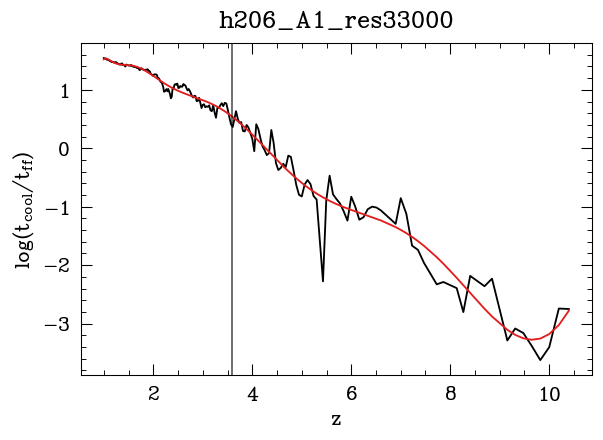

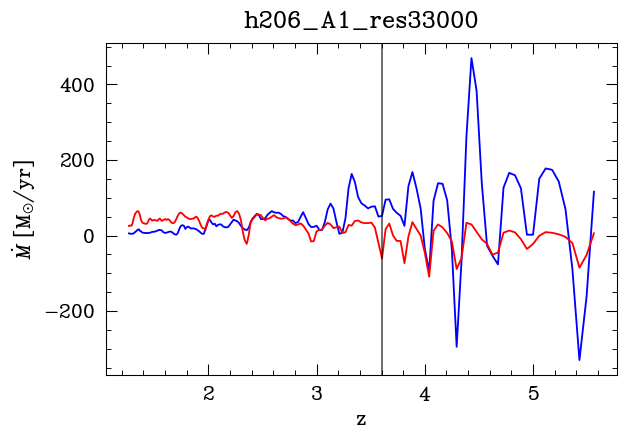

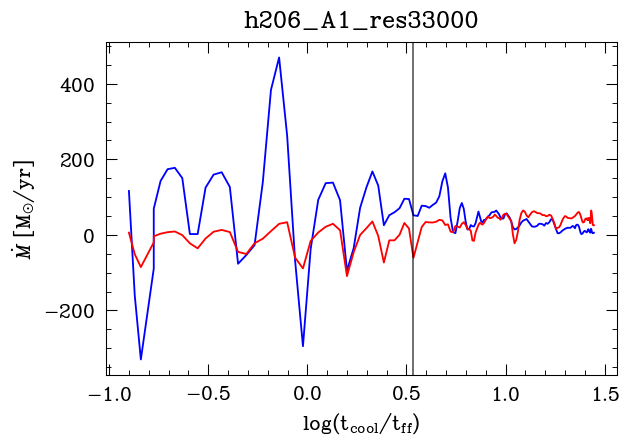

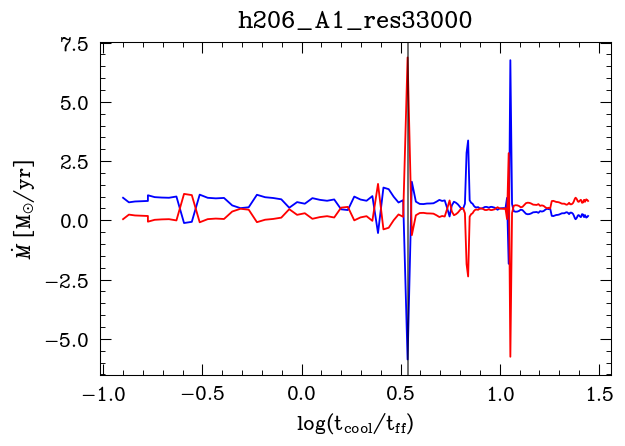

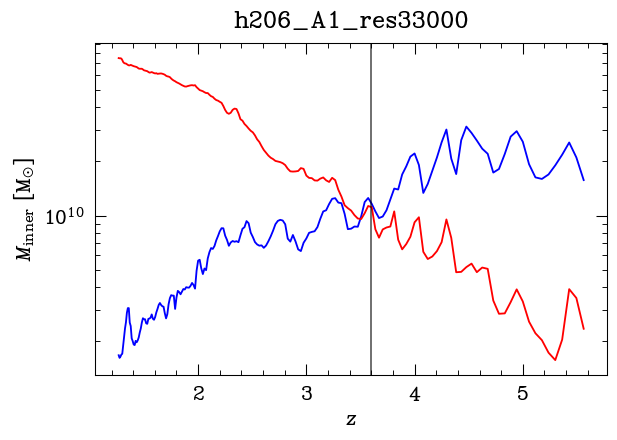

...

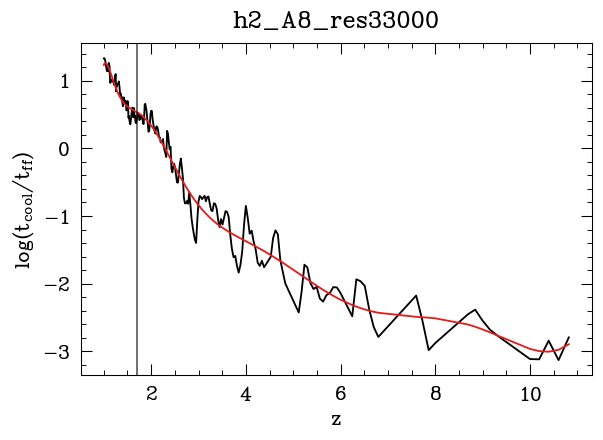

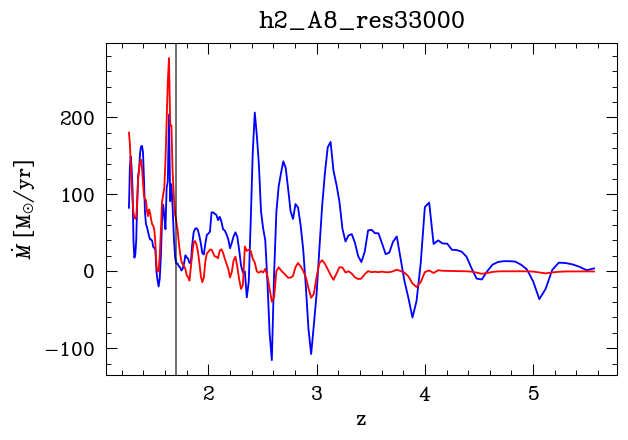

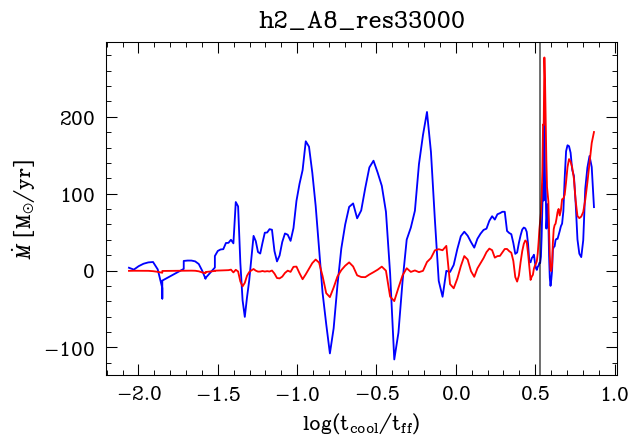

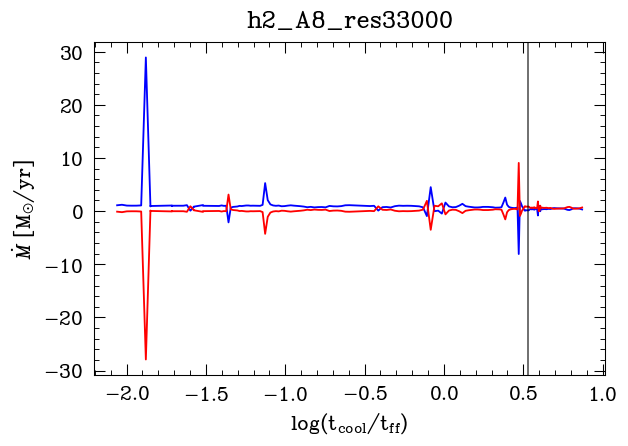

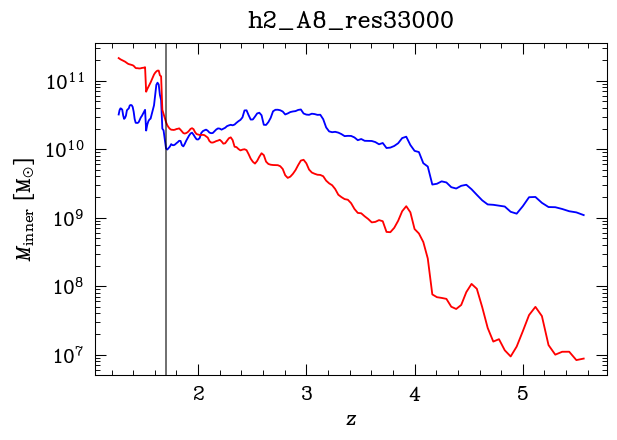

In [191]:
zICVs = [3.6, 2.2, 2.7, 1.7]
for simname, zICV in zip(['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000'], zICVs):
    Mdot_tratio(simname, zICV)

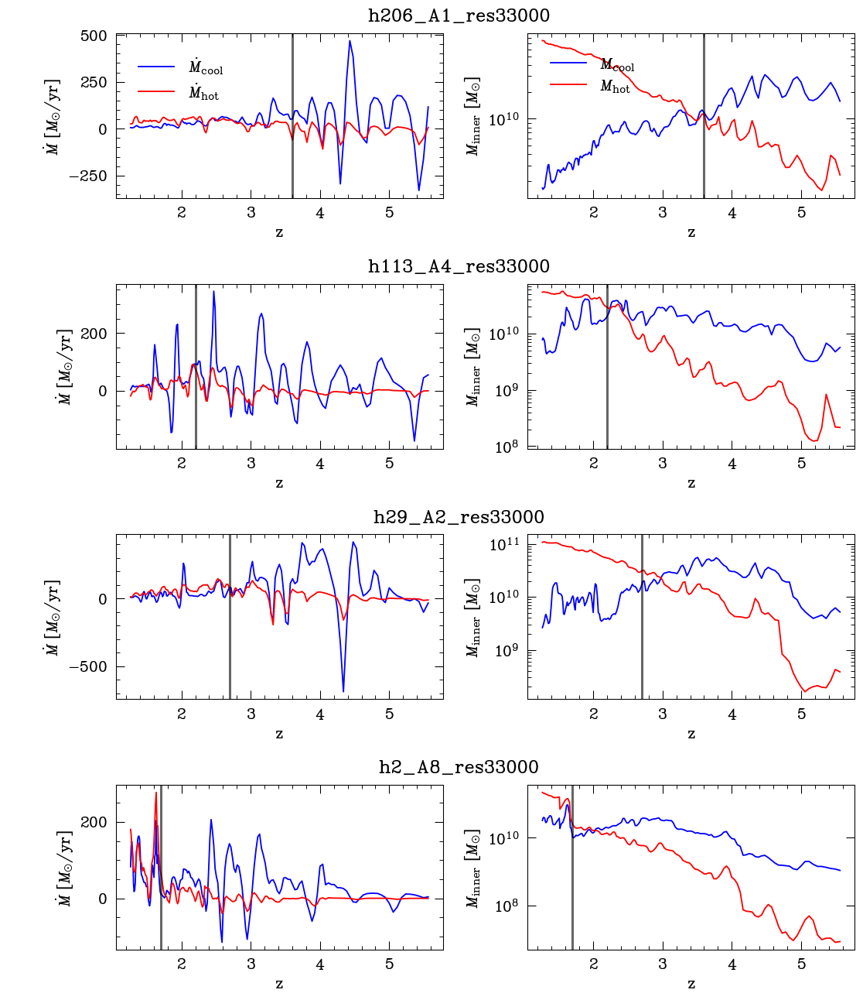

In [6]:
def Mdot_tratio(simnames, zICVs):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 12))
    
    for i, (simname, zICV) in enumerate(zip(simnames, zICVs)):
        bsn = simname.split('_')[0]
        b = np.load(f'/home/ias627/projects/massive_halos/t_cool_to_t_ff_all/t_cool_to_t_ff_{bsn}_Daniel_HR.npz')

        zs = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')
        logtratio = [b['log_t_cool_to_t_ff_smooth'][np.argmin(np.abs(z - b['zs']))] for z in zs[58:241]]

        Mres = []
        for snapnum in range(58, 241):
            resMdot = h5todict(f'/projects/b1026/isultan/data/Mdotcache_AHF/Mdot_{simname}_{snapnum:03}.h5')
            Mdottot, Mdothot, Mdotcool, Mtot, Mhot, Mcool = resMdot['inner']
            Mres.append([Mdottot, Mdothot, Mdotcool, Mtot, Mhot, Mcool])
        
        Mres = np.array(Mres)
        
        # First column: Mdotcool and Mdothot vs. z with logtratio as top x-axis
        ax1 = axes[i, 0]
        ax1.plot(zs[58:241], Mres[:, 2], c='b', label=r'$\dot{M}_{\mathrm{cool}}$')
        ax1.plot(zs[58:241], Mres[:, 1], c='r', label=r'$\dot{M}_{\mathrm{hot}}$')
        ax1.axvline(zICV, c='k', lw=2, alpha=0.6)
        ax1.set_xlabel('z')
        ax1.set_ylabel(r'$\dot{M}$ [$M_{\odot}$/yr]')
        ax1.set_title(' '*60+simname)
        if i == 0: ax1.legend()

#         # Twin x-axis for logtratio
#         ax_top = ax1.twiny()
#         ax_top.plot(logtratio, Mres[:, 2], alpha=1)  # Invisible, just for axis scaling
#         ax_top.set_xlabel(r'$\log(t_{\mathrm{cool}} / t_{\mathrm{ff}})$')

#         tick_positions = np.linspace(min(zs[58:241]), max(zs[58:241]), 5)  # Choose ~5 tick positions
#         tick_labels = np.interp(tick_positions, zs[58:241], logtratio)  # Map z to logtratio
#         ax_top.set_xticks(tick_positions)
#         ax_top.set_xticklabels([f"{x:.1f}" for x in tick_labels])

        # Second column: Mhot and Mcool vs. z
        ax2 = axes[i, 1]
        ax2.plot(zs[58:241], Mres[:, 5], c='b', label=r'$M_{\mathrm{cool}}$')
        ax2.plot(zs[58:241], Mres[:, 4], c='r', label=r'$M_{\mathrm{hot}}$')
        ax2.set_yscale('log')
        ax2.axvline(zICV, c='k', lw=2, alpha=0.6)
        ax2.set_xlabel('z')
        ax2.set_ylabel(r'$M_{\mathrm{inner}}$ [$M_{\odot}$]')
        if i == 0: ax2.legend(loc=2)

    plt.tight_layout()
    plt.show()

# Define inputs
simnames = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']
zICVs = [3.6, 2.2, 2.7, 1.7]

# Run function
Mdot_tratio(simnames, zICVs)

# Halo centering

h206_A1_res33000


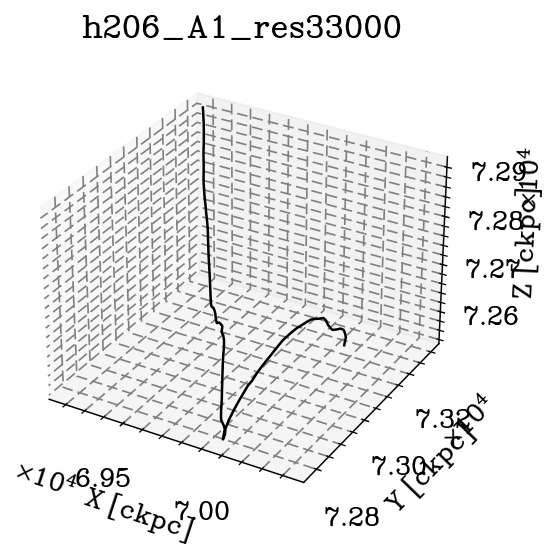

h113_A4_res33000


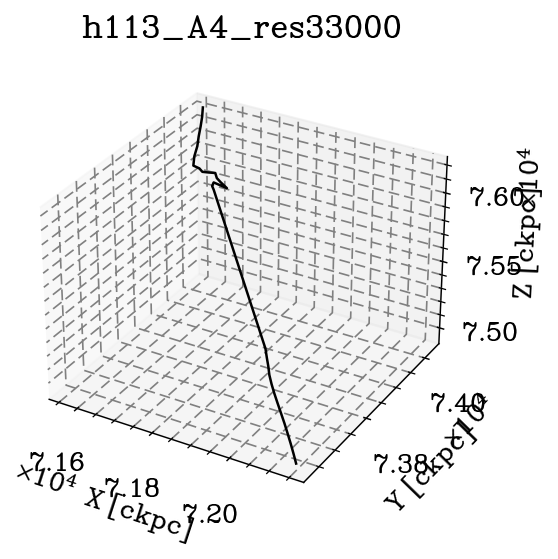

h29_A2_res33000


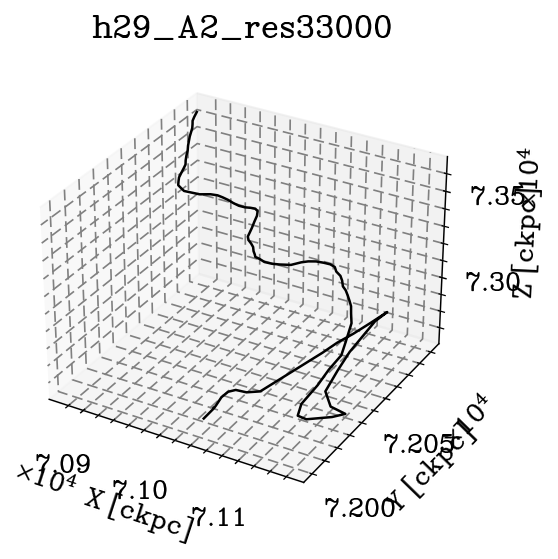

m12i_r7100


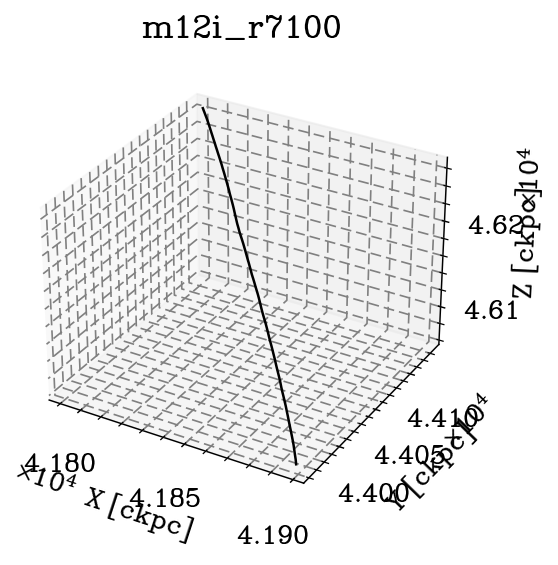

h2_A8_res33000


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

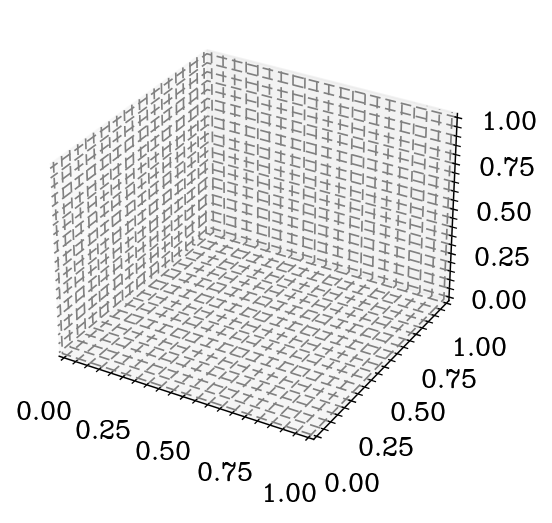

In [3]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'm12i_r7100', 'h2_A8_res33000']
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/rotateLastSnap_newcen'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))
for simname in m13s:
    print(simname)
    filestoread = natsorted([f for f in glob(os.path.join(datadir, f'particles_{simname}_*.h5')) if re.match(rf'{datadir}/particles_{simname}_(\d+)\.h5', f)])
#     filestoread = filestoread[95-36:] if 'res33000' in simname else filestoread[547-504:] #remove initial 1Gyr, to avoid centering issues
    res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)
    
    posCs = np.array([p['posC']/p['ScaleFactor'] for p in res])
    
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '-', ms=1)

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')
    plt.title(simname)

    plt.show()

h206_A1_res33000


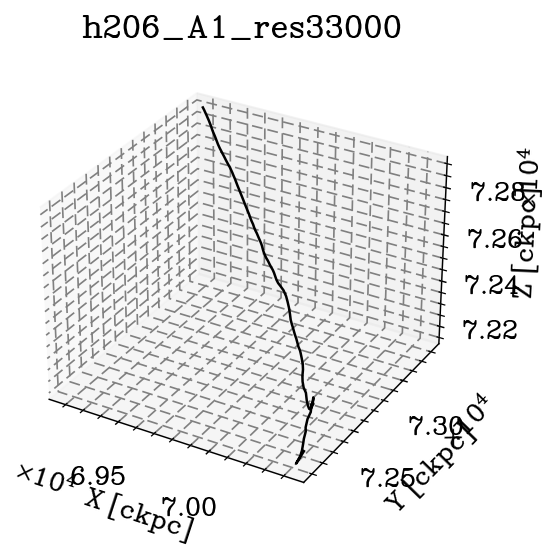

h113_A4_res33000


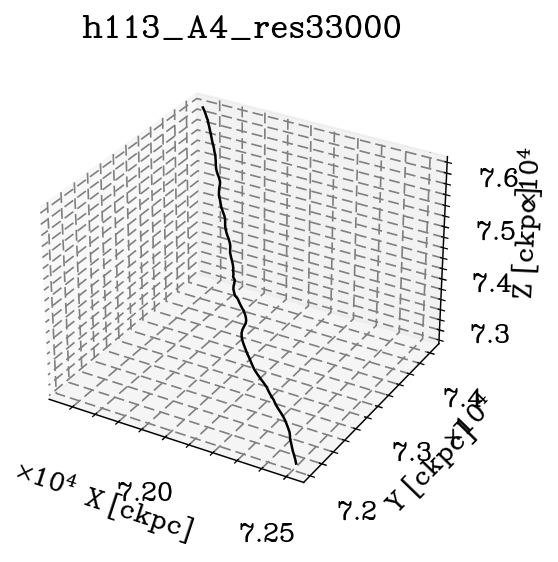

h29_A2_res33000


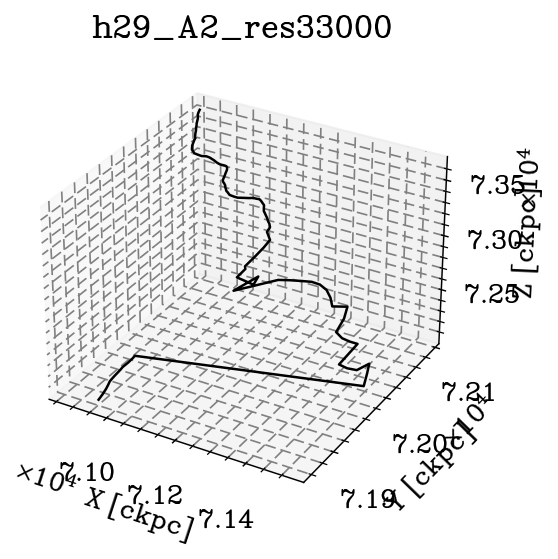

m12i_r7100


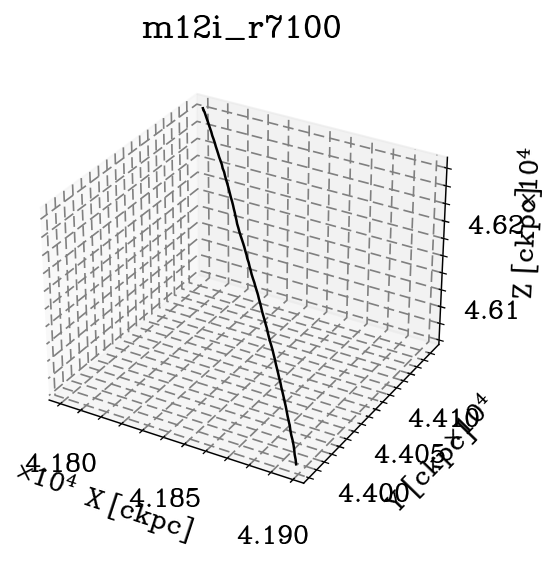

h2_A8_res33000


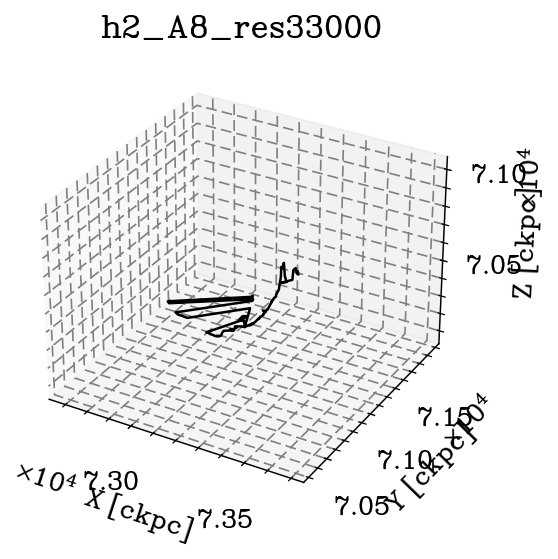

In [39]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'm12i_r7100', 'h2_A8_res33000']
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/rotateLastSnap_newcen'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))
for simname in m13s:
    print(simname)
    filestoread = natsorted([f for f in glob(os.path.join(datadir, f'particles_{simname}_*.h5')) if re.match(rf'{datadir}/particles_{simname}_(\d+)\.h5', f)])
#     filestoread = filestoread[95-36:] if 'res33000' in simname else filestoread[547-504:] #remove initial 1Gyr, to avoid centering issues
    res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)
    
    posCs = np.array([p['posC']/p['ScaleFactor'] for p in res])
    
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '-', ms=1)

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')
    plt.title(simname)

    plt.show()

In [31]:
posCs = np.array([p['posC']/p['ScaleFactor'] for p in res])

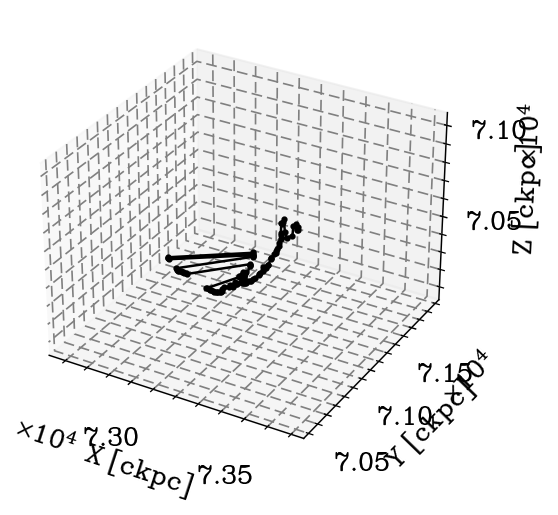

In [52]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], 'o-', ms=2)

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

In [40]:
keys_to_extract = {
    0:['Coordinates', 'Masses', 'Density', 
    'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 
    'Velocities', 'Metallicity', 'SoundSpeed', 'CoolingRate', 'SmoothingLength', 'MagneticField', 'ParticleIDs'],
    1:['Coordinates', 'Masses', 'Velocities'],
    2:['Coordinates', 'Masses', 'Velocities'],
    4:['Coordinates', 'Masses', 'Velocities', 'ParticleIDs'],
    5:['Coordinates', 'Masses', 'Velocities']
}
simdir = f'/projects/b1026/snapshots/MassiveFIRE/h2_A8_res33000'
p = load_allparticles(simdir, 38+36, [0,1,2,4,5], keys_to_extract=keys_to_extract, loud=0)

In [41]:
p0 = p2 = load_allparticles(simdir, 38+36-1, [0,1,2,4,5], keys_to_extract=keys_to_extract, loud=0)
p2 = load_allparticles(simdir, 38+36+1, [0,1,2,4,5], keys_to_extract=keys_to_extract, loud=0)

In [46]:
print(p0[0]['posC']/p0[0]['ScaleFactor'])
print(p[0]['posC']/p[0]['ScaleFactor'])
print(p2[0]['posC']/p2[0]['ScaleFactor'])

[73116.19  71138.516 70242.44 ]
[73118.89  71121.695 70249.07 ]
[73054.01 70919.02 70253.79]


In [53]:
halo_center_wrapper(p2[1], shrinkpercent=2.5, minparticles=1000, initialradiusfactor=1)[0]/p2[0]['ScaleFactor']

array([73054.01, 70919.02, 70253.79], dtype=float32)

In [58]:
halo_center_wrapper(p0[1])[0]/p0[0]['ScaleFactor']

array([73016.74 , 69880.555, 71238.73 ], dtype=float32)

In [59]:
halo_center_wrapper(p[1])[0]/p[0]['ScaleFactor']

array([73024.375, 69877.33 , 71235.07 ], dtype=float32)

In [60]:
halo_center_wrapper(p2[1])[0]/p2[0]['ScaleFactor']

array([73032.66 , 69874.945, 71232.29 ], dtype=float32)

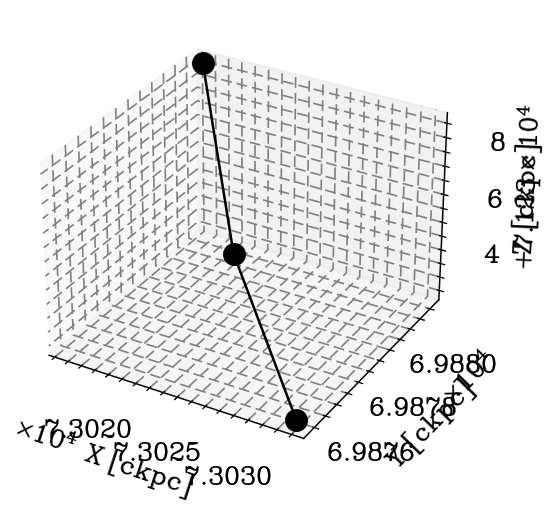

In [57]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

ax.plot([73016.74,73024.375,73032.66], [69880.555,69877.33,69874.945], [71238.73,71235.07,71232.29], 'o-', ms=10)

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

In [12]:
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)('/projects/b1026/isultan/metal_diffusion/m12i_r7100/output', s) for s in range(560, 587))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
/home/ias627/projects/massive_halos/scripts/particle_tracking.py:82: RuntimeWarning: invalid value encountered in divide
  p[k]['jalign'] = p[k]['j'][:,2] / np.linalg.norm(p[k]['j'], axis=1)
/home/ias627/projects/massive_halos/scripts/particle_tracking.py:82: RuntimeWarning: invalid value encountered in divide
  p[k]['jalign'] = p[k]['j'][:,2] / np.linalg.norm(p[k]['j'], axis=1)
/home/ias627/projects/massive_halos/scripts/particle_tracking.py:82: RuntimeWarning: invalid value encountered in divide
  p[k]['jalign'] = p[k]['j'][:,2] / np.linalg.norm(p[k]['j'], axis=1)
/home/ias627/projects/massive_halos/scripts/particle_tracking.py:82: RuntimeWarning: invalid value encountered in divide
  p[k]['jalign'] = p[k]['j'][:,2] / np.linalg.norm(p[k]['j'], axis=1)
/home/ias627/projects/massive_halos/scripts/particle_tracking.py:82: RuntimeWarning: invalid value encountered in divide
  p[k]['jalign'] = p[k]['j'][:,2] / np

h2_A8_res33000


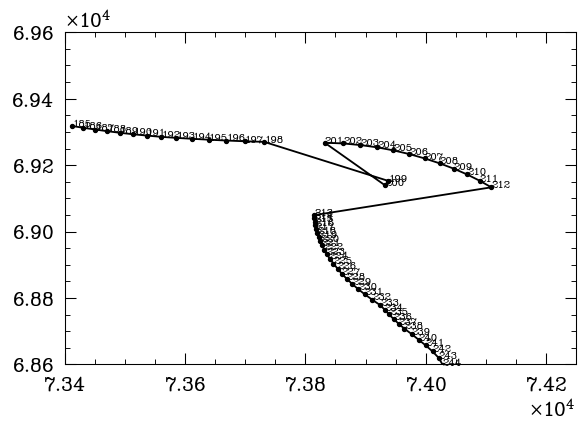

In [165]:
#14, 278 TEST
for sim in ['h2_A8_res33000']:
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0]/sfs[s] for s in range(185,250)])
    
    fig, ax = plt.subplots()
    ax.plot(posCs[:,0],posCs[:,1], '.-', ms=5)
    ax.set_ylim(6.86e4, 6.96e4)
    ax.set_xlim(7.34e4, 7.425e4)
    for i, txt in enumerate(range(185,250)): ax.annotate(txt, (posCs[i,0], posCs[i,1]), fontsize=8)

h206_A1_res33000


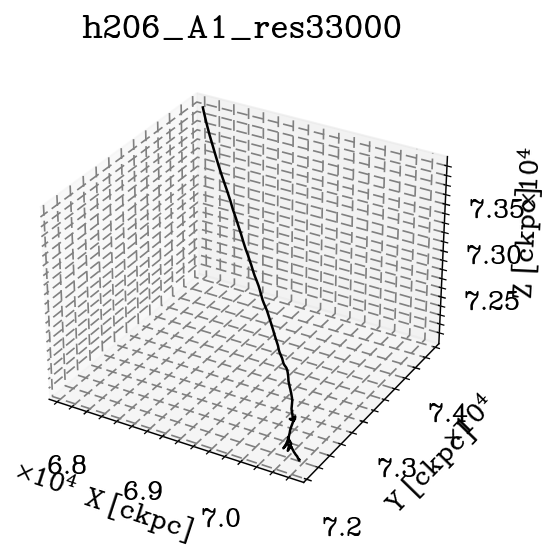

h113_A4_res33000


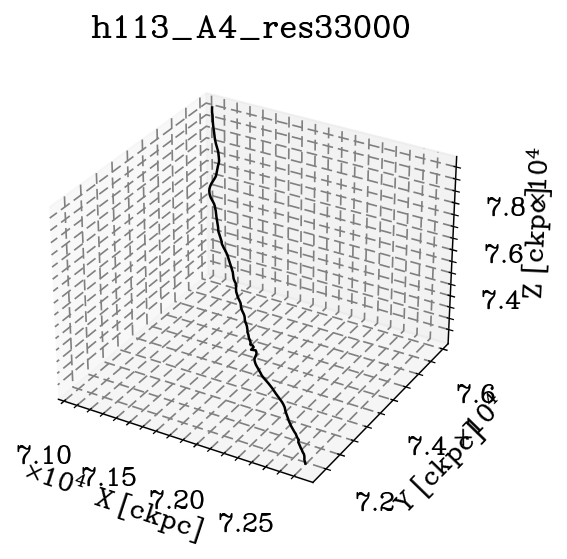

h29_A2_res33000


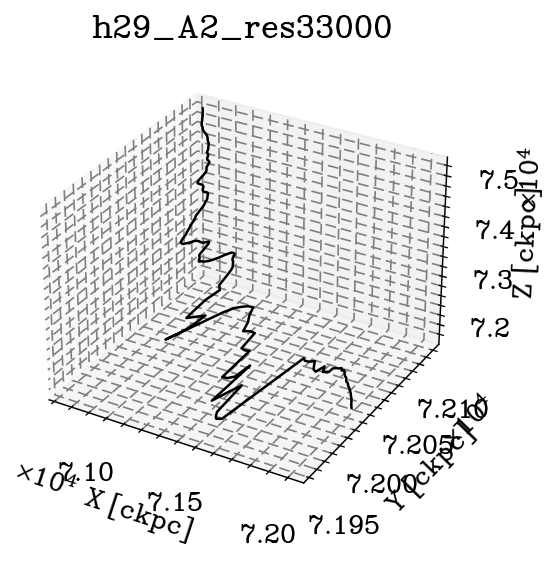

h2_A8_res33000


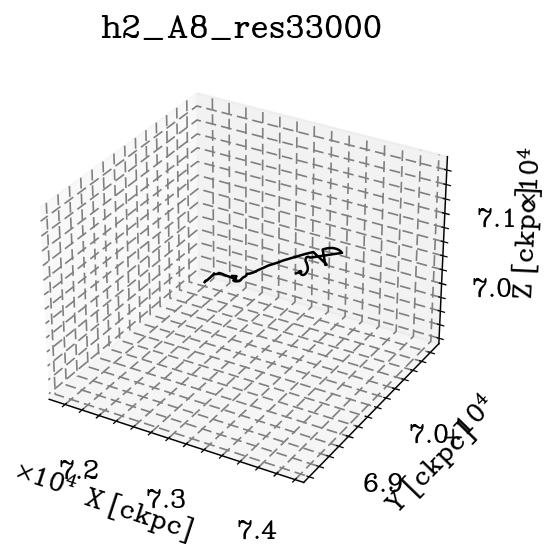

In [145]:
#14, 278
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0]/sfs[s] for s in range(14,278)])
    
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '-', ms=1)

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')
    plt.title(sim)

    plt.show()

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


(180.0, 240.0)

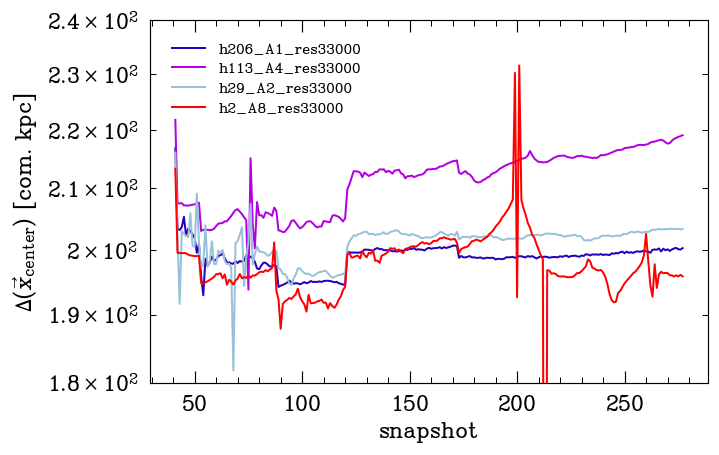

In [11]:
# AHF
plt.figure(dpi=120)
for c,sim in zip(COLOR_SCHEME,['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']):
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0] for s in range(40,278)])
    plt.plot(range(41,278), np.linalg.norm(posCs[1:]-posCs[:-1], axis=1), label=sim, c=c)

plt.yscale('log')
plt.legend(loc=2, fontsize=10)
plt.xlabel('snapshot')
plt.ylabel(r'$\Delta (\vec{x}_{\mathrm{center}})$ [com. kpc]')
plt.ylim(1.8e2, 2.4e2)

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


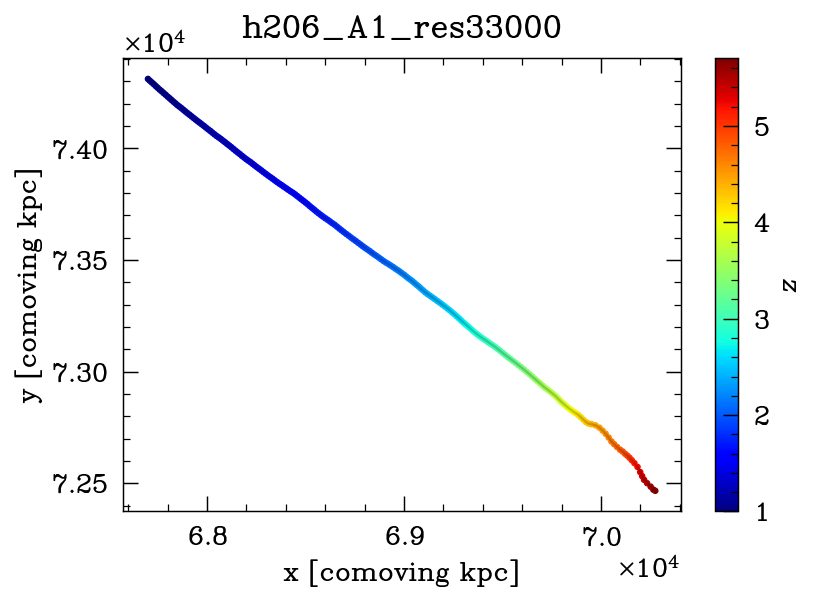

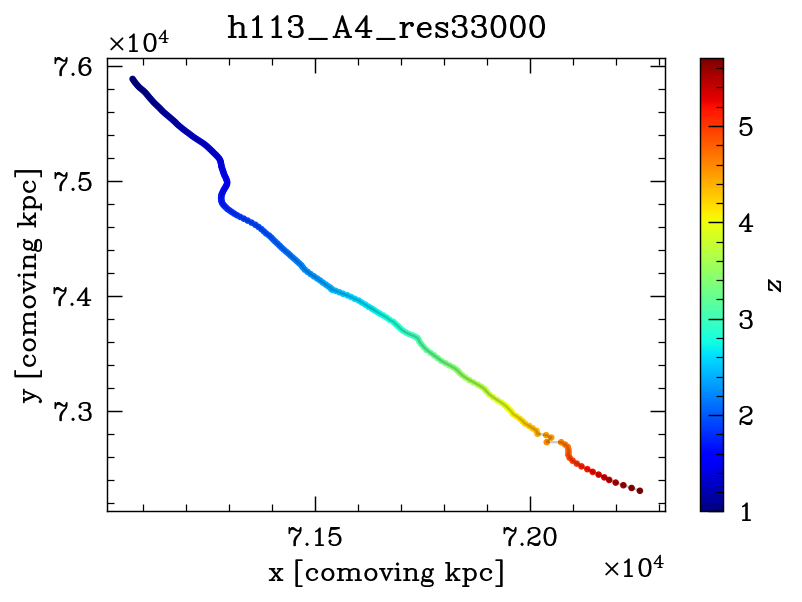

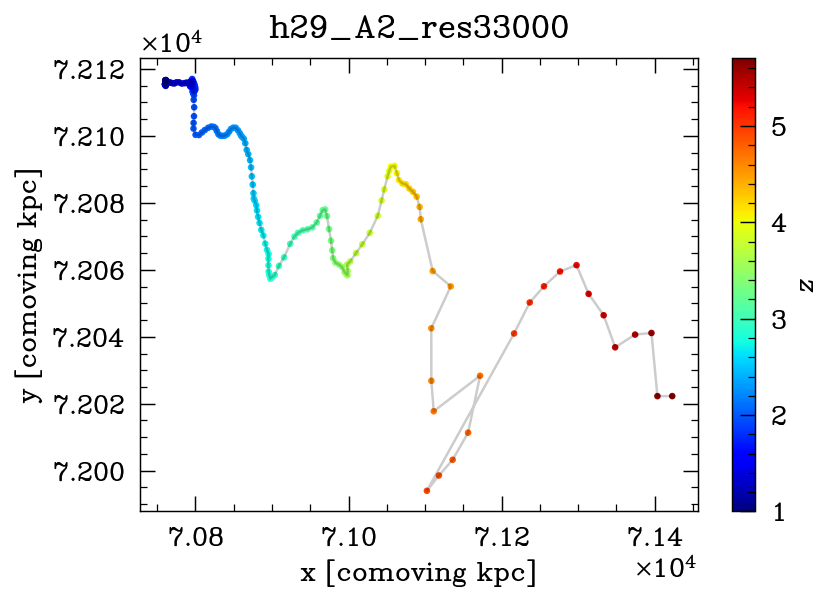

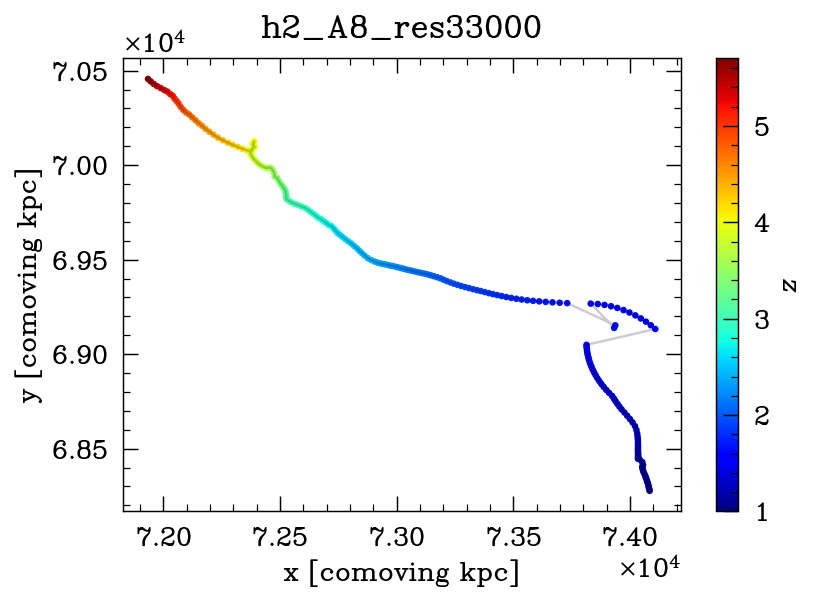

In [7]:
#14, 278
# AHF
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    
    ghi = get_halo_info_Rockstar(simdir, redshifts_snapshots(os.path.join(simdir, 'output')))
#     posCs = np.array([ghi[s][0]/sfs[s] for s in range(min(ghi),max(ghi)+1)])
    posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0]/sfs[s] for s in range(56,278)])
#     posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0] for s in range(67,278)])
    
    fig = plt.figure(dpi=150)
    
    plt.plot(posCs[:,0],posCs[:,1], alpha=0.2)
    plt.scatter(posCs[:,0],posCs[:,1], ec=None, c=(1/sfs-1)[56:278], s=10)
    plt.colorbar(label='$z$')
    plt.xlabel('x [comoving kpc]')
    plt.ylabel('y [comoving kpc]')
    plt.title(sim)

h206_A1_res33000


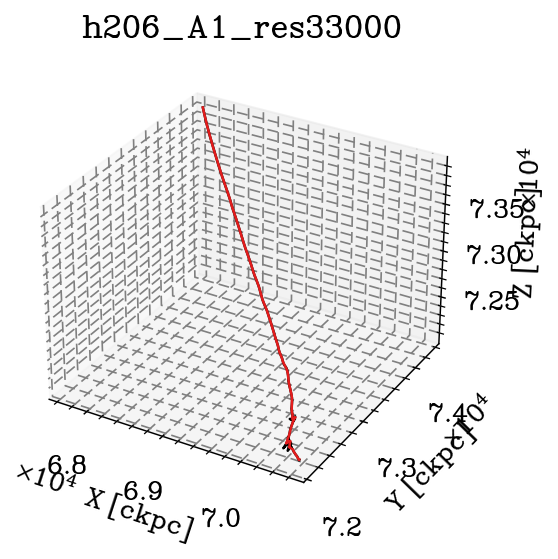

h113_A4_res33000


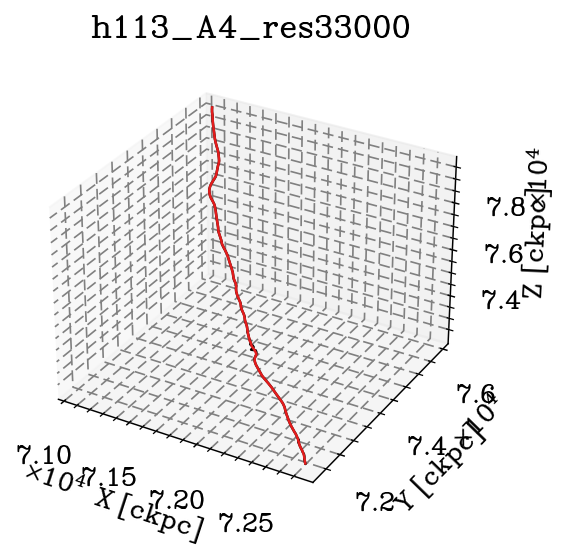

h29_A2_res33000


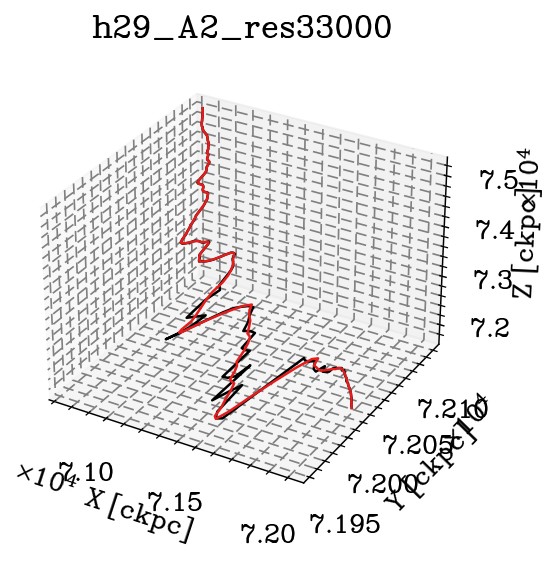

h2_A8_res33000


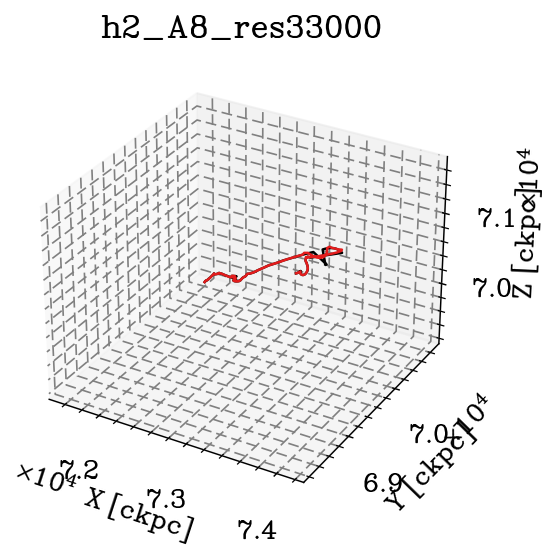

In [8]:
#14, 278
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    posCs = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[0]/sfs[s] for s in range(14,278)])
    
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '-', ms=1)
    
    posCs = smooth_center_trajectory(posCs, 10)
    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '-', ms=1)
    

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')
    plt.title(sim)

    plt.show()

In [6]:
import numpy as np
from scipy.ndimage import gaussian_filter1d

from scipy.signal import savgol_filter

def smooth_center_trajectory(coords, sigma=1.0):
    """
    Smooths a 2D array of halo center coordinates (shape: N x 3).

    Parameters
    ----------
    coords : np.ndarray
        Array of shape (N, 3), where each row is (x, y, z) at one snapshot.
    sigma : float, optional
        Smoothing length in units of snapshots (default is 1.0).

    Returns
    -------
    np.ndarray
        Smoothed coordinates, same shape as input (N, 3).
    """
#     smoothed_coords = np.zeros_like(coords)
#     for i in range(coords.shape[1]):  # Loop over x, y, z
#         smoothed_coords[:, i] = gaussian_filter1d(coords[:, i], sigma=sigma)
#     return smoothed_coords

    return savgol_filter(coords, window_length=9, polyorder=3, axis=0)



h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


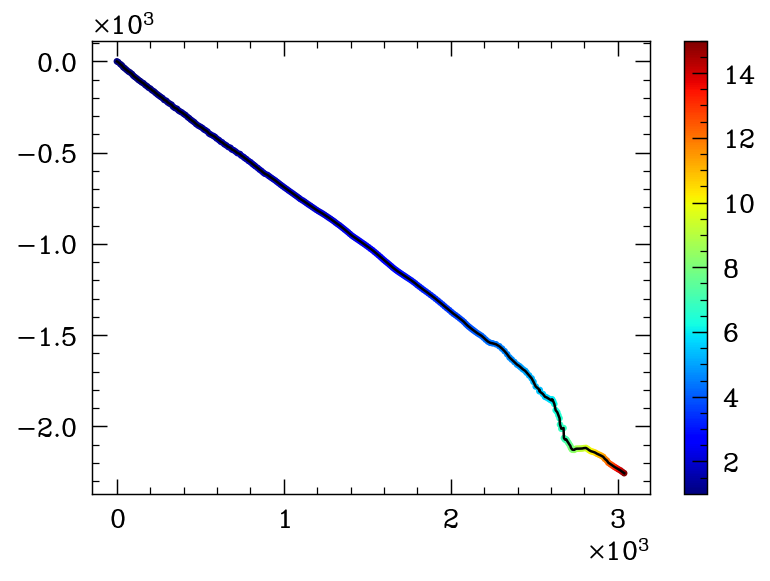

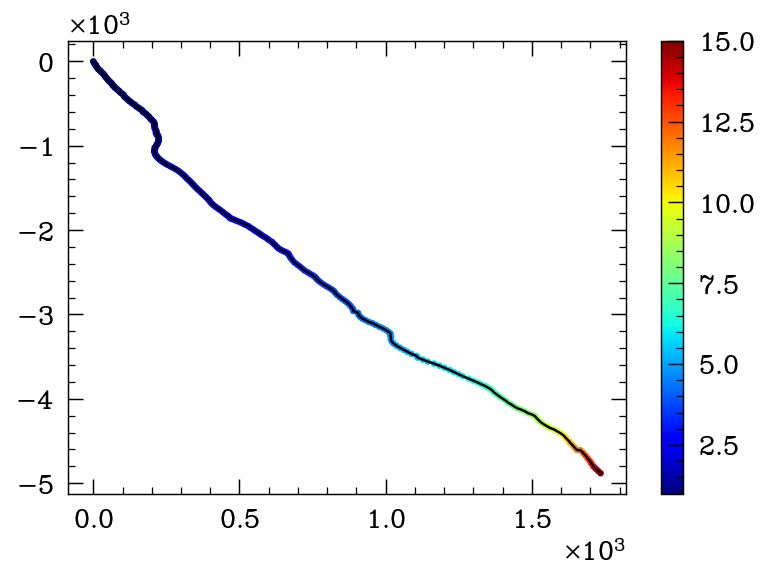

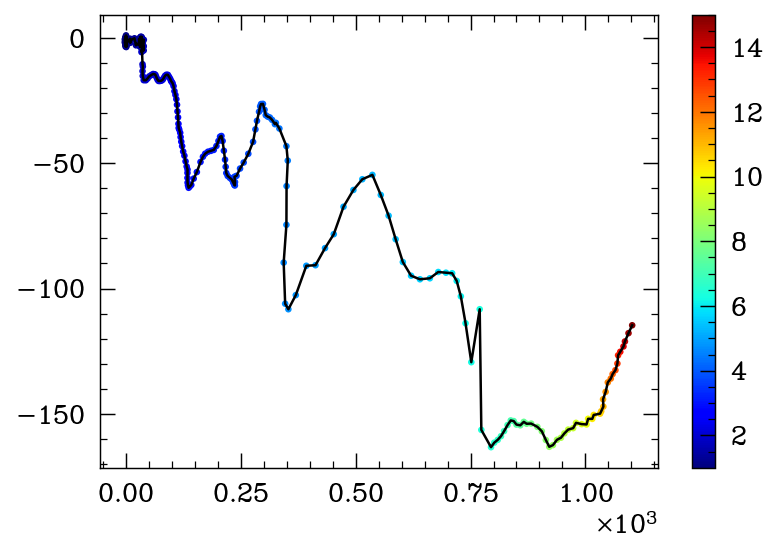

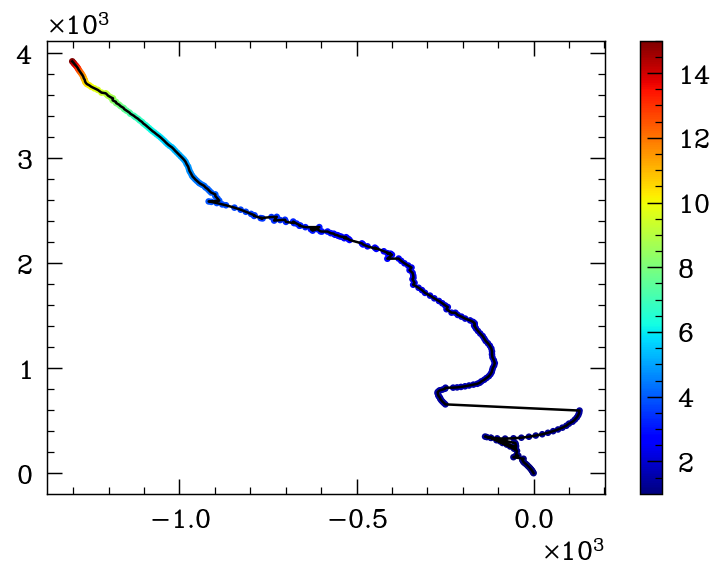

In [139]:
#14, 278
# Rockstar
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    
    ghi = get_halo_info_Rockstar(simdir, redshifts_snapshots(os.path.join(simdir, 'output')))
    posCs = np.array([ghi[s][0]/sfs[s] for s in range(min(ghi),max(ghi)+1)])
    posCs -= posCs[-1]
    
    fig = plt.figure(dpi=150)
    
    plt.plot(posCs[:,0],posCs[:,1])
    plt.scatter(posCs[:,0],posCs[:,1], ec=None, c=(1/sfs-1)[min(ghi):max(ghi)+1], s=10)
    plt.colorbar()
    
    posCs = smooth_center_trajectory(posCs, 10)
#     plt.plot(posCs[:,0],posCs[:,1],  ms=1)
    continue
    
    ax = fig.add_subplot(projection='3d')

    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '.', ms=1)
    
    posCs = smooth_center_trajectory(posCs, 10)
    ax.plot(posCs[:,0],posCs[:,1],posCs[:,2], '.', ms=1)

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')
    plt.title(sim)

    plt.show()


h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


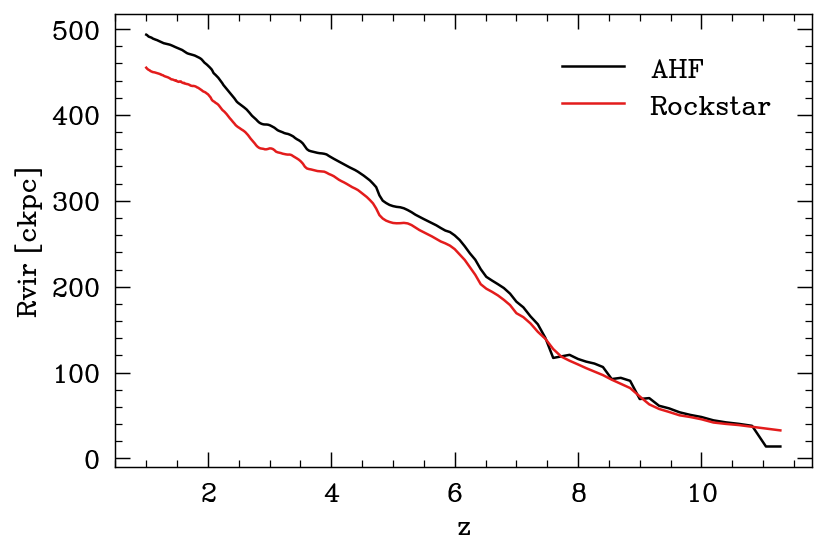

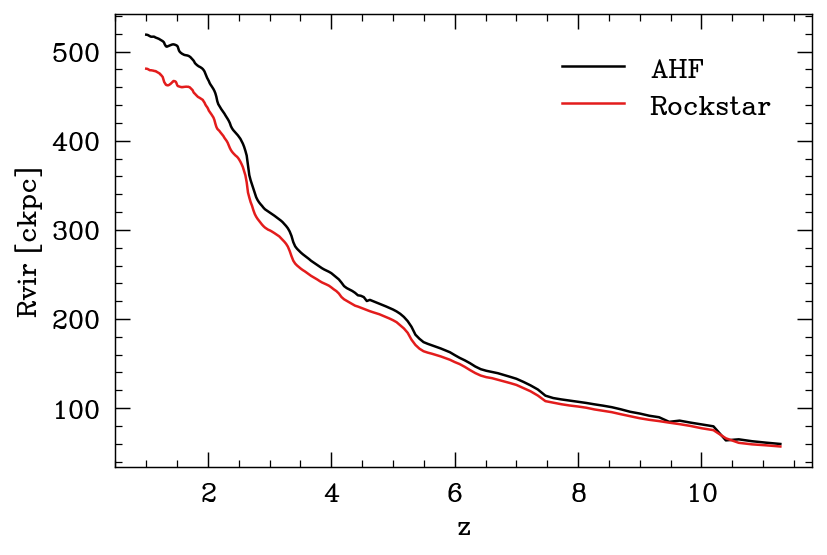

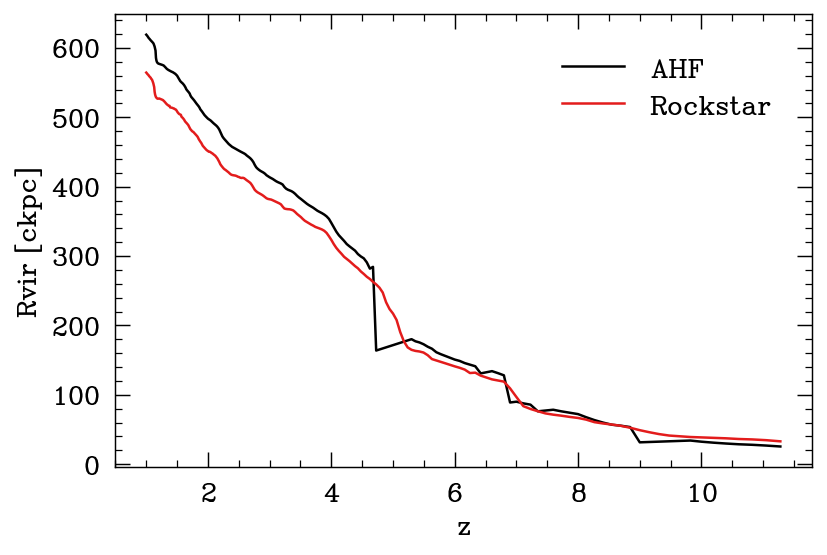

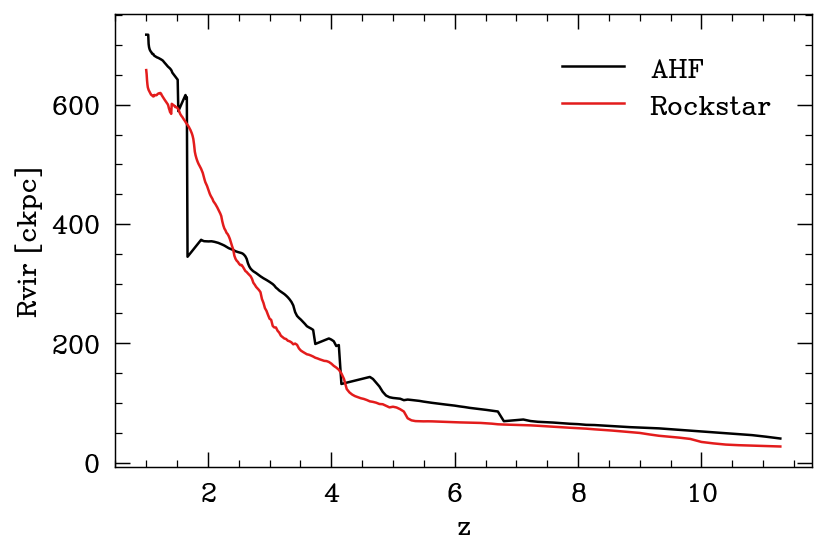

In [5]:
# compare Rockstar and AHF Rvir
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    fig = plt.figure(dpi=150)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    zs = np.array([scale_factor_to_redshift(s) for s in sfs])
    
    Rvir_AHF = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=[])[1]/sfs[s] for s in range(14,278)])
    plt.plot(zs[14:278], Rvir_AHF, label='AHF')
    
    ghi = get_halo_info_Rockstar(simdir, redshifts_snapshots(os.path.join(simdir, 'output')))
    Rvir_rockstar = [ghi[s][1] / sfs[s] for s in range(14,278)]
    plt.plot(zs[14:278], Rvir_rockstar, label='Rockstar')
    
    plt.legend()
    plt.xlabel('z')
    plt.ylabel('Rvir [ckpc]')

h206_A1_res33000
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir does not have units
Mvir doe

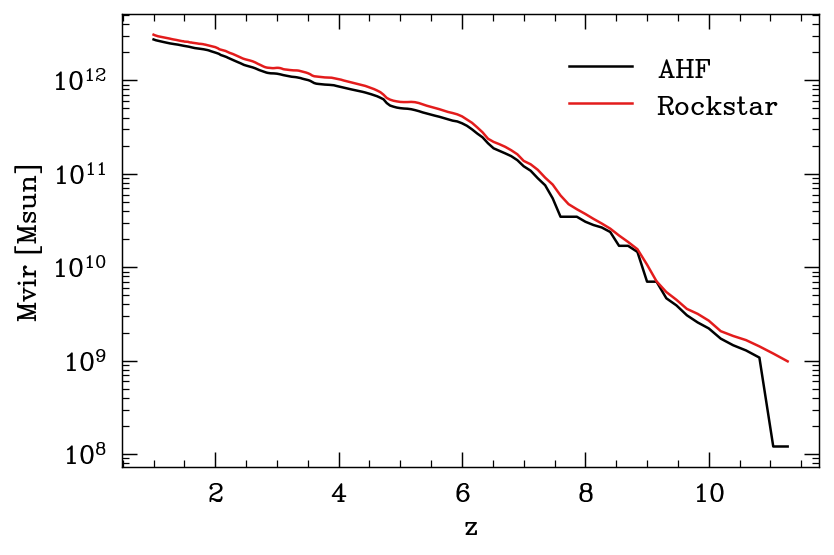

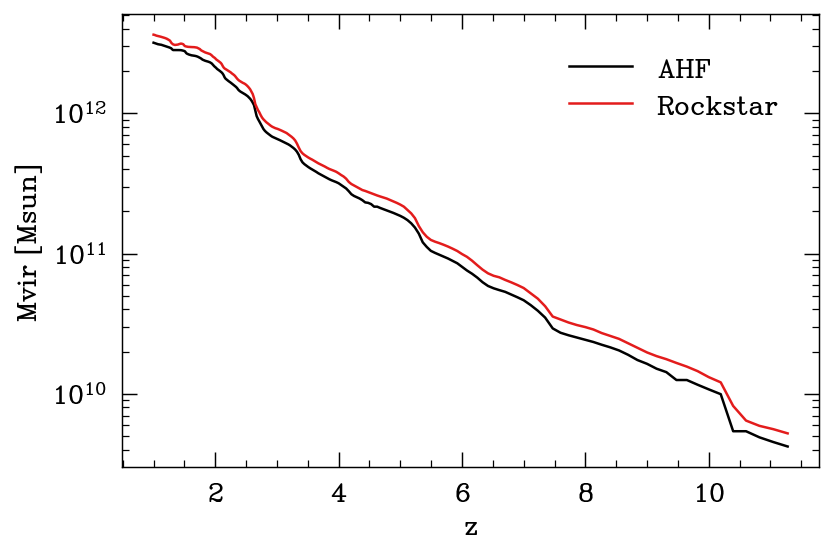

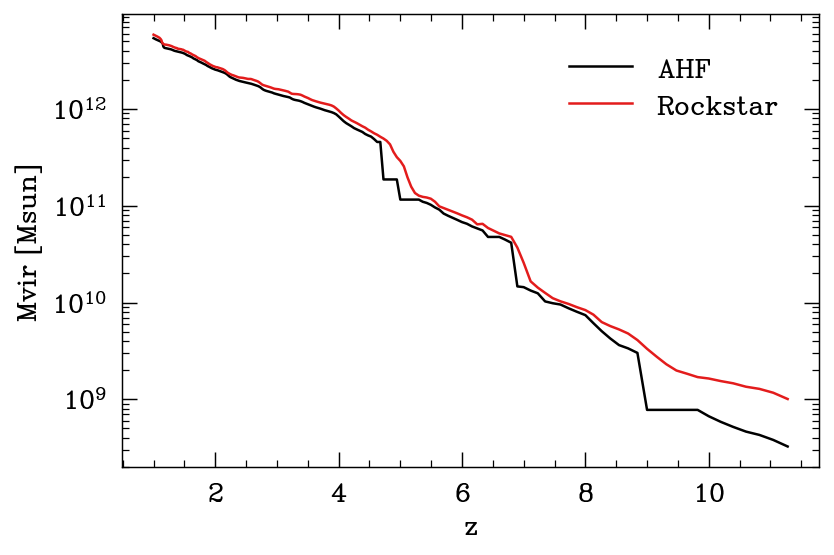

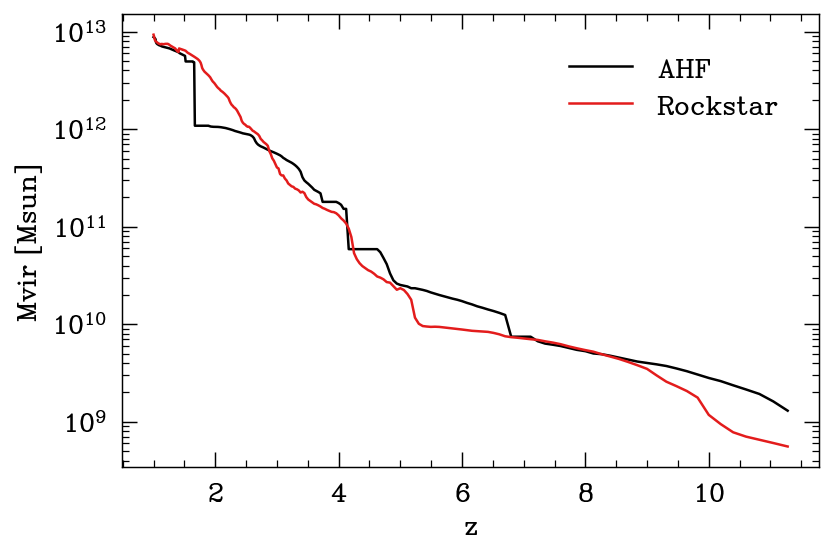

In [11]:
# compare Rockstar and AHF Mvir
for sim in ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']:
    print(sim)
    fig = plt.figure(dpi=150)
    simdir = f'/projects/b1026/snapshots/MassiveFIRE/{sim}'
    sfs = np.loadtxt(os.path.join(simdir, 'output', 'snapshot_scale-factors.txt'))
    zs = np.array([scale_factor_to_redshift(s) for s in sfs])
    
    Mvir_AHF = np.array([load_AHF('', s, hubble=0.697, ahf_path=os.path.join(simdir, 'halo', 'ahf'), extra_names_to_read=['Mvir'])[2] for s in range(14,278)])
    plt.plot(zs[14:278], Mvir_AHF, label='AHF')
    
    ghi = get_halo_info_Rockstar(simdir, redshifts_snapshots(os.path.join(simdir, 'output')))
    Mvir_rockstar = [ghi[s][2] for s in range(14,278)]
    plt.plot(zs[14:278], Mvir_rockstar, label='Rockstar')
    
    plt.legend()
    plt.xlabel('z')
    plt.ylabel('Mvir [Msun]')
    plt.yscale('log')

# ICV

In [35]:
# Generate VTK files for particle tracking

m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000'][1:]
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_5pctRvir_AHF/h113_2'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))
for simname in m13s:
    print(simname)
    for i,rnge in enumerate([(58, 114), (114, 160), (160, 202), (202, 242)]):
#         i=1; rnge=(36,147+1)
        i=2; rnge=(58,201+1)
        zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
        filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
        res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)

        Ts =    np.array([ p['Temperature'] for p in res ])
        coords= np.array([ p['Coordinates'] for p in res ])#np.array([ p['Coordinates0'] - p['posC'] for p in res ])
        xs =    coords[:,:,0]
        ys =    coords[:,:,1]
        zs =    coords[:,:,2]
        PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)
        everStars = np.any(np.isnan(Ts), axis=0)
        phases = np.where(Ts>10**5.5, 1, -1)
        
        Parallel(n_jobs=-1)(delayed(pointsToVTK)(f'../Paper2Plots/particles_{i}_snapnum{t:03}', np.array(xs[t]), np.array(ys[t]), np.array(zs[t]), data={'ParticleID':PIDs[t], 'phase':phases[t]}) for t in range(xs.shape[0]))

        break
    break

h113_A4_res33000


In [233]:
snapnums = np.arange(40,277)

In [ ]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000'][1:]
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/'

for simname in m13s:
    print(simname)
    i = 0
    rnge = (40, 277)#(114, 160)
    zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
    filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
    res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)

    times = np.array([ p['TimeGyr'] for p in res ])
    sfs =   np.array([ p['ScaleFactor'] for p in res ])
    Rs =    np.array([ p['r_scaled']*p['Rvir']/p['ScaleFactor'] for p in res ]) #This is comoving
    Ts =    np.array([ p['Temperature'] for p in res ])
    nHs =   np.array([ p['nH'] for p in res ])
    jaligns=np.array([ p['jalign'] for p in res ])

    vphis=np.array([ p['vphi'] for p in res ])
    vcs=np.array([ p['vc'] for p in res ])
    
    velocities = np.array([ p['Velocities'] for p in res ])
    coords= np.array([ p['Coordinates'] for p in res ])#np.array([ p['Coordinates0'] - p['posC'] for p in res ])
    xs =    coords[:,:,0]
    ys =    coords[:,:,1]
    zs =    coords[:,:,2]
    rscaled=np.array([ p['r_scaled'] for p in res ])
    js =    np.array([ p['j'] for p in res ])
    rgals = np.array([ p['Rgal'] for p in res ])
    sfs =   np.array([ p['ScaleFactor'] for p in res ])
    rvirs = np.array([ p['Rvir'] for p in res ])
    rgals_ckpc = rgals * rvirs / sfs
#     if 'ParticleIDs' in res[-1]: PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)
    PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)
    masses=np.array([ p['Masses'] for p in res ])

    tacc_js = times[np.argmax(rscaled < 0.05, axis=0)]
    break
    ridx = np.ones(Rs.shape[1], dtype=bool)
    ridx = inrange(tacc_js - times[0], (0.4,0.6))
#         np.random.seed(0)
#         ridx = np.random.randint(0, Rs.shape[1], 5000)
    plottracks2(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], js[:,ridx], vphis[:,ridx], vcs[:,ridx], tacc_js[ridx])
#         plottracks2(res, times, Rs, Ts, nHs, jaligns, js, vphis, vcs, tacc_js)
    plt.gcf().suptitle(simname + f'\nz = {zrnge[1]:.1f} - {zrnge[0]:.1f}\n{Rs[:,ridx].shape[1]:0.1e} particles')
#         plt.gca().text(.05, -.5, f'{Rs.shape[1]} particles')
#         plt.savefig(f'../Paper2Plots/alltaccjs_{simname}_{i}.pdf')

#         if 'h113' in simname and i<3:
#             for t in range(xs.shape[0]):
#                 pointsToVTK(f'../Paper2Plots/particles_{i}_snapnum{t:03}', np.array(xs[t]), np.array(ys[t]), np.array(zs[t]), data={'ParticleIDs':PIDs[t]})

#         plt.close('all')

h113_A4_res33000


In [41]:
ridx = inrange(rscaled[0,:], (0.1,1))&(rscaled[-1,:]<0.05)&(np.isnan(nHs[-1,:])|(nHs[-1,:]>0.13))&(~np.isnan(nHs[0,:]))#&inrange(tacc_js - times[0], (0.4,0.6))#&(~np.any(np.isnan(Ts), axis=0))#&inrange(tacc_js - 2.5, (-0.1,0.1))

In [60]:
simname = 'h113_A4_res33000'
rot_tf = load_all_rotations(simname, range(40, 277))
coords_derot = Parallel(n_jobs=-1, verbose=False)(delayed(makecoords_derot)(coords[t], rot_tf[t]) for t in range(len(rot_tf)))
coords_derot = np.array(coords_derot)

velocities_derot = Parallel(n_jobs=-1, verbose=False)(delayed(makecoords_derot)(velocities[t], rot_tf[t]) for t in range(len(rot_tf)))
velocities_derot = np.array(velocities_derot)

In [74]:
idxi, idxf = 114-40, 159-40 #202-40, 241-40 #
ridx = inrange(rscaled[idxi,:], (0.1,1))\
&(rscaled[idxf,:]<0.05)\
&(np.isnan(nHs[idxf,:])|(nHs[idxf,:]>0.13))\
&(~np.isnan(nHs[idxi,:]))
tacc_js_reduced = times[idxi:idxf+1][np.argmax(rscaled[idxi:idxf+1, ridx] < 0.05, axis=0)]

In [77]:
with open(f'/projects/b1026/isultan/data/rotcache/rot_{simname}_{snapnums[idxf]}.pkl', 'rb') as f: 
    rot_new = pickle.load(f)

coords_newrot = rot_new.apply(coords_derot[idxi:idxf+1, ridx].reshape(-1,3)).reshape(coords_derot[idxi:idxf+1, ridx].shape)
# velocities_newrot = rot_new.apply(velocities_derot[idxi:idxf+1, ridx].reshape(-1,3)).reshape(velocities_derot[idxi:idxf+1, ridx].shape)


# masses_reduced = masses[idxi:idxf+1, ridx]
# js_newrot = (np.cross(coords_newrot.reshape(-1,3), velocities_newrot.reshape(-1,3)) * masses_reduced.reshape(-1)[:, None]).reshape(js[idxi:idxf+1, ridx].shape)
# jaligns_newrot = (js_newrot.reshape(-1,3)[:,2] / np.linalg.norm(js_newrot.reshape(-1,3), axis=1)).reshape(jaligns[idxi:idxf+1, ridx].shape)

In [78]:
ridx_random = np.random.randint(0, coords_newrot.shape[1], 1000)

In [80]:
Ts =    np.array([ p['Temperature'] for p in res ])
PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)

In [84]:
phases = np.where(Ts>10**5., 1, -1)
i=1

for t in range(coords_newrot.shape[0]):
    pointsToVTK(f'../Paper2Plots/particles_{i}_snapnum{t:03}', np.array(coords_newrot[t, ridx_random, 0]), np.array(coords_newrot[t, ridx_random,1]), np.array(coords_newrot[t, ridx_random, 2]), data={'ParticleID':np.array(PIDs[t, ridx][ridx_random]), 'phase':phases[t, ridx][ridx_random]})

In [82]:
phases = np.where(Ts>10**5., 1, -1)
i=1
Parallel(n_jobs=-1)(delayed(pointsToVTK)(f'../Paper2Plots/particles_{i}_snapnum{t:03}', np.array(coords_newrot[t, ridx_random, 0]), np.array(coords_newrot[t, ridx_random,1]), np.array(coords_newrot[t, ridx_random, 2]), data={'ParticleID':np.array(PIDs[t, ridx][ridx_random]), 'phase':phases[t, ridx][ridx_random]}) for t in range(coords_newrot.shape[0]))

OSError: [Errno 12] Cannot allocate memory

In [203]:
vphis_newrot = compute_vphi(velocities_newrot.reshape(-1,3), coords_newrot.reshape(-1,3)).reshape(vphis[idxi:idxf+1, ridx].shape)

In [207]:
vphis_newrot = iht.spherical_velocities(velocities_newrot.reshape(-1,3), coords_newrot.reshape(-1,3))[2].reshape(vphis[idxi:idxf+1, ridx].shape)

In [208]:
vphis_newrot_gas = np.where(~np.isnan(Ts[idxi:idxf+1,ridx]), vphis_newrot, np.nan)

In [160]:
def test_spherical_velocities(spherical_velocities):
    # Test 1: Radial motion (v aligned with r)
    r = np.array([[1, 0, 0]])
    v = np.array([[1, 0, 0]])
    vrad, vtheta, vphi = spherical_velocities(v, r)
    assert np.allclose(vrad, [1]), "Test 1 failed: vrad should be 1"
    assert np.allclose(vtheta, [0]), "Test 1 failed: vtheta should be 0"
    assert np.allclose(vphi, [0]), "Test 1 failed: vphi should be 0"
    
    # Test 2: Purely tangential motion in xy-plane
    r = np.array([[1, 0, 0]])
    v = np.array([[0, 1, 0]])
    vrad, vtheta, vphi = spherical_velocities(v, r)
    assert np.allclose(vrad, [0]), "Test 2 failed: vrad should be 0"
    assert np.allclose(vtheta, [0]), "Test 2 failed: vtheta should be 0"
    assert np.allclose(vphi, [1]), "Test 2 failed: vphi should be 1"
    
    # Test 3: General case (nontrivial values for all components)
    r = np.array([[1, 1, 1]])
    v = np.array([[1, 2, 3]])
    vrad, vtheta, vphi = spherical_velocities(v, r)
    print(f"Test 3 results: vrad={vrad}, vtheta={vtheta}, vphi={vphi}")
    
    # Test 4: Multiple particles
    r = np.array([[1, 0, 0], [0, 1, 0]])
    v = np.array([[0, 1, 0], [-1, 0, 0]])
    vrad, vtheta, vphi = spherical_velocities(v, r)
    assert vrad.shape == (2,), "Test 4 failed: vrad shape incorrect"
    assert vtheta.shape == (2,), "Test 4 failed: vtheta shape incorrect"
    assert vphi.shape == (2,), "Test 4 failed: vphi shape incorrect"
    
    print("All tests passed!")

def test_compute_vphi(compute_vphi):
    # Test 1: Purely tangential motion in xy-plane
    coords = np.array([[1, 0, 0]])
    v = np.array([[0, 1, 0]])
    vphi = compute_vphi(v, coords)
    assert np.allclose(vphi, [1]), "Test 1 failed: vphi should be 1"
    
    # Test 2: Purely radial motion (should give vphi = 0)
    coords = np.array([[1, 0, 0]])
    v = np.array([[1, 0, 0]])
    vphi = compute_vphi(v, coords)
    assert np.allclose(vphi, [0]), "Test 2 failed: vphi should be 0"
    
    # Test 3: General case
    coords = np.array([[1, 1, 0]])
    v = np.array([[1, 2, 0]])
    vphi = compute_vphi(v, coords)
    expected_vphi = (coords[0,0] * v[0,1] - coords[0,1] * v[0,0]) / (coords[0,0]**2 + coords[0,1]**2)
    assert np.allclose(vphi, expected_vphi), f"Test 3 failed: vphi should be {expected_vphi}, got {vphi}"
    
    # Test 4: Multiple particles
    coords = np.array([[1, 0, 0], [0, 1, 0]])
    v = np.array([[0, 1, 0], [-1, 0, 0]])
    vphi = compute_vphi(v, coords)
    assert vphi.shape == (2,), "Test 4 failed: vphi shape incorrect"
    
    print("All tests passed!")


In [197]:
def spherical_velocities(v, r):
    '''Given velocity v and position r cartesian arrays, calculates vrad, vtheta, vphi (each in same units as v).
    For N particles, v is Nx3 array of cartesian particle velocities, and r is an Nx3 array of cartesian particle positions.
    `v` and `r` must be defined relative to the center of the halo before calling this function.
    '''
    x, y, z = r[:,0], r[:,1], r[:,2]
    vx, vy, vz = v[:,0], v[:,1], v[:,2]

    r_mag = np.sqrt(x**2 + y**2 + z**2)  # Spherical radius
    rxy = np.sqrt(x**2 + y**2)  # Projection onto xy-plane
    
    # Spherical angles
    theta = np.arctan2(rxy, z)  # Polar angle (0 at z-axis)
    phi = np.arctan2(y, x)  # Azimuthal angle
    
    # Compute velocity components
    vrad = (x * vx + y * vy + z * vz) / r_mag  # Radial velocity
    
    vtheta = (z * (x * vx + y * vy) - rxy**2 * vz) / (r_mag * rxy)  # Polar velocity
    vphi = (x * vy - y * vx) / rxy  # Azimuthal velocity
    
    # Handle edge cases where rxy = 0 (along z-axis)
    vphi[rxy == 0] = 0.0  # No azimuthal component at poles
    vtheta[r_mag == 0] = 0.0  # Avoid NaN when r=0

    return vrad, vtheta, vphi

In [198]:
iht.spherical_velocities(np.array([[1, 2, 3]]), np.array([[1, -1, 34]]))

(array([2.96802185]), array([-0.83117163]), array([2.12132034]))

In [199]:
spherical_velocities(np.array([[1, 2, 3]]), np.array([[1, -1, 34]]))

(array([2.96802185]), array([-0.83117163]), array([2.12132034]))

In [161]:
test_compute_vphi(lambda v,x: iht.spherical_velocities(v,x)[2])

AssertionError: Test 3 failed: vphi should be 0.5, got [0.70710678]

In [163]:
test_compute_vphi(compute_vphi)

All tests passed!


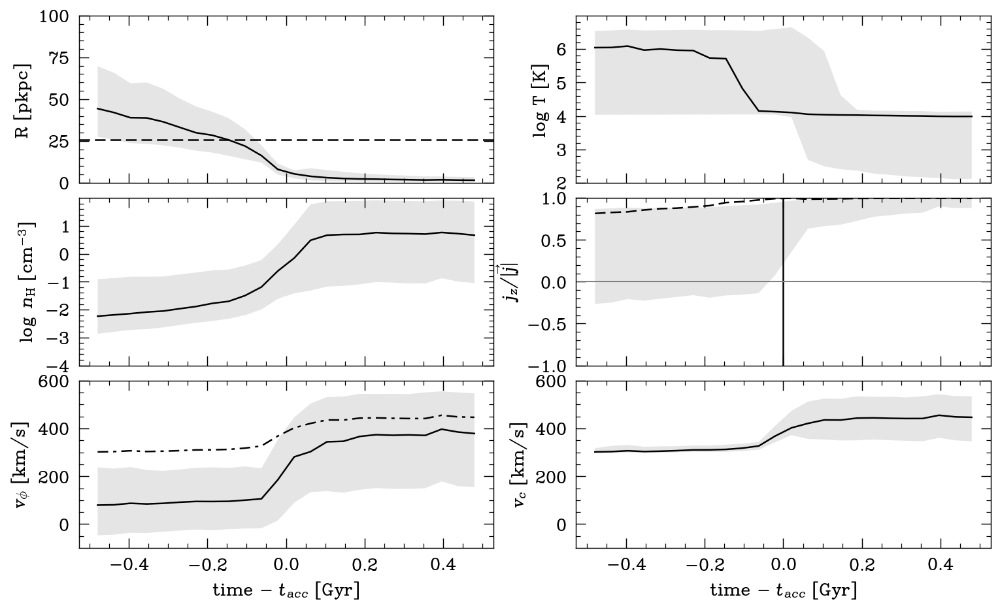

In [209]:
plottracks2(res, 
            times[idxi:idxf+1], 
            Rs[idxi:idxf+1,ridx], 
            Ts[idxi:idxf+1,ridx], 
            nHs[idxi:idxf+1,ridx], 
            jaligns_newrot,#jaligns[idxi:idxf+1,ridx],
            js_newrot,#js[idxi:idxf+1,ridx], 
            vphis_newrot_gas, 
            vcs[idxi:idxf+1,ridx], 
            tacc_js_reduced,
            sfs[idxi:idxf+1])

In [51]:
vphis_test = compute_vphi(velocities.reshape(-1,3), coords.reshape(-1,3)).reshape(vphis.shape)

In [53]:
vphis_test[np.isnan(Ts)] = np.nan

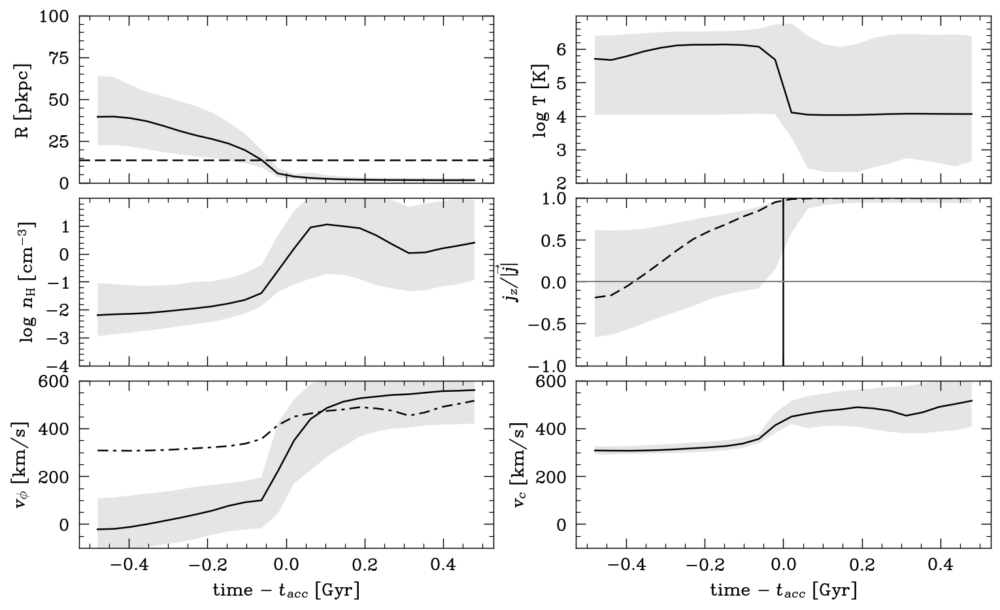

In [15]:
plottracks2(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], js[:,ridx], vphis[:,ridx], vcs[:,ridx], tacc_js[ridx])

In [15]:
ridx = np.flatnonzero( inrange(tacc_js - 2.5, (-0.1,0.1)) )
# ridx = ridx[~np.isnan(nHs[-1,ridx])]#ridx[nHs[0,ridx]>0.13]

In [72]:
import pickle
import os

def load_all_rotations(simname, snapnums):
    rots = []
    for snap in snapnums:
        filepath = f'/projects/b1026/isultan/data/rotcache/rot_{os.path.basename(os.path.normpath(simname))}_{snap}.pkl'
        with open(filepath, 'rb') as f:
            rots.append(pickle.load(f))
    return rots
rot_tf = load_all_rotations(simname, range(40, 277))

In [97]:
with open(f'/projects/b1026/isultan/data/rotcache/rot_{os.path.basename(os.path.normpath("h206_A1_res33000"))}_{159}.pkl', 'rb') as f: rot_new = pickle.load(f)

In [77]:
coords_derot = np.array([rot_tf[t].inv().apply(coords[t]) for t in range(len(rot_tf))])
velocities_derot = np.array([rot_tf[t].inv().apply(velocities[t]) for t in range(len(rot_tf))])

In [ ]:
coords_newrot = rot_new.apply(coords_derot.reshape(-1,3)).reshape(coords.shape)
velocities_newrot = rot_new.apply(velocities_derot.reshape(-1,3)).reshape(velocities.shape)

In [25]:
masses=np.array([ p['Masses'] for p in res ])

js_newrot = (np.cross(coords_newrot.reshape(-1,3), velocities_newrot.reshape(-1,3)) * masses.reshape(-1)[:, None]).reshape(js.shape)
jaligns_newrot = (js_newrot.reshape(-1,3)[:,2] / np.linalg.norm(js_newrot.reshape(-1,3), axis=1)).reshape(jaligns.shape)

In [200]:
import numba
@numba.njit
def compute_vphi(v, coords):
    rxy2 = np.sqrt( coords[:,0]**2 + coords[:,1]**2 )
    return (coords[:,0] * v[:,1] - coords[:,1] * v[:,0]) / rxy2

In [27]:
vphis_newrot_eff = compute_vphi(velocities_newrot.reshape(-1,3), coords_newrot.reshape(-1,3))

In [29]:
vphis_newrot = vphis_newrot_eff.reshape(vphis.shape)

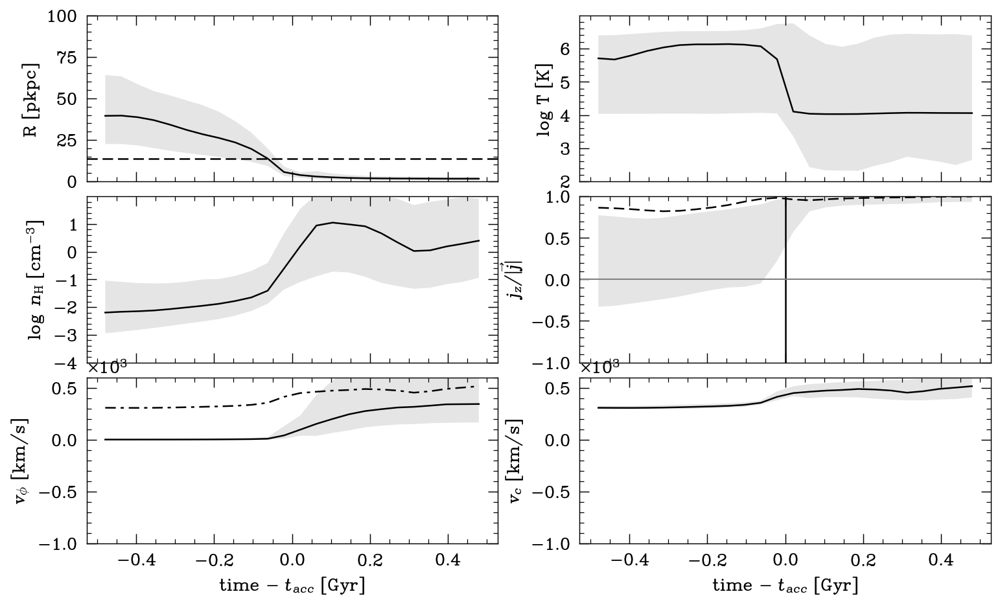

In [32]:
plottracks2(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns_newrot[:,ridx], js_newrot[:,ridx], vphis_newrot[:,ridx], vcs[:,ridx], tacc_js[ridx])

In [117]:
z_to_t = dict(zip(*np.loadtxt('/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000/output/snapshot_times.txt')[:,2:4].T))

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


Text(0.5, 1.0, 'Post-ICV')

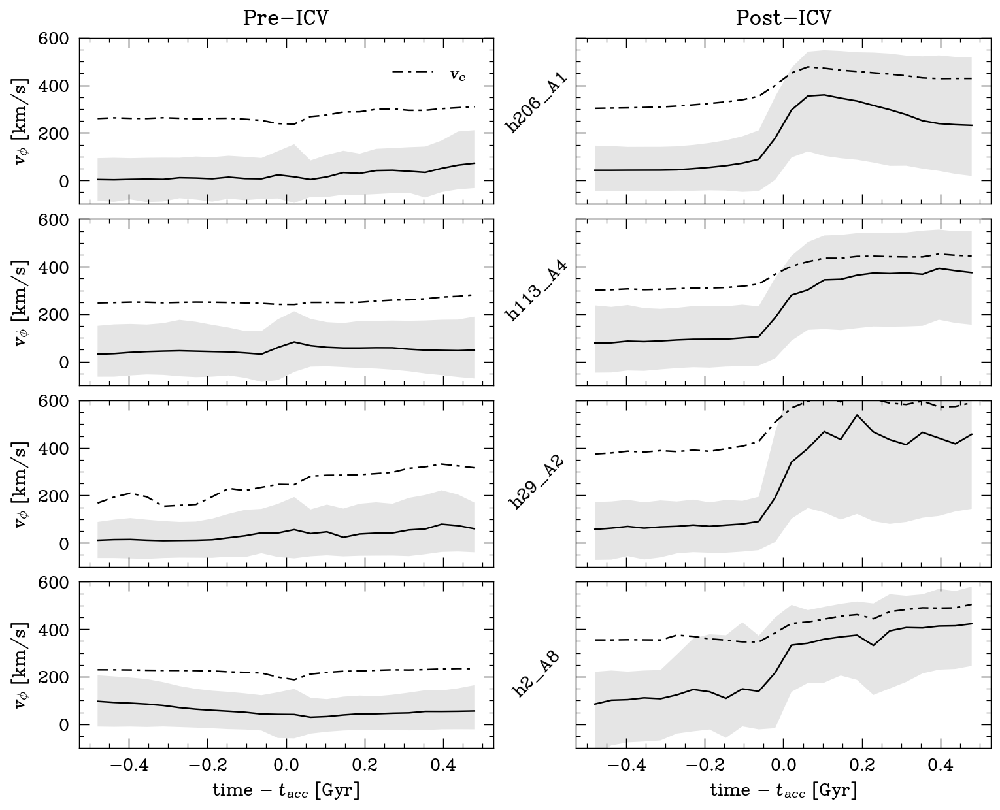

In [138]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']
ICVranges = [(0,1), (1,2), (0,2), (1,3)]
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']
datadir = '/projects/b1026/isultan/data/particlescache_5pctRvir_AHF'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))

fig, axes = plt.subplots(4, 2, sharex=True, sharey=True, gridspec_kw={'wspace': .2, 'hspace':.09}, figsize=[4.8*2.5,4.8*2], dpi=150, facecolor='w', squeeze=False)
for sidx,simname in enumerate(m13s):
    print(simname)
    fig.text(0.515, (4-sidx)/5-.02, simname.split('_res')[0], ha='center', rotation=45)
    for i,rngeidx in enumerate(ICVranges[sidx]):
        rnge = [(58, 114), (114, 160), (160, 202), (202, 242)][rngeidx]
        zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
        filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
        res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)

        times = np.array([ p['TimeGyr'] for p in res ])
        vphis=np.array([ p['vphi'] for p in res ])
        vcs=np.array([ p['vc'] for p in res ])
        rscaled=np.array([ p['r_scaled'] for p in res ])
        tacc_js = np.array([ (list(times[rscaled[:,i] < 0.05]) or [np.nan])[0] for i in range(rscaled.shape[1]) ])
        
        ridx = np.ones(Rs.shape[1], dtype=bool)
#         ridx = inrange(tacc_js - times[0], (0.4,0.6))
        ridx = np.random.randint(0, rscaled.shape[1], 50000)
        plottracks2_vphi(res, times, vphis[:,ridx], vcs[:,ridx], tacc_js[ridx], axes[sidx,i])

axes[-1,0].set_xlabel(r'time - $t_{acc}$ [Gyr]')
axes[-1,1].set_xlabel(r'time - $t_{acc}$ [Gyr]')
for ax in axes[:,0]: ax.set_ylabel(r'$v_{\phi}$ [km/s]')
axes[0,0].legend()
axes[0,0].set_title('Pre-ICV')
axes[0,1].set_title('Post-ICV')
# axes[2,1].set_ylabel(r'$v_{c}$ [km/s]')

In [4]:
simdir = '/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000'
p_tf, rot_tf = load(simdir, 98, returnrot=True)
p_ti = load(simdir, 41, rot=rot_tf)

Mvir does not have units
Mvir does not have units


In [5]:
ParticleIDs = selectparticles_zach(p_tf, p_ti)

In [ ]:
sim = 'h113_A4_res33000'
# process_sim(f'/projects/b1026/snapshots/MassiveFIRE/{sim}', sim, s_tf=201, s_ti=160, s_tfout=201, s_tiout=58, n_jobs=20)
process_sim(f'/projects/b1026/snapshots/MassiveFIRE/{sim}', sim, s_tf=159, s_ti=114, s_tfout=159, s_tiout=36, n_jobs=-1)

## h/r 

In [68]:
snapnums = np.arange(40,277)

In [69]:
def makeindices_200Myr(times):
    indices_200Myr = []

    idxi = 0

    while idxi < len(times)-1:
        tf = times[idxi] + 0.2
        idxf = np.argmin(np.abs(times - tf))
        dt = times[idxf] - times[idxi]
        if dt < 0.1: break
        indices_200Myr.append((idxi, idxf))

        idxi = idxf+1
    return indices_200Myr

In [70]:
zICVs = {
    'h206_A1_res33000': 3.6,
    'h113_A4_res33000': 2.2,
    'h29_A2_res33000': 2.7,
    'h2_A8_res33000': 1.7

}
snapICVs = {k:np.argmin(np.abs(np.loadtxt('/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000/output/snapshot_times.txt')[:,2] - zICVs[k])) for k in zICVs.keys()}

In [71]:
def makehr(simname, indices_200Myr, rscaled, nHs, snapnums, coords_derot, snapICVs):
    colors = plt.cm.Blues(np.linspace(0.2,1,len(indices_200Myr)))
    for c, (idxi, idxf) in zip(colors, indices_200Myr):
        ridx = (rscaled[idxi,:]>0.05)&(rscaled[idxf,:]<0.05)&(np.isnan(nHs[idxf,:])|(nHs[idxf,:]>0.13))&(~np.isnan(nHs[idxi,:]))

        idxmid = (idxi+idxf)//2
        with open(f'/projects/b1026/isultan/data/rotcache/rot_{simname}_{snapnums[idxmid]}.pkl', 'rb') as f: rot_new = pickle.load(f)

        coords_newrot = rot_new.apply(coords_derot[idxi:idxf+1, ridx].reshape(-1,3)).reshape(coords_derot[idxi:idxf+1, ridx].shape)

        Rspkpc = (coords_newrot[-1,:,0]**2 + coords_newrot[-1,:,1]**2 + coords_newrot[-1,:,2]**2)**0.5
        costheta = coords_newrot[-1,:,2] / Rspkpc
        cnts, bins = np.histogram( costheta, bins=100, density=True )
        
        isICVbin = inrange(snapICVs[simname], (idxi, idxf))
#         c = 'r' if inrange(snapICVs[simname], (idxi, idxf)) else c
        ls = '-' if isICVbin else None
        zorder = 100 if isICVbin else None
        lw = 4 if isICVbin else None
        label = f'z={zICVs[simname]}' if isICVbin else None

        plt.plot(bins[:-1], cnts, c=c, zorder=zorder, lw=lw, label=label, ls=ls)
    plt.legend()
    plt.xlabel('z/r')
    plt.ylabel('PDF')
    plt.title(simname)

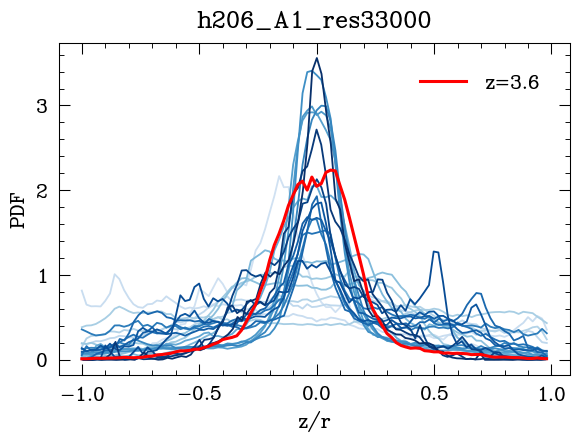

In [138]:
makehr(simname, indices_200Myr, rscaled, nHs, snapnums, coords_derot, snapICVs)

In [67]:
def makecoords_derot(coords, rot):
    return rot.inv().apply(coords)

In [60]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']
datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/'
res_all = {}

for simname in m13s:
    print(simname)
    i = 0
    rnge = (40, 277)
    zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
    filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
    res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)
    res_all[simname] = res

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


h206_A1_res33000


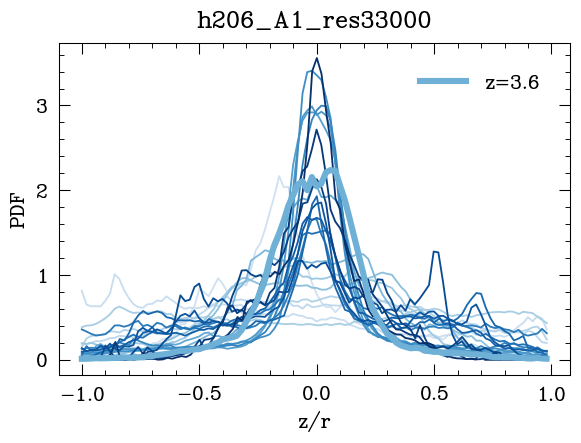

In [73]:
m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']
datadir = '/projects/b1026/isultan/data/particlescache_Rcirc/'

for simname in m13s:
    print(simname)
    i = 0
    rnge = (40, 277)
    zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
    filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
#     res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)
    res = res_all[simname]
    times = np.array([ p['TimeGyr'] for p in res ])
    nHs =   np.array([ p['nH'] for p in res ])
    coords= np.array([ p['Coordinates'] for p in res ])#np.array([ p['Coordinates0'] - p['posC'] for p in res ])
    rscaled=np.array([ p['r_scaled'] for p in res ]) 
    
    rot_tf = load_all_rotations(simname, range(40, 277))
    coords_derot = Parallel(n_jobs=-1, verbose=False)(delayed(makecoords_derot)(coords[t], rot_tf[t]) for t in range(len(rot_tf)))
    coords_derot = np.array(coords_derot)
    
    plt.figure()
    makehr(simname, makeindices_200Myr(times), rscaled, nHs, snapnums, coords_derot, snapICVs)
#     plt.savefig(f'../Paper2Plots/hr_{simname}_{i}.pdf')
    break

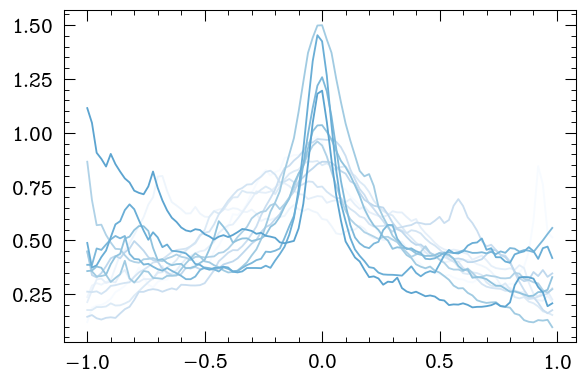

In [83]:
colors = plt.cm.Blues(np.linspace(0,1,len(indices_200Myr)))
for c, (idxi, idxf) in zip(colors, indices_200Myr[:-10]):
    ridx = \
    inrange(rscaled[idxi,:], (0.1,1))&\
    (rscaled[idxf,:]<0.05)
#     &(np.isnan(nHs[idxf,:])|(nHs[idxf,:]>0.13))&\
#     (~np.isnan(nHs[idxi,:]))

    Rspkpc = (xs[idxi:idxf+1, ridx]**2 + ys[idxi:idxf+1, ridx]**2 + zs[idxi:idxf+1, ridx]**2)**0.5
    costheta = zs[idxi:idxf+1, ridx] / Rspkpc
    cnts, bins = np.histogram( costheta, bins=100, density=True )
    plt.plot(bins[:-1], cnts, label=f'z={zrnge[1]:.1f} - {zrnge[0]:.1f}', c=c)

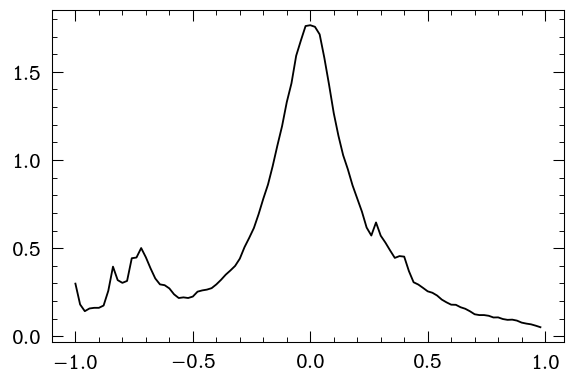

In [48]:
ridx = \
inrange(rscaled[114-40,:], (0.1,1))&\
(rscaled[159-40,:]<0.05)&\
(np.isnan(nHs[159-40,:])|(nHs[159-40,:]>0.13))&\
(~np.isnan(nHs[114-40,:]))#&inrange(tacc_js - times[0], (0.4,0.6))#&(~np.any(np.isnan(Ts), axis=0))#&inrange(tacc_js - 2.5, (-0.1,0.1))

#114-40:160-40
Rspkpc = (xs[97, ridx]**2 + ys[97, ridx]**2 + zs[97, ridx]**2)**0.5
costheta = zs[97, ridx] / Rspkpc
cnts, bins = np.histogram( costheta, bins=100, density=True )
plt.plot(bins[:-1], cnts, label=f'z={zrnge[1]:.1f} - {zrnge[0]:.1f}')

h206_A1_res33000
h113_A4_res33000
h29_A2_res33000
h2_A8_res33000


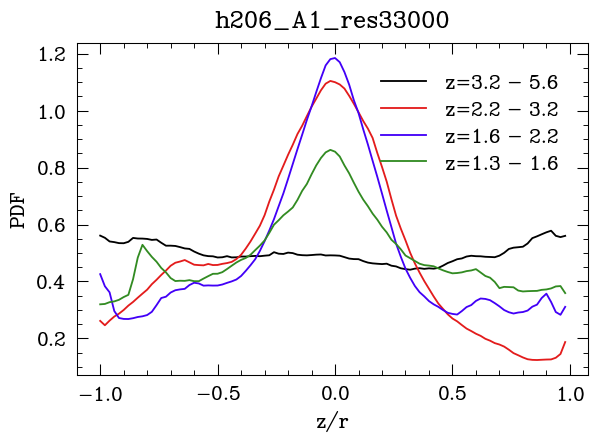

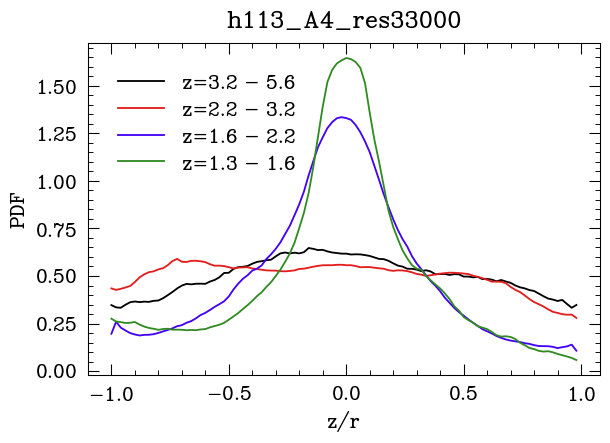

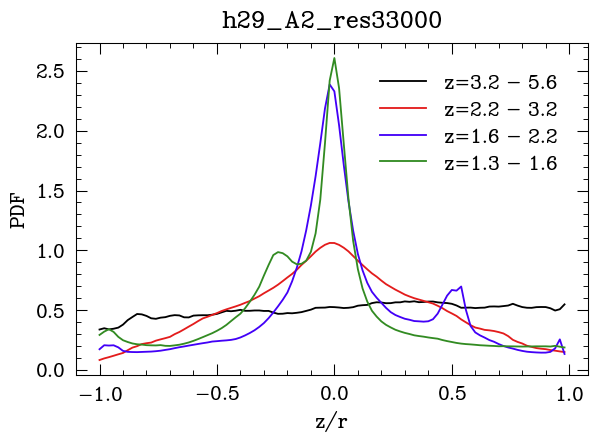

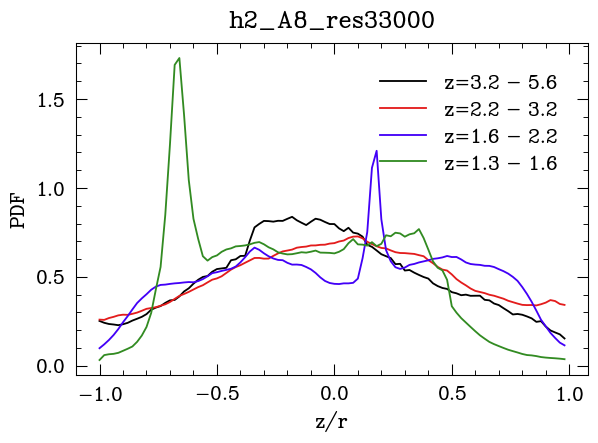

In [261]:
# z/r distributions

m13s = ['h206_A1_res33000', 'h113_A4_res33000', 'h29_A2_res33000', 'h2_A8_res33000']
m12s = ['m12i_r7100', 'm12i_r7100_crfix', 'm12c_r7100', 'm12b_r7100', 'm12f_r7100']

datadir = '/projects/b1026/isultan/data/particlescache_5pctRvir_AHF'
simnames = sorted(set(['_'.join(f.split('_')[1:-1]) for f in os.listdir(datadir) if 'particles' in f]))
for simname in m13s:
    plt.figure()
    print(simname)
    for i,rnge in enumerate([(58, 114), (114, 160), (160, 202), (202, 242)]):
        zrnge = redshifts_snapshots(f'/projects/b1026/snapshots/MassiveFIRE/{simname}/output')[[rnge[0], rnge[1]]]
        filestoread = [os.path.join(datadir, f'particles_{simname}_{snapnum:03}.h5') for snapnum in range(*rnge)]
        res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f) for f in filestoread)

        times = np.array([ p['TimeGyr'] for p in res ])
        Rs =    np.array([ p['r_scaled']*p['Rvir']/p['ScaleFactor'] for p in res ]) #This is comoving
        Ts =    np.array([ p['Temperature'] for p in res ])
        nHs =   np.array([ p['nH'] for p in res ])
        jaligns=np.array([ p['jalign'] for p in res ])

        vphis=np.array([ p['vphi'] for p in res ])
        vcs=np.array([ p['vc'] for p in res ])

        coords= np.array([ p['Coordinates'] for p in res ])#np.array([ p['Coordinates0'] - p['posC'] for p in res ])
        xs =    coords[:,:,0]
        ys =    coords[:,:,1]
        zs =    coords[:,:,2]
        rscaled=np.array([ p['r_scaled'] for p in res ])
        js =    np.array([ p['j'] for p in res ])
        rgals = np.array([ p['Rgal'] for p in res ])
        sfs =   np.array([ p['ScaleFactor'] for p in res ])
        rvirs = np.array([ p['Rvir'] for p in res ])
        rgals_ckpc = rgals * rvirs / sfs
    #     if 'ParticleIDs' in res[-1]: PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)
        PIDs = np.array([ p['ParticleIDs'] for p in res ], dtype = np.int)

        Rspkpc = (xs**2 + ys**2 + zs**2)**0.5
        costheta = zs / Rspkpc
        cnts, bins = np.histogram( costheta, bins=100, density=True )
        plt.plot(bins[:-1], cnts, label=f'z={zrnge[1]:.1f} - {zrnge[0]:.1f}')
    plt.legend()
    plt.xlabel('z/r')
    plt.ylabel('PDF')
    plt.title(simname)

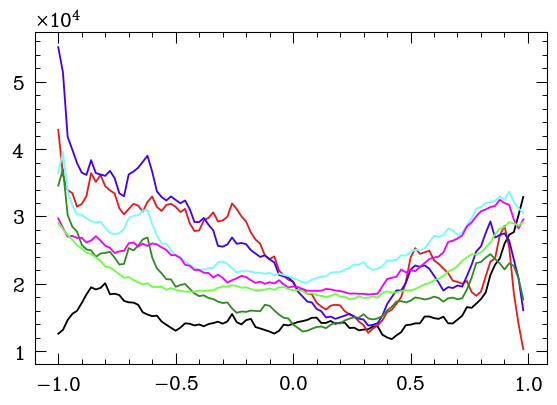

In [ ]:
for t in (-200, -60, -30, 0, 30, 60, 200):
    cnts, bins = np.histogram( costheta[inrange(times[:,None] - tacc_js, ((t - 30)/1e3, (t + 30)/1e3))], bins=100)
    plt.plot(bins[:-1], cnts)